# Check & Setup Environment

In [26]:
#import io, json, os, math, ray, time
import os, math, time, re

import tensorflow as tf
from tensorflow.keras.layers import Add, Concatenate, Lambda
from tensorflow.keras.layers import Input, Conv2D, ReLU, MaxPool2D
from tensorflow.keras.layers import UpSampling2D, ZeroPadding2D
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.layers import Conv2DTranspose

import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

PROJECT_PATH = os.getenv('HOME') + '/aiffel/mpii'
IMAGE_PATH = os.path.join(PROJECT_PATH, 'images')
MODEL_PATH = './models'
TFRECORD_PATH = os.path.join(PROJECT_PATH, 'tfrecords_mpii')
TRAIN_JSON = os.path.join(PROJECT_PATH, 'mpii_human_pose_v1_u12_2', 'train.json')
VALID_JSON = os.path.join(PROJECT_PATH, 'mpii_human_pose_v1_u12_2', 'validation.json')

In [3]:
R_ANKLE = 0
R_KNEE = 1
R_HIP = 2
L_HIP = 3
L_KNEE = 4
L_ANKLE = 5
PELVIS = 6
THORAX = 7
UPPER_NECK = 8
HEAD_TOP = 9
R_WRIST = 10
R_ELBOW = 11
R_SHOULDER = 12
L_SHOULDER = 13
L_ELBOW = 14
L_WRIST = 15

MPII_BONES = [
    [R_ANKLE, R_KNEE],
    [R_KNEE, R_HIP],
    [R_HIP, PELVIS],
    [L_HIP, PELVIS],
    [L_HIP, L_KNEE],
    [L_KNEE, L_ANKLE],
    [PELVIS, THORAX],
    [THORAX, UPPER_NECK],
    [UPPER_NECK, HEAD_TOP],
    [R_WRIST, R_ELBOW],
    [R_ELBOW, R_SHOULDER],
    [THORAX, R_SHOULDER],
    [THORAX, L_SHOULDER],
    [L_SHOULDER, L_ELBOW],
    [L_ELBOW, L_WRIST]
]

# 1. Data Data Pipeline
## 1.1 Define Parse function
Let's check one sampple of annotaions.  
**joints_vis** : 1(visible) / 0(non)  
**joints** : (0 - r ankle, 1 - r knee, 2 - r hip, 3 - l hip, 4 - l knee, 5 - l ankle, 6 - pelvis, 7 - thorax, 8 - upper neck, 9 - head top, 10 - r wrist, 11 - r elbow, 12 - r shoulder, 13 - l shoulder, 14 - l elbow, 15 - l wrist  
**scale** : Size of human  ( real size = scale * 200 )  
**center** : Center point of human

In [ ]:
with open(TRAIN_JSON) as train_json:
    train_annos = json.load(train_json)
    json_formatted_str = json.dumps(train_annos[0], indent=1)
    print(json_formatted_str)

In [ ]:
# Parsing one annotation from json files
# Return 'annotation' dictionary
def parse_one_annotation(anno, image_dir):
    filename = anno['image']
    joints = anno['joints']
    joints_visibility = anno['joints_vis']
    annotation = {
        'filename': filename,
        'filepath': os.path.join(image_dir, filename),
        'joints_visibility': joints_visibility,
        'joints': joints,
        'center': anno['center'],
        'scale' : anno['scale']
    }
    return annotation

In [ ]:
with open(TRAIN_JSON) as train_json:
    train_annos = json.load(train_json)
    test = parse_one_annotation(train_annos[0], IMAGE_PATH)
    print(test)

## 1.2 Configure TF Record for input data
NOTE URL : https://www.tensorflow.org/tutorials/load_data/tfrecord  


To deliver data for the next step before the current step has finished, it requires **an efficient input pipeline**.   
  
#### Why we have to set up an efficient input pipeline?  
기업에서 일하는 머신러닝 엔지니어 팀 입장에서 실험에 필요한 데이터들은 매우 크고 여러 경로에 담겨져 있다. 분산되어 있는 데이터들을 하나로 합치고 엔지니어가 원하는 크기로 나누어 담을 수 있다. 이를 통해 데이터를 논리적으로 그리고 효율적으로 저장할 수 있고 모델 학습시 효율적인 병렬 처리가 가능해진다.   

#### Case
이미지 데이터와 이미지에 대한 메타데이터 및 레이블은 별도의 파일에 저장 되어있는 경우를 생각해보자 -> 매 epoch 마다 서로 다른 경로에 가서 각 파일을 읽고 데이터를 구성하게 되면 연속적인 GPU 학습이 이루어지지 못하고 파일 읽기 쓰기를 하는데 시간을 쓰게 된다.( Bottleneck in reading data (I/O) ) -> **성능 저하**   
이러한 문제를 해결하기 위해 엔지니어는 **TF Record**를 통해 **an efficient input pipeline**을 구성해야한다.
  

#### What is the TF Record?
The TF Record format is a simple format for storing a sequence of binary records.  

#### What is  a sequence of binary records (데이터 직렬화)
데이터 직렬화란 데이터를 바이트 스트림으로 바꾸는 과정이다. 이를 통해 전송이나 저장에 이점을 얻을 수 있다.


**The rule of thumb of sharding the data**
- At least 10 times as many files as there will be hosts reading data.  
- Each file should be large enough (at least 10 MB+ and ideally 100 MB+)

In [5]:
def generate_tfexample(anno):

    # byte 인코딩을 위한 함수
    def _bytes_feature(value):
        if isinstance(value, type(tf.constant(0))):
            value = value.numpy()
        return tf.train.Feature(bytes_list=tf.train.BytesList(value=[value]))

    filename = anno['filename']
    filepath = anno['filepath']
    with open(filepath, 'rb') as image_file:
        content = image_file.read()

    image = Image.open(filepath)
    if image.format != 'JPEG' or image.mode != 'RGB':
        image_rgb = image.convert('RGB')
        with io.BytesIO() as output:
            image_rgb.save(output, format="JPEG", quality=95)
            content = output.getvalue()

    width, height = image.size
    depth = 3

    c_x = int(anno['center'][0])
    c_y = int(anno['center'][1])
    scale = anno['scale']

    x = [
        int(joint[0]) if joint[0] >= 0 else int(joint[0]) 
        for joint in anno['joints']
    ]
    y = [
        int(joint[1]) if joint[1] >= 0 else int(joint[0]) 
        for joint in anno['joints']
    ]

    v = [0 if joint_v == 0 else 2 for joint_v in anno['joints_visibility']]

    feature = {
        'image/height':
        tf.train.Feature(int64_list=tf.train.Int64List(value=[height])),
        'image/width':
        tf.train.Feature(int64_list=tf.train.Int64List(value=[width])),
        'image/depth':
        tf.train.Feature(int64_list=tf.train.Int64List(value=[depth])),
        'image/object/parts/x':
        tf.train.Feature(int64_list=tf.train.Int64List(value=x)),
        'image/object/parts/y':
        tf.train.Feature(int64_list=tf.train.Int64List(value=y)),
        'image/object/center/x': 
        tf.train.Feature(int64_list=tf.train.Int64List(value=[c_x])),
        'image/object/center/y': 
        tf.train.Feature(int64_list=tf.train.Int64List(value=[c_y])),
        'image/object/scale':
        tf.train.Feature(float_list=tf.train.FloatList(value=[scale])),
        'image/object/parts/v':
        tf.train.Feature(int64_list=tf.train.Int64List(value=v)),
        'image/encoded':
        _bytes_feature(content),
        'image/filename':
        _bytes_feature(filename.encode())
    }

    return tf.train.Example(features=tf.train.Features(feature=feature))

#### What is RAY?
It provides the compute layer for parallel processing. 
Much easier than multiprocessing package provided by python.  

#### How to use?
- First, define the function that you want to parallely execute and use decorater **@ray.remote**   
- Second, declare the function.  
- Third, call the function with ray.get().  
``` python
@ray.remote
def f(x):
    return x * x

 futures = [f.remote(i) for i in range(4)]  
   
 print(ray.get(futures)) # [0, 1, 4, 9]

Like the below image, 64 TF Rcords will be made parallely.  
![img1](./asset/image1.png)

In [7]:
def chunkify(l, n):
    size = len(l) // n
    start = 0
    results = []
    
    # Slicing the annotations based on chunks size
    for i in range(n):
        results.append(l[start:start + size])
        start += size
        
    return results

## The part that will be parallely execute
@ray.remote
def build_single_tfrecord(chunk, path):
    print('start to build tf records for ' + path)
    
    # One chunck contains 347 annotations in train data chunks
    # It means that it will iterate 347 times
    with tf.io.TFRecordWriter(path) as writer:
        for anno in chunk:
            # tf_example = generate_tfexample(anno) -> Generate tfexamaple
            tf_example = generate_tfexample(anno)
            
            # SerializeToString() -> Save it as a sequence of binary records at PATH
            writer.write(tf_example.SerializeToString())

    print('finished building tf records for ' + path)

    
def build_tf_records(annotations, total_shards, split):
    chunks = chunkify(annotations, total_shards)
    futures = [
        
        # Declare hat this part will ru this function remotely
        build_single_tfrecord.remote(
            chunk, '{}/{}_{}_of_{}.tfrecords'.format(
                TFRECORD_PATH,
                split,
                str(i + 1).zfill(4), # fill 4 zero like 0000,
                str(total_shards).zfill(4),
            )) for i, chunk in enumerate(chunks)
    ]
    
    # Calling build_single_tfrecord 
    ray.get(futures)

In [8]:
with open(TRAIN_JSON) as train_json:
    train_annos = json.load(train_json)
    train_annotations = [
        parse_one_annotation(anno, IMAGE_PATH)
        for anno in train_annos
    ]
    print(len(train_annotations))
with open(VALID_JSON) as val_json:
    val_annos = json.load(val_json)
    val_annotations = [
        parse_one_annotation(anno, IMAGE_PATH) 
        for anno in val_annos
    ]
    print(len(val_annotations))

22246
2958


In [9]:
print("Number of annos in one of the chunks in train:", 22246//64)
print("Number of annos in one of the chunks in val:", 2958//8)

Number of annos in one of the chunks in train: 347
Number of annos in one of the chunks in val: 369


In [10]:
num_train_shards = 64
num_val_shards = 8

ray.init()

print('Start to parse annotations.')
if not os.path.exists(TFRECORD_PATH):
    os.makedirs(TFRECORD_PATH)

with open(TRAIN_JSON) as train_json:
    train_annos = json.load(train_json)
    train_annotations = [
        parse_one_annotation(anno, IMAGE_PATH)
        for anno in train_annos
    ]
    print('First train annotation: ', train_annotations[0])

with open(VALID_JSON) as val_json:
    val_annos = json.load(val_json)
    val_annotations = [
        parse_one_annotation(anno, IMAGE_PATH) 
        for anno in val_annos
    ]
    print('First val annotation: ', val_annotations[0])
    
print('Start to build TF Records.')
build_tf_records(train_annotations, num_train_shards, 'train')
build_tf_records(val_annotations, num_val_shards, 'val')

print('Successfully wrote {} annotations to TF Records.'.format(
    len(train_annotations) + len(val_annotations)))

2023-12-05 09:10:08,250	WARNING services.py:1729 -- WARNING: The object store is using /tmp instead of /dev/shm because /dev/shm has only 67108864 bytes available. This will harm performance! You may be able to free up space by deleting files in /dev/shm. If you are inside a Docker container, you can increase /dev/shm size by passing '--shm-size=3.86gb' to 'docker run' (or add it to the run_options list in a Ray cluster config). Make sure to set this to more than 30% of available RAM.


Start to parse annotations.
First train annotation:  {'filename': '015601864.jpg', 'filepath': '/aiffel/aiffel/mpii/images/015601864.jpg', 'joints_visibility': [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 'joints': [[620.0, 394.0], [616.0, 269.0], [573.0, 185.0], [647.0, 188.0], [661.0, 221.0], [656.0, 231.0], [610.0, 187.0], [647.0, 176.0], [637.0201, 189.8183], [695.9799, 108.1817], [606.0, 217.0], [553.0, 161.0], [601.0, 167.0], [692.0, 185.0], [693.0, 240.0], [688.0, 313.0]], 'center': [594.0, 257.0], 'scale': 3.021046}
First val annotation:  {'filename': '005808361.jpg', 'filepath': '/aiffel/aiffel/mpii/images/005808361.jpg', 'joints_visibility': [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 'joints': [[804.0, 711.0], [816.0, 510.0], [908.0, 438.0], [1040.0, 454.0], [906.0, 528.0], [883.0, 707.0], [974.0, 446.0], [985.0, 253.0], [982.7591, 235.9694], [962.2409, 80.0306], [869.0, 214.0], [798.0, 340.0], [902.0, 253.0], [1067.0, 253.0], [1167.0, 353.0], [1142.0, 478.0]], 'c

(build_single_tfrecord pid=534) finished building tf records for /aiffel/aiffel/mpii/tfrecords_mpii/train_0026_of_0064.tfrecords
(build_single_tfrecord pid=534) start to build tf records for /aiffel/aiffel/mpii/tfrecords_mpii/train_0028_of_0064.tfrecords
(build_single_tfrecord pid=533) finished building tf records for /aiffel/aiffel/mpii/tfrecords_mpii/train_0025_of_0064.tfrecords
(build_single_tfrecord pid=533) start to build tf records for /aiffel/aiffel/mpii/tfrecords_mpii/train_0029_of_0064.tfrecords
(build_single_tfrecord pid=532) finished building tf records for /aiffel/aiffel/mpii/tfrecords_mpii/train_0027_of_0064.tfrecords
(build_single_tfrecord pid=532) start to build tf records for /aiffel/aiffel/mpii/tfrecords_mpii/train_0030_of_0064.tfrecords
(build_single_tfrecord pid=534) finished building tf records for /aiffel/aiffel/mpii/tfrecords_mpii/train_0028_of_0064.tfrecords
(build_single_tfrecord pid=534) 
(build_single_tfrecord pid=534) start to build tf records for /aiffel/aif

(build_single_tfrecord pid=533) finished building tf records for /aiffel/aiffel/mpii/tfrecords_mpii/train_0054_of_0064.tfrecords
(build_single_tfrecord pid=533) start to build tf records for /aiffel/aiffel/mpii/tfrecords_mpii/train_0057_of_0064.tfrecords
(build_single_tfrecord pid=534) finished building tf records for /aiffel/aiffel/mpii/tfrecords_mpii/train_0055_of_0064.tfrecords
(build_single_tfrecord pid=534) start to build tf records for /aiffel/aiffel/mpii/tfrecords_mpii/train_0058_of_0064.tfrecords
(build_single_tfrecord pid=532) finished building tf records for /aiffel/aiffel/mpii/tfrecords_mpii/train_0056_of_0064.tfrecords
(build_single_tfrecord pid=532) start to build tf records for /aiffel/aiffel/mpii/tfrecords_mpii/train_0059_of_0064.tfrecords
(build_single_tfrecord pid=533) finished building tf records for /aiffel/aiffel/mpii/tfrecords_mpii/train_0057_of_0064.tfrecords
(build_single_tfrecord pid=533) start to build tf records for /aiffel/aiffel/mpii/tfrecords_mpii/train_006

In [11]:
!ls /aiffel/aiffel/mpii/tfrecords_mpii/

train_0001_of_0064.tfrecords  train_0037_of_0064.tfrecords
train_0002_of_0064.tfrecords  train_0038_of_0064.tfrecords
train_0003_of_0064.tfrecords  train_0039_of_0064.tfrecords
train_0004_of_0064.tfrecords  train_0040_of_0064.tfrecords
train_0005_of_0064.tfrecords  train_0041_of_0064.tfrecords
train_0006_of_0064.tfrecords  train_0042_of_0064.tfrecords
train_0007_of_0064.tfrecords  train_0043_of_0064.tfrecords
train_0008_of_0064.tfrecords  train_0044_of_0064.tfrecords
train_0009_of_0064.tfrecords  train_0045_of_0064.tfrecords
train_0010_of_0064.tfrecords  train_0046_of_0064.tfrecords
train_0011_of_0064.tfrecords  train_0047_of_0064.tfrecords
train_0012_of_0064.tfrecords  train_0048_of_0064.tfrecords
train_0013_of_0064.tfrecords  train_0049_of_0064.tfrecords
train_0014_of_0064.tfrecords  train_0050_of_0064.tfrecords
train_0015_of_0064.tfrecords  train_0051_of_0064.tfrecords
train_0016_of_0064.tfrecords  train_0052_of_0064.tfrecords
train_0017_of_0064.tfrecords  train_0053_of_0064.tfrecor

In [ ]:
!ls -lh /aiffel/aiffel/mpii/tfrecords_mpii/train_0001_of_0064.tfrecords

-> ideally 100 MB+  

## 1.3 Parsing TF Record
To load and use TF Record as input data, you should configure parsing function on the pipeline.   
The function for parsing TF Record will be consisted two part.  
- For image  
- For label
  
#### Create Class to generate dataset for input
Class Name: Preprocessor   
Functions List: 
- parse_tfexample  
- crop_roi  
- generate_2d_guassian  
- make_heatmaps  

In [21]:
class Preprocessor(object):
    def __init__(self,
                 image_shape=(256, 256, 3),
                 heatmap_shape=(64, 64, 16),
                 is_train=False):
        self.is_train = is_train
        self.image_shape = image_shape
        self.heatmap_shape = heatmap_shape

    def __call__(self, example):
        # Parse TF Example
        features = self.parse_tfexample(example)
        # Seperate Image data as variable 'image'
        # Decode byte to jpeg format
        image = tf.io.decode_jpeg(features['image/encoded'])
        
        if self.is_train:
            random_margin = tf.random.uniform([1], 0.1, 0.3)[0]
            image, keypoint_x, keypoint_y = self.crop_roi(image, features, margin=random_margin)
            image = tf.image.resize(image, self.image_shape[0:2])
        else:
            image, keypoint_x, keypoint_y = self.crop_roi(image, features)
            image = tf.image.resize(image, self.image_shape[0:2])

        # Image normalization
        image = tf.cast(image, tf.float32) / 127.5 - 1
        
        # Create Label
        heatmaps = self.make_heatmaps(features, keypoint_x, keypoint_y, self.heatmap_shape)
        print(len(heatmaps))
        return image, heatmaps

    
    # Crop image to concentrate on human body
    # Return image keypoint_x, keypoint_y
    def crop_roi(self, image, features, margin=0.2):
        img_shape = tf.shape(image)
        img_height = img_shape[0]
        img_width = img_shape[1]
        img_depth = img_shape[2]
        
        
        keypoint_x = tf.cast(tf.sparse.to_dense(features['image/object/parts/x']), dtype=tf.int32)
        keypoint_y = tf.cast(tf.sparse.to_dense(features['image/object/parts/y']), dtype=tf.int32)
        center_x = features['image/object/center/x']
        center_y = features['image/object/center/y']
        body_height = features['image/object/scale'] * 200.0
        
        masked_keypoint_x = tf.boolean_mask(keypoint_x, keypoint_x > 0)
        masked_keypoint_y = tf.boolean_mask(keypoint_y, keypoint_y > 0)
        
        keypoint_xmin = tf.reduce_min(masked_keypoint_x)
        keypoint_xmax = tf.reduce_max(masked_keypoint_x)
        keypoint_ymin = tf.reduce_min(masked_keypoint_y)
        keypoint_ymax = tf.reduce_max(masked_keypoint_y)
        
        xmin = keypoint_xmin - tf.cast(body_height * margin, dtype=tf.int32)
        xmax = keypoint_xmax + tf.cast(body_height * margin, dtype=tf.int32)
        ymin = keypoint_ymin - tf.cast(body_height * margin, dtype=tf.int32)
        ymax = keypoint_ymax + tf.cast(body_height * margin, dtype=tf.int32)
        
        effective_xmin = xmin if xmin > 0 else 0
        effective_ymin = ymin if ymin > 0 else 0
        effective_xmax = xmax if xmax < img_width else img_width
        effective_ymax = ymax if ymax < img_height else img_height
        effective_height = effective_ymax - effective_ymin
        effective_width = effective_xmax - effective_xmin

        image = image[effective_ymin:effective_ymax, effective_xmin:effective_xmax, :]
        new_shape = tf.shape(image)
        new_height = new_shape[0]
        new_width = new_shape[1]
        
        effective_keypoint_x = (keypoint_x - effective_xmin) / new_width
        effective_keypoint_y = (keypoint_y - effective_ymin) / new_height
        
        return image, effective_keypoint_x, effective_keypoint_y
        
    
    def generate_2d_guassian(self, height, width, y0, x0, visibility=2, sigma=1, scale=12):
        
        heatmap = tf.zeros((height, width))

        xmin = x0 - 3 * sigma
        ymin = y0 - 3 * sigma
        xmax = x0 + 3 * sigma
        ymax = y0 + 3 * sigma

        if xmin >= width or ymin >= height or xmax < 0 or ymax <0 or visibility == 0:
            return heatmap

        size = 6 * sigma + 1
        x, y = tf.meshgrid(tf.range(0, 6*sigma+1, 1), tf.range(0, 6*sigma+1, 1), indexing='xy')

        center_x = size // 2
        center_y = size // 2

        gaussian_patch = tf.cast(tf.math.exp(-(tf.square(x - center_x) + tf.math.square(y - center_y)) / (tf.math.square(sigma) * 2)) * scale, dtype=tf.float32)

        patch_xmin = tf.math.maximum(0, -xmin)
        patch_ymin = tf.math.maximum(0, -ymin)
        patch_xmax = tf.math.minimum(xmax, width) - xmin
        patch_ymax = tf.math.minimum(ymax, height) - ymin

        heatmap_xmin = tf.math.maximum(0, xmin)
        heatmap_ymin = tf.math.maximum(0, ymin)
        heatmap_xmax = tf.math.minimum(xmax, width)
        heatmap_ymax = tf.math.minimum(ymax, height)

        indices = tf.TensorArray(tf.int32, 1, dynamic_size=True)
        updates = tf.TensorArray(tf.float32, 1, dynamic_size=True)

        count = 0

        for j in tf.range(patch_ymin, patch_ymax):
            for i in tf.range(patch_xmin, patch_xmax):
                indices = indices.write(count, [heatmap_ymin+j, heatmap_xmin+i])
                updates = updates.write(count, gaussian_patch[j][i])
                count += 1
                
        heatmap = tf.tensor_scatter_nd_update(heatmap, indices.stack(), updates.stack())

        return heatmap


    def make_heatmaps(self, features, keypoint_x, keypoint_y, heatmap_shape):
        v = tf.cast(tf.sparse.to_dense(features['image/object/parts/v']), dtype=tf.float32)
        x = tf.cast(tf.math.round(keypoint_x * heatmap_shape[0]), dtype=tf.int32)
        y = tf.cast(tf.math.round(keypoint_y * heatmap_shape[1]), dtype=tf.int32)
        
        num_heatmap = heatmap_shape[2]
        heatmap_array = tf.TensorArray(tf.float32, 16)

        for i in range(num_heatmap):
            gaussian = self.generate_2d_guassian(heatmap_shape[1], heatmap_shape[0], y[i], x[i], v[i])
            heatmap_array = heatmap_array.write(i, gaussian)
        
        heatmaps = heatmap_array.stack()
        heatmaps = tf.transpose(heatmaps, perm=[1, 2, 0]) # change to (64, 64, 16)
        
        return heatmaps

    # Parse TF Example
    # Create a dictionary mapping feature keys to Tensor
    def parse_tfexample(self, example):
        image_feature_description = {
            'image/height': tf.io.FixedLenFeature([], tf.int64),
            'image/width': tf.io.FixedLenFeature([], tf.int64),
            'image/depth': tf.io.FixedLenFeature([], tf.int64),
            'image/object/parts/x': tf.io.VarLenFeature(tf.int64),
            'image/object/parts/y': tf.io.VarLenFeature(tf.int64),
            'image/object/parts/v': tf.io.VarLenFeature(tf.int64),
            'image/object/center/x': tf.io.FixedLenFeature([], tf.int64),
            'image/object/center/y': tf.io.FixedLenFeature([], tf.int64),
            'image/object/scale': tf.io.FixedLenFeature([], tf.float32),
            'image/encoded': tf.io.FixedLenFeature([], tf.string),
            'image/filename': tf.io.FixedLenFeature([], tf.string),
        }
        return tf.io.parse_single_example(example,
                                          image_feature_description)

### Parallelizing in Preprocess
#### map( func, num_parallel_calls=tf.data.AUTOTUNE)
- Not using map paralling     
![img1](./asset/image2.png)  
- Using map paralling  
![img1](./asset/image3.png)   

### Prefetching
While the model is executing training steps, the input pipeline is reading the data for step s+1. Doing so reduces the step time to the maximum (as opposed to the sum) of the training and the time it takes to extract the data.  

In [22]:
IMAGE_SHAPE = (256, 256, 3)
HEATMAP_SIZE = (64, 64)

def create_dataset(tfrecords, batch_size, num_heatmap, is_train):
    preprocess = Preprocessor(
        IMAGE_SHAPE, (HEATMAP_SIZE[0], HEATMAP_SIZE[1], num_heatmap), is_train)
    
    # Load file list
    dataset = tf.data.Dataset.list_files(tfrecords)
    # Create dataset corresponding to file list
    dataset = tf.data.TFRecordDataset(dataset)
    
    # Note: image above this script
    dataset = dataset.map(
        preprocess, num_parallel_calls=tf.data.experimental.AUTOTUNE)

    if is_train:
        dataset = dataset.shuffle(batch_size)

    dataset = dataset.batch(batch_size)
    
    # Prefetch data
    dataset = dataset.prefetch(buffer_size=tf.data.experimental.AUTOTUNE)

    return dataset

In [55]:
ex_train_tfrecords_path = "/aiffel/aiffel/mpii/tfrecords_mpii/"
batch_size=16
strategy = tf.distribute.MirroredStrategy()
global_batch_size = strategy.num_replicas_in_sync * batch_size

train_dataset = create_dataset(
        ex_train_tfrecords_path, global_batch_size, num_heatmap=16, is_train=True)

INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
Tensor("strided_slice_4:0", shape=(None, None, None), dtype=uint8)
64


# 2. Model
## 2.1 Build Model
### 2.1.1 Stacked Hour Glass

In [6]:
def BottleneckBlock(inputs, filters, strides=1, downsample=False, name=None):
    identity = inputs
    if downsample:
        identity = Conv2D(
            filters=filters,
            kernel_size=1,
            strides=strides,
            padding='same',
            kernel_initializer='he_normal')(inputs)

    x = BatchNormalization(momentum=0.9)(inputs)
    x = ReLU()(x)
    x = Conv2D(
        filters=filters // 2,
        kernel_size=1,
        strides=1,
        padding='same',
        kernel_initializer='he_normal')(x)

    x = BatchNormalization(momentum=0.9)(x)
    x = ReLU()(x)
    x = Conv2D(
        filters=filters // 2,
        kernel_size=3,
        strides=strides,
        padding='same',
        kernel_initializer='he_normal')(x)

    x = BatchNormalization(momentum=0.9)(x)
    x = ReLU()(x)
    x = Conv2D(
        filters=filters * 2,
        kernel_size=1,
        strides=1,
        padding='same',
        kernel_initializer='he_normal')(x)

    x = Add()([identity, x])
    return x

In [7]:
def HourglassModule(inputs, order, filters, num_residual):
    
    up1 = BottleneckBlock(inputs, filters, downsample=False)
    for i in range(num_residual):
        up1 = BottleneckBlock(up1, filters, downsample=False)

    low1 = MaxPool2D(pool_size=2, strides=2)(inputs)
    for i in range(num_residual):
        low1 = BottleneckBlock(low1, filters, downsample=False)

    low2 = low1
    if order > 1:
        low2 = HourglassModule(low1, order - 1, filters, num_residual)
    else:
        for i in range(num_residual):
            low2 = BottleneckBlock(low2, filters, downsample=False)

    low3 = low2
    for i in range(num_residual):
        low3 = BottleneckBlock(low3, filters, downsample=False)

    up2 = UpSampling2D(size=2)(low3)

    return up2 + up1

In [8]:
def LinearLayer(inputs, filters):
    x = Conv2D(
        filters=filters,
        kernel_size=1,
        strides=1,
        padding='same',
        kernel_initializer='he_normal')(inputs)
    x = BatchNormalization(momentum=0.9)(x)
    x = ReLU()(x)
    return x

In [10]:
def StackedHourglassNetwork(
        input_shape=(256, 256, 3), 
        num_stack=4, 
        num_residual=1,
        num_heatmap=16):
    
    inputs = Input(shape=input_shape)

    x = Conv2D(
        filters=64,
        kernel_size=7,
        strides=2,
        padding='same',
        kernel_initializer='he_normal')(inputs)
    x = BatchNormalization(momentum=0.9)(x)
    x = ReLU()(x)
    x = BottleneckBlock(x, 128, downsample=True)
    x = MaxPool2D(pool_size=2, strides=2)(x)
    x = BottleneckBlock(x, 128, downsample=False)
    x = BottleneckBlock(x, 256, downsample=True)

    ys = []
    for i in range(num_stack):
        x = HourglassModule(x, order=4, filters=256, num_residual=num_residual)
        for i in range(num_residual):
            x = BottleneckBlock(x, 256, downsample=False)

        x = LinearLayer(x, 256)

        y = Conv2D(
            filters=num_heatmap,
            kernel_size=1,
            strides=1,
            padding='same',
            kernel_initializer='he_normal')(x)
        ys.append(y)

        if i < num_stack - 1:
            y_intermediate_1 = Conv2D(filters=256, kernel_size=1, strides=1)(x)
            y_intermediate_2 = Conv2D(filters=256, kernel_size=1, strides=1)(y)
            x = Add()([y_intermediate_1, y_intermediate_2])

    return tf.keras.Model(inputs, ys, name='stacked_hourglass')


In [11]:
model = StackedHourglassNetwork((256,256,3), 4, 1, 16)
model.summary()

Model: "stacked_hourglass"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 128, 128, 64) 9472        input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 128, 128, 64) 256         conv2d[0][0]                     
__________________________________________________________________________________________________
re_lu (ReLU)                    (None, 128, 128, 64) 0           batch_normalization[0][0]        
__________________________________________________________________________________

conv2d_227 (Conv2D)             (None, 4, 4, 256)    33024       re_lu_216[0][0]                  
__________________________________________________________________________________________________
re_lu_207 (ReLU)                (None, 8, 8, 128)    0           batch_normalization_207[0][0]    
__________________________________________________________________________________________________
conv2d_205 (Conv2D)             (None, 16, 16, 128)  147584      re_lu_194[0][0]                  
__________________________________________________________________________________________________
add_73 (Add)                    (None, 4, 4, 256)    0           add_72[0][0]                     
                                                                 conv2d_227[0][0]                 
__________________________________________________________________________________________________
conv2d_218 (Conv2D)             (None, 8, 8, 256)    33024       re_lu_207[0][0]                  
__________

### 2.1.2 SimpleBaseline

In [28]:
def DeconvolutionBlock(inputs):
    x = Conv2DTranspose(256, 
                        kernel_size=(4,4), 
                        strides=(2,2), 
                        padding='same')(inputs)
    x = BatchNormalization(momentum=0.9)(x)
    x = ReLU()(x)
    return x

In [4]:
def SimpleBaseline(
        input_shape=(256, 256, 3),
        num_heatmap=16):
    
    inputs = Input(shape=input_shape)
    x = inputs
     
    Resnet = tf.keras.applications.resnet.ResNet50(include_top=False, weights='imagenet')
    x = Resnet(inputs)
    for i in range(3):
        x = DeconvolutionBlock(x)
    
    outputs = Conv2D(num_heatmap, kernel_size=(1,1), padding='same')(x)
    
    return tf.keras.Model(inputs, outputs, name='simple_baseline')

In [15]:
sb_model = SimpleBaseline((256,256,3), num_heatmap=16)
sb_model.summary()

Model: "simple_baseline"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         [(None, 256, 256, 3)]     0         
_________________________________________________________________
resnet50 (Functional)        (None, None, None, 2048)  23587712  
_________________________________________________________________
conv2d_transpose (Conv2DTran (None, 16, 16, 256)       8388864   
_________________________________________________________________
batch_normalization_230 (Bat (None, 16, 16, 256)       1024      
_________________________________________________________________
re_lu_230 (ReLU)             (None, 16, 16, 256)       0         
_________________________________________________________________
conv2d_transpose_1 (Conv2DTr (None, 32, 32, 256)       1048832   
_________________________________________________________________
batch_normalization_231 (Bat (None, 32, 32, 256)   

### 2.1.3 HRNet 

In [76]:
def ExchangeBlock(x, filters, num_units=4):
    for _ in range(num_units):
        x = BottleneckBlock(x, 64)
    
    # Exchange unit across resolutions
    identity = layers.AveragePooling2D()(x)
    identity = layers.Conv2D(filters, 1)(identity)
    identity = layers.UpSampling2D()(identity)

    x = layers.Add()([x, identity])

In [102]:
def HRNet(
        input_shape=(256, 256, 3),
        num_heatmap=16):
    
    inputs = Input(shape=input_shape)
    x = Conv2D(filters=64,
               kernel_size=7,
               strides=2,
               padding='same',
               kernel_initializer='he_normal')(inputs)
    x = BatchNormalization(momentum=0.9)(x)
    x = ReLU()(x)
    
    stage_1 = []
    for i in range(4):
        x = BottleneckBlock(x, 128, downsample=True)
        stage_1.append(x)
        
    stage_1 = Conv2D(16, (1, 1), activation='relu')(x)
    
    
    
    
    outputs = Conv2D(num_heatmap, kernel_size=(1,1), padding='same')(stage_1)
    
    return tf.keras.Model(inputs, outputs, name='simple_baseline')

In [103]:
model = HRNet()
model.summary()

Model: "simple_baseline"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_77 (InputLayer)           [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
conv2d_4657 (Conv2D)            (None, 128, 128, 64) 9472        input_77[0][0]                   
__________________________________________________________________________________________________
batch_normalization_4367 (Batch (None, 128, 128, 64) 256         conv2d_4657[0][0]                
__________________________________________________________________________________________________
re_lu_4365 (ReLU)               (None, 128, 128, 64) 0           batch_normalization_4367[0][0]   
____________________________________________________________________________________

## 2.2 Train Model

In [15]:
class Trainer(object):
    def __init__(self,
                 model,
                 epochs,
                 global_batch_size,
                 strategy,
                 initial_learning_rate):
        self.model = model
        self.epochs = epochs
        self.strategy = strategy
        self.global_batch_size = global_batch_size
        self.loss_object = tf.keras.losses.MeanSquaredError(
            reduction=tf.keras.losses.Reduction.NONE)
        self.optimizer = tf.keras.optimizers.Adam(
            learning_rate=initial_learning_rate)
        self.model = model

        self.current_learning_rate = initial_learning_rate
        self.last_val_loss = math.inf
        self.lowest_val_loss = math.inf
        self.patience_count = 0
        self.max_patience = 10
        self.best_model = None

    def lr_decay(self):
        if self.patience_count >= self.max_patience:
            self.current_learning_rate /= 10.0
            self.patience_count = 0
        elif self.last_val_loss == self.lowest_val_loss:
            self.patience_count = 0
        self.patience_count += 1

        self.optimizer.learning_rate = self.current_learning_rate

    def lr_decay_step(self, epoch):
        if epoch == 25 or epoch == 50 or epoch == 75:
            self.current_learning_rate /= 10.0
        self.optimizer.learning_rate = self.current_learning_rate

    def compute_loss(self, labels, outputs):
        loss = 0
        for output in outputs:
            weights = tf.cast(labels > 0, dtype=tf.float32) * 81 + 1
            loss += tf.math.reduce_mean(
                tf.math.square(labels - output) * weights) * (
                    1. / self.global_batch_size)
        return loss

    def train_step(self, inputs):
        images, labels = inputs
        with tf.GradientTape() as tape:
            outputs = self.model(images, training=True)
            loss = self.compute_loss(labels, outputs)

        grads = tape.gradient(
            target=loss, sources=self.model.trainable_variables)
        self.optimizer.apply_gradients(
            zip(grads, self.model.trainable_variables))

        return loss

    def val_step(self, inputs):
        images, labels = inputs
        outputs = self.model(images, training=False)
        loss = self.compute_loss(labels, outputs)
        return loss

    def run(self, train_dist_dataset, val_dist_dataset):
        @tf.function
        def distributed_train_epoch(dataset):
            tf.print('Start distributed traininng...')
            total_loss = 0.0
            num_train_batches = 0.0
            for one_batch in dataset:
                per_replica_loss = self.strategy.run(
                    self.train_step, args=(one_batch, ))
                batch_loss = self.strategy.reduce(
                    tf.distribute.ReduceOp.SUM, per_replica_loss, axis=None)
                total_loss += batch_loss
                num_train_batches += 1
                tf.print('Trained batch', num_train_batches, 'batch loss',
                         batch_loss, 'epoch total loss', total_loss / num_train_batches)
            return total_loss, num_train_batches

        @tf.function
        def distributed_val_epoch(dataset):
            total_loss = 0.0
            num_val_batches = 0.0
            for one_batch in dataset:
                per_replica_loss = self.strategy.run(
                    self.val_step, args=(one_batch, ))
                num_val_batches += 1
                batch_loss = self.strategy.reduce(
                    tf.distribute.ReduceOp.SUM, per_replica_loss, axis=None)
                tf.print('Validated batch', num_val_batches, 'batch loss',
                         batch_loss)
                if not tf.math.is_nan(batch_loss):
                    # TODO: Find out why the last validation batch loss become NaN
                    total_loss += batch_loss
                else:
                    num_val_batches -= 1

            return total_loss, num_val_batches

        for epoch in range(1, self.epochs + 1):
            self.lr_decay()
            start = time.time()
            print('Start epoch {} with learning rate {}'.format(
                epoch, self.current_learning_rate))

            train_total_loss, num_train_batches = distributed_train_epoch(
                train_dist_dataset)
            
            load_t1 = time.time()
            train_loss = train_total_loss / num_train_batches
            print('Epoch {} | time {} train loss {}'.format(epoch, load_t1-start, train_loss))

            load_t2 = time.time()
            val_total_loss, num_val_batches = distributed_val_epoch(
                val_dist_dataset)
            load_t3 = time.time()
            val_loss = val_total_loss / num_val_batches
            print('Epoch {} | time {} val loss {}'.format(epoch, load_t3-load_t2, val_loss))

            # save model when reach a new lowest validation loss
            if val_loss < self.lowest_val_loss:
                self.save_model(epoch, val_loss)
                self.lowest_val_loss = val_loss
            self.last_val_loss = val_loss

        return self.best_model

    def save_model(self, epoch, loss):
        model_name = MODEL_PATH + '/model-epoch-{}-loss-{:.4f}.h5'.format(epoch, loss)
        self.model.save_weights(model_name)
        self.best_model = model_name
        print("Model {} saved.".format(model_name))

In [16]:
def train(epochs, learning_rate, num_heatmap, batch_size, train_tfrecords, val_tfrecords):
    strategy = tf.distribute.MirroredStrategy()
    global_batch_size = strategy.num_replicas_in_sync * batch_size
    train_dataset = create_dataset(
        train_tfrecords, global_batch_size, num_heatmap, is_train=True)
    val_dataset = create_dataset(
        val_tfrecords, global_batch_size, num_heatmap, is_train=False)

    if not os.path.exists(MODEL_PATH):
        os.makedirs(MODEL_PATH)

    with strategy.scope():
        train_dist_dataset = strategy.experimental_distribute_dataset(
            train_dataset)
        val_dist_dataset = strategy.experimental_distribute_dataset(
            val_dataset)

        model = StackedHourglassNetwork(IMAGE_SHAPE, 4, 1, num_heatmap)

        trainer = Trainer(
            model,
            epochs,
            global_batch_size,
            strategy,
            initial_learning_rate=learning_rate)

        print('Start training...')
        return trainer.run(train_dist_dataset, val_dist_dataset)

In [19]:
train_tfrecords = os.path.join(TFRECORD_PATH, 'train*')
val_tfrecords = os.path.join(TFRECORD_PATH, 'val*')
epochs = 10
batch_size = 16
num_heatmap = 16
learning_rate = 0.0007

best_model_file = train(epochs, learning_rate, num_heatmap, batch_size, train_tfrecords, val_tfrecords)

INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
64
64
Start training...
Start epoch 1 with learning rate 0.0007


/opt/conda/lib/python3.9/site-packages/tensorflow/python/data/ops/dataset_ops.py:374: UserWarning: To make it possible to preserve tf.data options across serialization boundaries, their implementation has moved to be part of the TensorFlow graph. As a consequence, the options value is in general no longer known at graph construction time. Invoking this method in graph mode retains the legacy behavior of the original implementation, but note that the returned value might not reflect the actual value of the options.
  warnings.warn("To make it possible to preserve tf.data options across "


Start distributed traininng...
Trained batch 1 batch loss 2.72068334 epoch total loss 2.72068334
Trained batch 2 batch loss 2.6233058 epoch total loss 2.67199469
Trained batch 3 batch loss 2.51180935 epoch total loss 2.61859965
Trained batch 4 batch loss 2.43516159 epoch total loss 2.57274
Trained batch 5 batch loss 2.4560864 epoch total loss 2.54940939
Trained batch 6 batch loss 2.36140156 epoch total loss 2.51807475
Trained batch 7 batch loss 2.16360402 epoch total loss 2.46743608
Trained batch 8 batch loss 2.06656075 epoch total loss 2.41732669
Trained batch 9 batch loss 1.96235716 epoch total loss 2.36677456
Trained batch 10 batch loss 1.95936334 epoch total loss 2.32603335
Trained batch 11 batch loss 1.90687561 epoch total loss 2.2879281
Trained batch 12 batch loss 1.90907359 epoch total loss 2.25635695
Trained batch 13 batch loss 1.70871758 epoch total loss 2.21423078
Trained batch 14 batch loss 1.60959756 epoch total loss 2.17104268
Trained batch 15 batch loss 1.76139963 epoch t

Trained batch 124 batch loss 1.76057696 epoch total loss 1.79260099
Trained batch 125 batch loss 1.74935114 epoch total loss 1.79225492
Trained batch 126 batch loss 1.66119945 epoch total loss 1.7912147
Trained batch 127 batch loss 1.66400456 epoch total loss 1.79021299
Trained batch 128 batch loss 1.66078305 epoch total loss 1.78920186
Trained batch 129 batch loss 1.59880853 epoch total loss 1.78772604
Trained batch 130 batch loss 1.57603216 epoch total loss 1.78609765
Trained batch 131 batch loss 1.6792711 epoch total loss 1.78528214
Trained batch 132 batch loss 1.63989091 epoch total loss 1.78418076
Trained batch 133 batch loss 1.61120057 epoch total loss 1.78288019
Trained batch 134 batch loss 1.68098712 epoch total loss 1.78211975
Trained batch 135 batch loss 1.54783916 epoch total loss 1.7803843
Trained batch 136 batch loss 1.58628142 epoch total loss 1.77895713
Trained batch 137 batch loss 1.71278501 epoch total loss 1.77847409
Trained batch 138 batch loss 1.56302977 epoch total

Trained batch 245 batch loss 1.70662308 epoch total loss 1.72299898
Trained batch 246 batch loss 1.62105954 epoch total loss 1.72258461
Trained batch 247 batch loss 1.62855673 epoch total loss 1.72220397
Trained batch 248 batch loss 1.70381641 epoch total loss 1.72212982
Trained batch 249 batch loss 1.64724636 epoch total loss 1.72182906
Trained batch 250 batch loss 1.66305339 epoch total loss 1.72159398
Trained batch 251 batch loss 1.64167356 epoch total loss 1.72127557
Trained batch 252 batch loss 1.68105412 epoch total loss 1.72111595
Trained batch 253 batch loss 1.681651 epoch total loss 1.7209599
Trained batch 254 batch loss 1.66801834 epoch total loss 1.72075152
Trained batch 255 batch loss 1.65817463 epoch total loss 1.72050619
Trained batch 256 batch loss 1.6258508 epoch total loss 1.7201364
Trained batch 257 batch loss 1.64777517 epoch total loss 1.71985483
Trained batch 258 batch loss 1.61057079 epoch total loss 1.71943116
Trained batch 259 batch loss 1.69095147 epoch total l

Trained batch 366 batch loss 1.57655787 epoch total loss 1.68476641
Trained batch 367 batch loss 1.61695242 epoch total loss 1.68458164
Trained batch 368 batch loss 1.56332874 epoch total loss 1.68425214
Trained batch 369 batch loss 1.49810278 epoch total loss 1.68374777
Trained batch 370 batch loss 1.49128103 epoch total loss 1.68322754
Trained batch 371 batch loss 1.5820049 epoch total loss 1.68295479
Trained batch 372 batch loss 1.62508166 epoch total loss 1.6827991
Trained batch 373 batch loss 1.57675016 epoch total loss 1.68251479
Trained batch 374 batch loss 1.54644203 epoch total loss 1.68215096
Trained batch 375 batch loss 1.56312048 epoch total loss 1.68183351
Trained batch 376 batch loss 1.64142144 epoch total loss 1.68172598
Trained batch 377 batch loss 1.64779055 epoch total loss 1.68163598
Trained batch 378 batch loss 1.65703523 epoch total loss 1.68157089
Trained batch 379 batch loss 1.59782445 epoch total loss 1.68135
Trained batch 380 batch loss 1.63116682 epoch total l

Trained batch 487 batch loss 1.50763059 epoch total loss 1.65489244
Trained batch 488 batch loss 1.50839722 epoch total loss 1.65459228
Trained batch 489 batch loss 1.58238149 epoch total loss 1.65444469
Trained batch 490 batch loss 1.58203244 epoch total loss 1.65429688
Trained batch 491 batch loss 1.61108899 epoch total loss 1.6542089
Trained batch 492 batch loss 1.3911171 epoch total loss 1.65367413
Trained batch 493 batch loss 1.23060465 epoch total loss 1.65281594
Trained batch 494 batch loss 1.30273235 epoch total loss 1.65210724
Trained batch 495 batch loss 1.39062655 epoch total loss 1.65157902
Trained batch 496 batch loss 1.69664192 epoch total loss 1.65166986
Trained batch 497 batch loss 1.69762182 epoch total loss 1.65176237
Trained batch 498 batch loss 1.71104431 epoch total loss 1.65188146
Trained batch 499 batch loss 1.69753313 epoch total loss 1.65197289
Trained batch 500 batch loss 1.6833632 epoch total loss 1.65203559
Trained batch 501 batch loss 1.63263583 epoch total

Trained batch 608 batch loss 1.55903566 epoch total loss 1.63446319
Trained batch 609 batch loss 1.54432106 epoch total loss 1.63431513
Trained batch 610 batch loss 1.61829805 epoch total loss 1.63428891
Trained batch 611 batch loss 1.64679432 epoch total loss 1.63430929
Trained batch 612 batch loss 1.54904962 epoch total loss 1.63417
Trained batch 613 batch loss 1.56469059 epoch total loss 1.63405669
Trained batch 614 batch loss 1.54014552 epoch total loss 1.63390374
Trained batch 615 batch loss 1.4774313 epoch total loss 1.63364935
Trained batch 616 batch loss 1.54008746 epoch total loss 1.63349748
Trained batch 617 batch loss 1.54411721 epoch total loss 1.63335264
Trained batch 618 batch loss 1.60951138 epoch total loss 1.63331401
Trained batch 619 batch loss 1.67019582 epoch total loss 1.6333735
Trained batch 620 batch loss 1.66141069 epoch total loss 1.6334188
Trained batch 621 batch loss 1.60597205 epoch total loss 1.63337457
Trained batch 622 batch loss 1.63396513 epoch total lo

Trained batch 729 batch loss 1.4182601 epoch total loss 1.61906958
Trained batch 730 batch loss 1.6001811 epoch total loss 1.61904383
Trained batch 731 batch loss 1.54137313 epoch total loss 1.61893761
Trained batch 732 batch loss 1.46346307 epoch total loss 1.61872518
Trained batch 733 batch loss 1.52779067 epoch total loss 1.6186012
Trained batch 734 batch loss 1.51774013 epoch total loss 1.61846375
Trained batch 735 batch loss 1.61558354 epoch total loss 1.61845982
Trained batch 736 batch loss 1.5975461 epoch total loss 1.61843145
Trained batch 737 batch loss 1.51469755 epoch total loss 1.61829066
Trained batch 738 batch loss 1.56108665 epoch total loss 1.61821306
Trained batch 739 batch loss 1.4028126 epoch total loss 1.61792159
Trained batch 740 batch loss 1.51944852 epoch total loss 1.61778843
Trained batch 741 batch loss 1.51311636 epoch total loss 1.61764717
Trained batch 742 batch loss 1.42861378 epoch total loss 1.6173923
Trained batch 743 batch loss 1.49320614 epoch total lo

Trained batch 851 batch loss 1.42228818 epoch total loss 1.60420597
Trained batch 852 batch loss 1.55597818 epoch total loss 1.60414946
Trained batch 853 batch loss 1.44265747 epoch total loss 1.60396016
Trained batch 854 batch loss 1.5026195 epoch total loss 1.60384142
Trained batch 855 batch loss 1.48123872 epoch total loss 1.6036979
Trained batch 856 batch loss 1.48427117 epoch total loss 1.60355842
Trained batch 857 batch loss 1.42707717 epoch total loss 1.60335255
Trained batch 858 batch loss 1.46877313 epoch total loss 1.60319567
Trained batch 859 batch loss 1.46263623 epoch total loss 1.60303199
Trained batch 860 batch loss 1.47492576 epoch total loss 1.6028831
Trained batch 861 batch loss 1.59048176 epoch total loss 1.60286868
Trained batch 862 batch loss 1.60667062 epoch total loss 1.60287309
Trained batch 863 batch loss 1.58382714 epoch total loss 1.60285115
Trained batch 864 batch loss 1.53502131 epoch total loss 1.60277259
Trained batch 865 batch loss 1.54894733 epoch total

Trained batch 972 batch loss 1.43717194 epoch total loss 1.59216905
Trained batch 973 batch loss 1.45359302 epoch total loss 1.59202659
Trained batch 974 batch loss 1.46114922 epoch total loss 1.59189224
Trained batch 975 batch loss 1.44406521 epoch total loss 1.59174061
Trained batch 976 batch loss 1.41181 epoch total loss 1.59155631
Trained batch 977 batch loss 1.44357848 epoch total loss 1.59140491
Trained batch 978 batch loss 1.48941946 epoch total loss 1.59130061
Trained batch 979 batch loss 1.4644022 epoch total loss 1.59117091
Trained batch 980 batch loss 1.51799035 epoch total loss 1.59109616
Trained batch 981 batch loss 1.48776579 epoch total loss 1.5909909
Trained batch 982 batch loss 1.40173149 epoch total loss 1.59079814
Trained batch 983 batch loss 1.47812104 epoch total loss 1.59068358
Trained batch 984 batch loss 1.45385933 epoch total loss 1.59054458
Trained batch 985 batch loss 1.36348343 epoch total loss 1.59031403
Trained batch 986 batch loss 1.41210651 epoch total l

Trained batch 1092 batch loss 1.41036987 epoch total loss 1.57875216
Trained batch 1093 batch loss 1.53886771 epoch total loss 1.57871556
Trained batch 1094 batch loss 1.57793987 epoch total loss 1.57871485
Trained batch 1095 batch loss 1.60009444 epoch total loss 1.5787344
Trained batch 1096 batch loss 1.47510171 epoch total loss 1.57863975
Trained batch 1097 batch loss 1.52343237 epoch total loss 1.57858944
Trained batch 1098 batch loss 1.36594248 epoch total loss 1.57839584
Trained batch 1099 batch loss 1.48602617 epoch total loss 1.5783118
Trained batch 1100 batch loss 1.47859347 epoch total loss 1.5782212
Trained batch 1101 batch loss 1.40171468 epoch total loss 1.57806087
Trained batch 1102 batch loss 1.46644306 epoch total loss 1.57795966
Trained batch 1103 batch loss 1.45088089 epoch total loss 1.5778445
Trained batch 1104 batch loss 1.49076355 epoch total loss 1.57776558
Trained batch 1105 batch loss 1.43500149 epoch total loss 1.57763636
Trained batch 1106 batch loss 1.491113

Trained batch 1212 batch loss 1.49866688 epoch total loss 1.56658745
Trained batch 1213 batch loss 1.51028466 epoch total loss 1.56654096
Trained batch 1214 batch loss 1.51029575 epoch total loss 1.56649458
Trained batch 1215 batch loss 1.46102047 epoch total loss 1.5664078
Trained batch 1216 batch loss 1.45978129 epoch total loss 1.56632018
Trained batch 1217 batch loss 1.43788421 epoch total loss 1.56621468
Trained batch 1218 batch loss 1.44532847 epoch total loss 1.56611538
Trained batch 1219 batch loss 1.42028415 epoch total loss 1.56599581
Trained batch 1220 batch loss 1.42534137 epoch total loss 1.56588042
Trained batch 1221 batch loss 1.44733453 epoch total loss 1.56578338
Trained batch 1222 batch loss 1.53505015 epoch total loss 1.56575823
Trained batch 1223 batch loss 1.490026 epoch total loss 1.56569624
Trained batch 1224 batch loss 1.46517754 epoch total loss 1.56561422
Trained batch 1225 batch loss 1.56265938 epoch total loss 1.56561172
Trained batch 1226 batch loss 1.47178

Trained batch 1332 batch loss 1.47327876 epoch total loss 1.55682242
Trained batch 1333 batch loss 1.60062575 epoch total loss 1.55685532
Trained batch 1334 batch loss 1.45789313 epoch total loss 1.55678117
Trained batch 1335 batch loss 1.55023992 epoch total loss 1.55677629
Trained batch 1336 batch loss 1.49689817 epoch total loss 1.55673146
Trained batch 1337 batch loss 1.44391942 epoch total loss 1.55664706
Trained batch 1338 batch loss 1.4324671 epoch total loss 1.55655408
Trained batch 1339 batch loss 1.53963733 epoch total loss 1.55654144
Trained batch 1340 batch loss 1.53577709 epoch total loss 1.55652606
Trained batch 1341 batch loss 1.50175321 epoch total loss 1.55648518
Trained batch 1342 batch loss 1.44610858 epoch total loss 1.5564028
Trained batch 1343 batch loss 1.37158978 epoch total loss 1.55626523
Trained batch 1344 batch loss 1.42048347 epoch total loss 1.55616415
Trained batch 1345 batch loss 1.46038842 epoch total loss 1.55609298
Trained batch 1346 batch loss 1.4777

Validated batch 105 batch loss 1.25037336
Validated batch 106 batch loss 1.42247462
Validated batch 107 batch loss 1.41719913
Validated batch 108 batch loss 1.42343497
Validated batch 109 batch loss 1.43154228
Validated batch 110 batch loss 1.38154006
Validated batch 111 batch loss 1.45302868
Validated batch 112 batch loss 1.48518753
Validated batch 113 batch loss 1.42707288
Validated batch 114 batch loss 1.42987514
Validated batch 115 batch loss 1.3173871
Validated batch 116 batch loss 1.48726737
Validated batch 117 batch loss 1.40384781
Validated batch 118 batch loss 1.41974795
Validated batch 119 batch loss 1.41065645
Validated batch 120 batch loss 1.3728534
Validated batch 121 batch loss 1.46534705
Validated batch 122 batch loss 1.4129765
Validated batch 123 batch loss 1.36346948
Validated batch 124 batch loss 1.37536645
Validated batch 125 batch loss 1.39688921
Validated batch 126 batch loss 1.43821096
Validated batch 127 batch loss 1.43562663
Validated batch 128 batch loss 1.4035

Trained batch 71 batch loss 1.39097834 epoch total loss 1.45376
Trained batch 72 batch loss 1.3181392 epoch total loss 1.4518764
Trained batch 73 batch loss 1.45145428 epoch total loss 1.45187068
Trained batch 74 batch loss 1.45792699 epoch total loss 1.45195246
Trained batch 75 batch loss 1.52281702 epoch total loss 1.45289731
Trained batch 76 batch loss 1.54302049 epoch total loss 1.4540832
Trained batch 77 batch loss 1.28749955 epoch total loss 1.45191979
Trained batch 78 batch loss 1.36526501 epoch total loss 1.45080876
Trained batch 79 batch loss 1.3717885 epoch total loss 1.44980848
Trained batch 80 batch loss 1.5363574 epoch total loss 1.4508903
Trained batch 81 batch loss 1.38744843 epoch total loss 1.4501071
Trained batch 82 batch loss 1.50408065 epoch total loss 1.45076537
Trained batch 83 batch loss 1.52782428 epoch total loss 1.45169377
Trained batch 84 batch loss 1.52519703 epoch total loss 1.45256889
Trained batch 85 batch loss 1.46094429 epoch total loss 1.45266747
Train

Trained batch 193 batch loss 1.41929674 epoch total loss 1.43168581
Trained batch 194 batch loss 1.35887408 epoch total loss 1.43131065
Trained batch 195 batch loss 1.40233135 epoch total loss 1.431162
Trained batch 196 batch loss 1.50030732 epoch total loss 1.43151486
Trained batch 197 batch loss 1.4175837 epoch total loss 1.43144405
Trained batch 198 batch loss 1.36349273 epoch total loss 1.43110085
Trained batch 199 batch loss 1.30566394 epoch total loss 1.43047059
Trained batch 200 batch loss 1.30499 epoch total loss 1.42984319
Trained batch 201 batch loss 1.36736619 epoch total loss 1.42953229
Trained batch 202 batch loss 1.40477467 epoch total loss 1.42940986
Trained batch 203 batch loss 1.36089349 epoch total loss 1.42907238
Trained batch 204 batch loss 1.31286037 epoch total loss 1.42850268
Trained batch 205 batch loss 1.43729973 epoch total loss 1.42854559
Trained batch 206 batch loss 1.41887307 epoch total loss 1.42849863
Trained batch 207 batch loss 1.46341312 epoch total lo

Trained batch 315 batch loss 1.31296825 epoch total loss 1.4228791
Trained batch 316 batch loss 1.33863759 epoch total loss 1.42261243
Trained batch 317 batch loss 1.43174267 epoch total loss 1.42264116
Trained batch 318 batch loss 1.34936786 epoch total loss 1.42241073
Trained batch 319 batch loss 1.52521968 epoch total loss 1.42273307
Trained batch 320 batch loss 1.4195044 epoch total loss 1.42272294
Trained batch 321 batch loss 1.3962208 epoch total loss 1.42264032
Trained batch 322 batch loss 1.22635365 epoch total loss 1.42203069
Trained batch 323 batch loss 1.25861931 epoch total loss 1.42152476
Trained batch 324 batch loss 1.26261032 epoch total loss 1.42103422
Trained batch 325 batch loss 1.30634844 epoch total loss 1.42068136
Trained batch 326 batch loss 1.3291955 epoch total loss 1.42040074
Trained batch 327 batch loss 1.31469297 epoch total loss 1.42007744
Trained batch 328 batch loss 1.28556037 epoch total loss 1.41966736
Trained batch 329 batch loss 1.39890838 epoch total 

Trained batch 437 batch loss 1.55599785 epoch total loss 1.41896498
Trained batch 438 batch loss 1.47883177 epoch total loss 1.41910172
Trained batch 439 batch loss 1.4521234 epoch total loss 1.41917694
Trained batch 440 batch loss 1.44237161 epoch total loss 1.41922963
Trained batch 441 batch loss 1.41772556 epoch total loss 1.41922629
Trained batch 442 batch loss 1.44322383 epoch total loss 1.41928065
Trained batch 443 batch loss 1.37334311 epoch total loss 1.41917694
Trained batch 444 batch loss 1.52955937 epoch total loss 1.41942549
Trained batch 445 batch loss 1.54919231 epoch total loss 1.41971707
Trained batch 446 batch loss 1.4601295 epoch total loss 1.41980779
Trained batch 447 batch loss 1.40494442 epoch total loss 1.41977453
Trained batch 448 batch loss 1.48402834 epoch total loss 1.41991794
Trained batch 449 batch loss 1.4089824 epoch total loss 1.41989362
Trained batch 450 batch loss 1.54833734 epoch total loss 1.42017901
Trained batch 451 batch loss 1.46727514 epoch total

Trained batch 559 batch loss 1.59254706 epoch total loss 1.41820562
Trained batch 560 batch loss 1.53141057 epoch total loss 1.4184078
Trained batch 561 batch loss 1.4822557 epoch total loss 1.41852152
Trained batch 562 batch loss 1.44489896 epoch total loss 1.41856849
Trained batch 563 batch loss 1.47384477 epoch total loss 1.4186666
Trained batch 564 batch loss 1.45118356 epoch total loss 1.41872418
Trained batch 565 batch loss 1.42283952 epoch total loss 1.41873157
Trained batch 566 batch loss 1.34916663 epoch total loss 1.41860867
Trained batch 567 batch loss 1.37151456 epoch total loss 1.41852558
Trained batch 568 batch loss 1.4058249 epoch total loss 1.41850328
Trained batch 569 batch loss 1.4001435 epoch total loss 1.41847098
Trained batch 570 batch loss 1.39974439 epoch total loss 1.41843808
Trained batch 571 batch loss 1.29731154 epoch total loss 1.41822588
Trained batch 572 batch loss 1.33336759 epoch total loss 1.41807759
Trained batch 573 batch loss 1.16620851 epoch total l

Trained batch 681 batch loss 1.39312088 epoch total loss 1.41057742
Trained batch 682 batch loss 1.44500875 epoch total loss 1.41062784
Trained batch 683 batch loss 1.50312495 epoch total loss 1.41076326
Trained batch 684 batch loss 1.36825871 epoch total loss 1.41070116
Trained batch 685 batch loss 1.39453101 epoch total loss 1.41067755
Trained batch 686 batch loss 1.3282156 epoch total loss 1.41055739
Trained batch 687 batch loss 1.24131012 epoch total loss 1.41031098
Trained batch 688 batch loss 1.26728892 epoch total loss 1.41010308
Trained batch 689 batch loss 1.36541426 epoch total loss 1.41003823
Trained batch 690 batch loss 1.46238947 epoch total loss 1.41011417
Trained batch 691 batch loss 1.42724812 epoch total loss 1.41013896
Trained batch 692 batch loss 1.530743 epoch total loss 1.41031325
Trained batch 693 batch loss 1.47344565 epoch total loss 1.41040432
Trained batch 694 batch loss 1.36828375 epoch total loss 1.41034365
Trained batch 695 batch loss 1.52324116 epoch total

Trained batch 803 batch loss 1.51042414 epoch total loss 1.40327013
Trained batch 804 batch loss 1.36120808 epoch total loss 1.40321779
Trained batch 805 batch loss 1.33037591 epoch total loss 1.40312731
Trained batch 806 batch loss 1.45183229 epoch total loss 1.40318763
Trained batch 807 batch loss 1.26516831 epoch total loss 1.40301657
Trained batch 808 batch loss 1.33026695 epoch total loss 1.40292656
Trained batch 809 batch loss 1.36183619 epoch total loss 1.40287578
Trained batch 810 batch loss 1.36033845 epoch total loss 1.40282333
Trained batch 811 batch loss 1.29044008 epoch total loss 1.40268469
Trained batch 812 batch loss 1.25981665 epoch total loss 1.40250862
Trained batch 813 batch loss 1.25615871 epoch total loss 1.40232861
Trained batch 814 batch loss 1.32864666 epoch total loss 1.40223801
Trained batch 815 batch loss 1.34301221 epoch total loss 1.40216541
Trained batch 816 batch loss 1.30043268 epoch total loss 1.40204072
Trained batch 817 batch loss 1.23309374 epoch to

Trained batch 924 batch loss 1.30180931 epoch total loss 1.39670944
Trained batch 925 batch loss 1.33043349 epoch total loss 1.3966378
Trained batch 926 batch loss 1.28531969 epoch total loss 1.39651763
Trained batch 927 batch loss 1.41862512 epoch total loss 1.39654136
Trained batch 928 batch loss 1.31509614 epoch total loss 1.39645362
Trained batch 929 batch loss 1.4179678 epoch total loss 1.39647675
Trained batch 930 batch loss 1.31015885 epoch total loss 1.396384
Trained batch 931 batch loss 1.30788493 epoch total loss 1.39628887
Trained batch 932 batch loss 1.23778057 epoch total loss 1.39611876
Trained batch 933 batch loss 1.19318795 epoch total loss 1.39590132
Trained batch 934 batch loss 1.38764954 epoch total loss 1.39589262
Trained batch 935 batch loss 1.51454425 epoch total loss 1.39601946
Trained batch 936 batch loss 1.3728354 epoch total loss 1.39599466
Trained batch 937 batch loss 1.41157079 epoch total loss 1.39601135
Trained batch 938 batch loss 1.38387835 epoch total l

Trained batch 1045 batch loss 1.39751756 epoch total loss 1.39239848
Trained batch 1046 batch loss 1.35643256 epoch total loss 1.39236414
Trained batch 1047 batch loss 1.22884893 epoch total loss 1.39220798
Trained batch 1048 batch loss 1.21685 epoch total loss 1.39204061
Trained batch 1049 batch loss 1.20563698 epoch total loss 1.39186287
Trained batch 1050 batch loss 1.31549072 epoch total loss 1.39179015
Trained batch 1051 batch loss 1.38177514 epoch total loss 1.39178061
Trained batch 1052 batch loss 1.36059976 epoch total loss 1.39175105
Trained batch 1053 batch loss 1.35601449 epoch total loss 1.39171708
Trained batch 1054 batch loss 1.20491767 epoch total loss 1.39153981
Trained batch 1055 batch loss 1.26983762 epoch total loss 1.39142454
Trained batch 1056 batch loss 1.41811037 epoch total loss 1.39144981
Trained batch 1057 batch loss 1.37793708 epoch total loss 1.39143693
Trained batch 1058 batch loss 1.42210102 epoch total loss 1.39146602
Trained batch 1059 batch loss 1.29305

Trained batch 1165 batch loss 1.57687974 epoch total loss 1.3872987
Trained batch 1166 batch loss 1.35605896 epoch total loss 1.38727188
Trained batch 1167 batch loss 1.23977304 epoch total loss 1.38714552
Trained batch 1168 batch loss 1.37716389 epoch total loss 1.38713706
Trained batch 1169 batch loss 1.56560588 epoch total loss 1.38728964
Trained batch 1170 batch loss 1.45528591 epoch total loss 1.38734782
Trained batch 1171 batch loss 1.47905552 epoch total loss 1.38742602
Trained batch 1172 batch loss 1.49936485 epoch total loss 1.38752162
Trained batch 1173 batch loss 1.3728869 epoch total loss 1.38750911
Trained batch 1174 batch loss 1.34351039 epoch total loss 1.38747168
Trained batch 1175 batch loss 1.37932813 epoch total loss 1.38746464
Trained batch 1176 batch loss 1.38948929 epoch total loss 1.38746643
Trained batch 1177 batch loss 1.31207776 epoch total loss 1.38740242
Trained batch 1178 batch loss 1.33009088 epoch total loss 1.38735378
Trained batch 1179 batch loss 1.4075

Trained batch 1285 batch loss 1.23743916 epoch total loss 1.38286674
Trained batch 1286 batch loss 1.17521667 epoch total loss 1.38270521
Trained batch 1287 batch loss 1.3411057 epoch total loss 1.38267291
Trained batch 1288 batch loss 1.43748248 epoch total loss 1.38271546
Trained batch 1289 batch loss 1.45185423 epoch total loss 1.38276911
Trained batch 1290 batch loss 1.27973545 epoch total loss 1.38268924
Trained batch 1291 batch loss 1.40161991 epoch total loss 1.3827039
Trained batch 1292 batch loss 1.28654325 epoch total loss 1.38262951
Trained batch 1293 batch loss 1.29532778 epoch total loss 1.38256192
Trained batch 1294 batch loss 1.32282805 epoch total loss 1.38251579
Trained batch 1295 batch loss 1.4331193 epoch total loss 1.38255489
Trained batch 1296 batch loss 1.52623272 epoch total loss 1.38266575
Trained batch 1297 batch loss 1.40926433 epoch total loss 1.38268626
Trained batch 1298 batch loss 1.24605417 epoch total loss 1.38258111
Trained batch 1299 batch loss 1.25764

Validated batch 26 batch loss 1.2352339
Validated batch 27 batch loss 1.25249946
Validated batch 28 batch loss 1.21317542
Validated batch 29 batch loss 1.390679
Validated batch 30 batch loss 1.3018111
Validated batch 31 batch loss 1.22077382
Validated batch 32 batch loss 1.26381373
Validated batch 33 batch loss 1.29934156
Validated batch 34 batch loss 1.2480073
Validated batch 35 batch loss 1.29449797
Validated batch 36 batch loss 1.30338359
Validated batch 37 batch loss 1.28227425
Validated batch 38 batch loss 1.3735944
Validated batch 39 batch loss 1.37459731
Validated batch 40 batch loss 1.28997731
Validated batch 41 batch loss 1.37599373
Validated batch 42 batch loss 1.15559506
Validated batch 43 batch loss 1.28393841
Validated batch 44 batch loss 1.24577713
Validated batch 45 batch loss 1.33483171
Validated batch 46 batch loss 1.44845378
Validated batch 47 batch loss 1.2900393
Validated batch 48 batch loss 1.35057926
Validated batch 49 batch loss 1.23670292
Validated batch 50 batc

Trained batch 23 batch loss 1.31857991 epoch total loss 1.29636264
Trained batch 24 batch loss 1.43527973 epoch total loss 1.30215085
Trained batch 25 batch loss 1.57501483 epoch total loss 1.31306529
Trained batch 26 batch loss 1.5983417 epoch total loss 1.32403755
Trained batch 27 batch loss 1.40923619 epoch total loss 1.32719314
Trained batch 28 batch loss 1.42155302 epoch total loss 1.33056319
Trained batch 29 batch loss 1.43571353 epoch total loss 1.33418906
Trained batch 30 batch loss 1.34683526 epoch total loss 1.33461058
Trained batch 31 batch loss 1.12693286 epoch total loss 1.32791138
Trained batch 32 batch loss 1.31271601 epoch total loss 1.32743657
Trained batch 33 batch loss 1.43082964 epoch total loss 1.33056962
Trained batch 34 batch loss 1.38450551 epoch total loss 1.33215606
Trained batch 35 batch loss 1.35661674 epoch total loss 1.33285487
Trained batch 36 batch loss 1.28415787 epoch total loss 1.3315022
Trained batch 37 batch loss 1.24987936 epoch total loss 1.329296

Trained batch 146 batch loss 1.28390646 epoch total loss 1.3120929
Trained batch 147 batch loss 1.40168548 epoch total loss 1.31270242
Trained batch 148 batch loss 1.24825585 epoch total loss 1.31226695
Trained batch 149 batch loss 1.31649542 epoch total loss 1.31229544
Trained batch 150 batch loss 1.27347159 epoch total loss 1.31203651
Trained batch 151 batch loss 1.34113061 epoch total loss 1.31222916
Trained batch 152 batch loss 1.37599492 epoch total loss 1.31264865
Trained batch 153 batch loss 1.49373746 epoch total loss 1.31383228
Trained batch 154 batch loss 1.43896103 epoch total loss 1.31464481
Trained batch 155 batch loss 1.2610178 epoch total loss 1.31429887
Trained batch 156 batch loss 1.2294184 epoch total loss 1.3137548
Trained batch 157 batch loss 1.2257607 epoch total loss 1.31319427
Trained batch 158 batch loss 1.28314829 epoch total loss 1.31300402
Trained batch 159 batch loss 1.28292918 epoch total loss 1.31281483
Trained batch 160 batch loss 1.29153109 epoch total l

Trained batch 267 batch loss 1.28106499 epoch total loss 1.31387877
Trained batch 268 batch loss 1.35547352 epoch total loss 1.31403399
Trained batch 269 batch loss 1.30125928 epoch total loss 1.31398654
Trained batch 270 batch loss 1.32294893 epoch total loss 1.31401968
Trained batch 271 batch loss 1.33948541 epoch total loss 1.31411362
Trained batch 272 batch loss 1.21870673 epoch total loss 1.3137629
Trained batch 273 batch loss 1.22582698 epoch total loss 1.3134408
Trained batch 274 batch loss 1.20009041 epoch total loss 1.31302714
Trained batch 275 batch loss 1.20697594 epoch total loss 1.3126415
Trained batch 276 batch loss 1.39575911 epoch total loss 1.31294262
Trained batch 277 batch loss 1.51814914 epoch total loss 1.31368351
Trained batch 278 batch loss 1.57593524 epoch total loss 1.31462681
Trained batch 279 batch loss 1.46210444 epoch total loss 1.31515539
Trained batch 280 batch loss 1.43566942 epoch total loss 1.31558573
Trained batch 281 batch loss 1.47143221 epoch total

Trained batch 388 batch loss 1.3604399 epoch total loss 1.30564117
Trained batch 389 batch loss 1.31668103 epoch total loss 1.30566955
Trained batch 390 batch loss 1.24428439 epoch total loss 1.30551219
Trained batch 391 batch loss 1.17790151 epoch total loss 1.30518579
Trained batch 392 batch loss 1.29601872 epoch total loss 1.30516243
Trained batch 393 batch loss 1.2811904 epoch total loss 1.30510139
Trained batch 394 batch loss 1.27213192 epoch total loss 1.30501783
Trained batch 395 batch loss 1.31791925 epoch total loss 1.30505049
Trained batch 396 batch loss 1.29340291 epoch total loss 1.30502105
Trained batch 397 batch loss 1.23519444 epoch total loss 1.30484509
Trained batch 398 batch loss 1.24782777 epoch total loss 1.30470181
Trained batch 399 batch loss 1.3933363 epoch total loss 1.30492389
Trained batch 400 batch loss 1.34784591 epoch total loss 1.30503118
Trained batch 401 batch loss 1.41119683 epoch total loss 1.30529583
Trained batch 402 batch loss 1.23592782 epoch total

Trained batch 510 batch loss 1.46281362 epoch total loss 1.30557358
Trained batch 511 batch loss 1.34390759 epoch total loss 1.30564868
Trained batch 512 batch loss 1.43811226 epoch total loss 1.30590737
Trained batch 513 batch loss 1.33069253 epoch total loss 1.30595565
Trained batch 514 batch loss 1.33896983 epoch total loss 1.3060199
Trained batch 515 batch loss 1.4282285 epoch total loss 1.30625725
Trained batch 516 batch loss 1.35038519 epoch total loss 1.30634284
Trained batch 517 batch loss 1.41798306 epoch total loss 1.30655873
Trained batch 518 batch loss 1.37710512 epoch total loss 1.30669487
Trained batch 519 batch loss 1.34439242 epoch total loss 1.30676746
Trained batch 520 batch loss 1.41993546 epoch total loss 1.30698514
Trained batch 521 batch loss 1.3409667 epoch total loss 1.30705035
Trained batch 522 batch loss 1.47599685 epoch total loss 1.307374
Trained batch 523 batch loss 1.41992021 epoch total loss 1.30758917
Trained batch 524 batch loss 1.25733042 epoch total l

Trained batch 631 batch loss 1.34176064 epoch total loss 1.3033247
Trained batch 632 batch loss 1.2604717 epoch total loss 1.30325699
Trained batch 633 batch loss 1.15059423 epoch total loss 1.30301571
Trained batch 634 batch loss 1.19426239 epoch total loss 1.30284417
Trained batch 635 batch loss 1.14802027 epoch total loss 1.30260038
Trained batch 636 batch loss 1.34263337 epoch total loss 1.30266333
Trained batch 637 batch loss 1.3724308 epoch total loss 1.30277288
Trained batch 638 batch loss 1.49384928 epoch total loss 1.30307233
Trained batch 639 batch loss 1.56044865 epoch total loss 1.30347514
Trained batch 640 batch loss 1.38306069 epoch total loss 1.30359948
Trained batch 641 batch loss 1.35020113 epoch total loss 1.30367219
Trained batch 642 batch loss 1.27063549 epoch total loss 1.3036207
Trained batch 643 batch loss 1.22024179 epoch total loss 1.303491
Trained batch 644 batch loss 1.18259871 epoch total loss 1.30330336
Trained batch 645 batch loss 1.34866571 epoch total lo

Trained batch 753 batch loss 1.18777287 epoch total loss 1.29982507
Trained batch 754 batch loss 1.07811737 epoch total loss 1.2995311
Trained batch 755 batch loss 1.23985815 epoch total loss 1.29945207
Trained batch 756 batch loss 1.25395012 epoch total loss 1.29939187
Trained batch 757 batch loss 1.26348531 epoch total loss 1.29934442
Trained batch 758 batch loss 1.05678129 epoch total loss 1.29902446
Trained batch 759 batch loss 1.28830981 epoch total loss 1.2990104
Trained batch 760 batch loss 1.13918591 epoch total loss 1.2988
Trained batch 761 batch loss 1.19598269 epoch total loss 1.29866493
Trained batch 762 batch loss 1.19531345 epoch total loss 1.29852927
Trained batch 763 batch loss 1.31177652 epoch total loss 1.29854667
Trained batch 764 batch loss 1.25515568 epoch total loss 1.29848981
Trained batch 765 batch loss 1.20581579 epoch total loss 1.29836869
Trained batch 766 batch loss 1.15213633 epoch total loss 1.29817772
Trained batch 767 batch loss 1.26170015 epoch total lo

Trained batch 875 batch loss 1.43591797 epoch total loss 1.29588509
Trained batch 876 batch loss 1.33506298 epoch total loss 1.29592979
Trained batch 877 batch loss 1.34289145 epoch total loss 1.29598331
Trained batch 878 batch loss 1.25233936 epoch total loss 1.2959336
Trained batch 879 batch loss 1.20386791 epoch total loss 1.29582882
Trained batch 880 batch loss 1.46623611 epoch total loss 1.29602242
Trained batch 881 batch loss 1.21259654 epoch total loss 1.29592776
Trained batch 882 batch loss 1.31650925 epoch total loss 1.29595113
Trained batch 883 batch loss 1.42411637 epoch total loss 1.29609632
Trained batch 884 batch loss 1.50289512 epoch total loss 1.29633021
Trained batch 885 batch loss 1.36992979 epoch total loss 1.2964133
Trained batch 886 batch loss 1.358307 epoch total loss 1.29648316
Trained batch 887 batch loss 1.27735126 epoch total loss 1.29646158
Trained batch 888 batch loss 1.19837618 epoch total loss 1.29635108
Trained batch 889 batch loss 1.16699934 epoch total 

Trained batch 997 batch loss 1.3472 epoch total loss 1.29439223
Trained batch 998 batch loss 1.27903306 epoch total loss 1.29437685
Trained batch 999 batch loss 1.27520943 epoch total loss 1.29435766
Trained batch 1000 batch loss 1.27421129 epoch total loss 1.29433751
Trained batch 1001 batch loss 1.24536753 epoch total loss 1.29428864
Trained batch 1002 batch loss 1.25927699 epoch total loss 1.29425371
Trained batch 1003 batch loss 1.29363132 epoch total loss 1.29425299
Trained batch 1004 batch loss 1.40914154 epoch total loss 1.29436743
Trained batch 1005 batch loss 1.4031353 epoch total loss 1.29447567
Trained batch 1006 batch loss 1.16763091 epoch total loss 1.29434955
Trained batch 1007 batch loss 1.34518969 epoch total loss 1.2944
Trained batch 1008 batch loss 1.24255872 epoch total loss 1.2943486
Trained batch 1009 batch loss 1.19523776 epoch total loss 1.29425025
Trained batch 1010 batch loss 1.26977491 epoch total loss 1.29422605
Trained batch 1011 batch loss 1.21761918 epoch 

Trained batch 1117 batch loss 1.29482126 epoch total loss 1.29238522
Trained batch 1118 batch loss 1.32949972 epoch total loss 1.29241836
Trained batch 1119 batch loss 1.28700781 epoch total loss 1.29241347
Trained batch 1120 batch loss 1.33309054 epoch total loss 1.29244983
Trained batch 1121 batch loss 1.27025938 epoch total loss 1.29243
Trained batch 1122 batch loss 1.3330965 epoch total loss 1.29246628
Trained batch 1123 batch loss 1.15496898 epoch total loss 1.29234397
Trained batch 1124 batch loss 1.19820154 epoch total loss 1.29226017
Trained batch 1125 batch loss 1.30910742 epoch total loss 1.29227519
Trained batch 1126 batch loss 1.39032865 epoch total loss 1.29236233
Trained batch 1127 batch loss 1.30348706 epoch total loss 1.29237211
Trained batch 1128 batch loss 1.28026402 epoch total loss 1.29236138
Trained batch 1129 batch loss 1.23925984 epoch total loss 1.29231441
Trained batch 1130 batch loss 1.23756969 epoch total loss 1.29226589
Trained batch 1131 batch loss 1.197257

Trained batch 1237 batch loss 1.23166597 epoch total loss 1.29278517
Trained batch 1238 batch loss 1.15045238 epoch total loss 1.29267025
Trained batch 1239 batch loss 1.23729372 epoch total loss 1.29262555
Trained batch 1240 batch loss 1.22744596 epoch total loss 1.29257298
Trained batch 1241 batch loss 1.20466447 epoch total loss 1.29250216
Trained batch 1242 batch loss 1.26411569 epoch total loss 1.2924794
Trained batch 1243 batch loss 1.3721869 epoch total loss 1.29254353
Trained batch 1244 batch loss 1.30962 epoch total loss 1.29255724
Trained batch 1245 batch loss 1.3681879 epoch total loss 1.29261792
Trained batch 1246 batch loss 1.22480536 epoch total loss 1.29256356
Trained batch 1247 batch loss 1.26138866 epoch total loss 1.29253852
Trained batch 1248 batch loss 1.1841526 epoch total loss 1.29245174
Trained batch 1249 batch loss 1.20000565 epoch total loss 1.29237771
Trained batch 1250 batch loss 1.23460531 epoch total loss 1.29233146
Trained batch 1251 batch loss 1.33770931 

Trained batch 1357 batch loss 1.22150481 epoch total loss 1.29060149
Trained batch 1358 batch loss 1.23216558 epoch total loss 1.29055846
Trained batch 1359 batch loss 1.29325771 epoch total loss 1.29056036
Trained batch 1360 batch loss 1.28729188 epoch total loss 1.29055798
Trained batch 1361 batch loss 1.30583608 epoch total loss 1.29056919
Trained batch 1362 batch loss 1.29146743 epoch total loss 1.29056978
Trained batch 1363 batch loss 1.26488173 epoch total loss 1.29055095
Trained batch 1364 batch loss 1.14593697 epoch total loss 1.29044497
Trained batch 1365 batch loss 1.27947438 epoch total loss 1.29043698
Trained batch 1366 batch loss 1.20669317 epoch total loss 1.29037559
Trained batch 1367 batch loss 1.29935205 epoch total loss 1.29038215
Trained batch 1368 batch loss 1.29986501 epoch total loss 1.29038906
Trained batch 1369 batch loss 1.24547815 epoch total loss 1.29035628
Trained batch 1370 batch loss 1.15081906 epoch total loss 1.29025447
Trained batch 1371 batch loss 1.08

Validated batch 146 batch loss 1.18045712
Validated batch 147 batch loss 1.1756475
Validated batch 148 batch loss 1.25840044
Validated batch 149 batch loss 1.21615243
Validated batch 150 batch loss 1.30697548
Validated batch 151 batch loss 1.2696985
Validated batch 152 batch loss 1.13452888
Validated batch 153 batch loss 1.21534193
Validated batch 154 batch loss 1.2484231
Validated batch 155 batch loss 1.19502544
Validated batch 156 batch loss 1.31199563
Validated batch 157 batch loss 1.31138492
Validated batch 158 batch loss 1.46593988
Validated batch 159 batch loss 1.41161108
Validated batch 160 batch loss 1.26806247
Validated batch 161 batch loss 1.15402
Validated batch 162 batch loss 1.15813458
Validated batch 163 batch loss 1.15418231
Validated batch 164 batch loss 1.24410057
Validated batch 165 batch loss 1.18175435
Validated batch 166 batch loss 1.16657817
Validated batch 167 batch loss 1.27237821
Validated batch 168 batch loss 1.20136619
Validated batch 169 batch loss 1.2524668

Trained batch 97 batch loss 1.328403 epoch total loss 1.24361038
Trained batch 98 batch loss 1.32608902 epoch total loss 1.244452
Trained batch 99 batch loss 1.45311892 epoch total loss 1.24655974
Trained batch 100 batch loss 1.26681578 epoch total loss 1.24676228
Trained batch 101 batch loss 1.35606909 epoch total loss 1.24784446
Trained batch 102 batch loss 1.29658914 epoch total loss 1.24832249
Trained batch 103 batch loss 1.27265584 epoch total loss 1.24855876
Trained batch 104 batch loss 1.34343898 epoch total loss 1.24947107
Trained batch 105 batch loss 1.34726644 epoch total loss 1.25040245
Trained batch 106 batch loss 1.30530047 epoch total loss 1.2509203
Trained batch 107 batch loss 1.27208424 epoch total loss 1.25111806
Trained batch 108 batch loss 1.27025092 epoch total loss 1.25129521
Trained batch 109 batch loss 1.19216442 epoch total loss 1.25075269
Trained batch 110 batch loss 1.24938869 epoch total loss 1.25074029
Trained batch 111 batch loss 1.09296179 epoch total loss

Trained batch 219 batch loss 1.42541051 epoch total loss 1.24666643
Trained batch 220 batch loss 1.26819181 epoch total loss 1.2467643
Trained batch 221 batch loss 1.2992382 epoch total loss 1.24700165
Trained batch 222 batch loss 1.35138583 epoch total loss 1.24747181
Trained batch 223 batch loss 1.26641655 epoch total loss 1.24755681
Trained batch 224 batch loss 1.27851057 epoch total loss 1.24769497
Trained batch 225 batch loss 1.1434207 epoch total loss 1.2472316
Trained batch 226 batch loss 1.06374979 epoch total loss 1.24641967
Trained batch 227 batch loss 1.09793901 epoch total loss 1.24576557
Trained batch 228 batch loss 1.04295325 epoch total loss 1.24487603
Trained batch 229 batch loss 1.14704669 epoch total loss 1.24444878
Trained batch 230 batch loss 1.0856936 epoch total loss 1.24375844
Trained batch 231 batch loss 0.953609049 epoch total loss 1.24250245
Trained batch 232 batch loss 0.996592641 epoch total loss 1.24144244
Trained batch 233 batch loss 0.945461392 epoch tota

Trained batch 340 batch loss 1.12552142 epoch total loss 1.2360667
Trained batch 341 batch loss 1.35271466 epoch total loss 1.23640883
Trained batch 342 batch loss 1.52085924 epoch total loss 1.23724067
Trained batch 343 batch loss 1.57996356 epoch total loss 1.23823977
Trained batch 344 batch loss 1.43153191 epoch total loss 1.2388016
Trained batch 345 batch loss 1.3751359 epoch total loss 1.23919678
Trained batch 346 batch loss 1.44282126 epoch total loss 1.23978531
Trained batch 347 batch loss 1.31240153 epoch total loss 1.23999453
Trained batch 348 batch loss 1.31655812 epoch total loss 1.24021459
Trained batch 349 batch loss 1.19622815 epoch total loss 1.24008846
Trained batch 350 batch loss 1.29556918 epoch total loss 1.24024701
Trained batch 351 batch loss 1.31502056 epoch total loss 1.24046
Trained batch 352 batch loss 1.20904672 epoch total loss 1.24037087
Trained batch 353 batch loss 1.14627063 epoch total loss 1.24010432
Trained batch 354 batch loss 1.39817309 epoch total lo

Trained batch 461 batch loss 1.31957603 epoch total loss 1.23437333
Trained batch 462 batch loss 1.35360396 epoch total loss 1.2346313
Trained batch 463 batch loss 1.23549366 epoch total loss 1.23463309
Trained batch 464 batch loss 1.26521957 epoch total loss 1.23469901
Trained batch 465 batch loss 1.23319244 epoch total loss 1.23469579
Trained batch 466 batch loss 1.20033574 epoch total loss 1.234622
Trained batch 467 batch loss 1.20088708 epoch total loss 1.23454976
Trained batch 468 batch loss 1.22754991 epoch total loss 1.23453474
Trained batch 469 batch loss 1.16739845 epoch total loss 1.23439169
Trained batch 470 batch loss 1.18249905 epoch total loss 1.23428118
Trained batch 471 batch loss 1.15217626 epoch total loss 1.2341069
Trained batch 472 batch loss 1.08882177 epoch total loss 1.2337991
Trained batch 473 batch loss 1.29746604 epoch total loss 1.23393369
Trained batch 474 batch loss 1.23563015 epoch total loss 1.23393738
Trained batch 475 batch loss 1.25719678 epoch total l

Trained batch 582 batch loss 1.15544558 epoch total loss 1.23454988
Trained batch 583 batch loss 1.09209752 epoch total loss 1.23430562
Trained batch 584 batch loss 1.24716651 epoch total loss 1.23432767
Trained batch 585 batch loss 1.18103099 epoch total loss 1.2342366
Trained batch 586 batch loss 1.25490963 epoch total loss 1.23427176
Trained batch 587 batch loss 1.234514 epoch total loss 1.23427212
Trained batch 588 batch loss 1.20873904 epoch total loss 1.23422873
Trained batch 589 batch loss 1.32095087 epoch total loss 1.23437595
Trained batch 590 batch loss 1.3417573 epoch total loss 1.23455787
Trained batch 591 batch loss 1.31529665 epoch total loss 1.23469448
Trained batch 592 batch loss 1.27679777 epoch total loss 1.23476565
Trained batch 593 batch loss 1.31642675 epoch total loss 1.23490334
Trained batch 594 batch loss 1.33513212 epoch total loss 1.23507202
Trained batch 595 batch loss 1.31425762 epoch total loss 1.23520517
Trained batch 596 batch loss 1.34161115 epoch total 

Trained batch 703 batch loss 1.06261778 epoch total loss 1.23627985
Trained batch 704 batch loss 1.25635743 epoch total loss 1.23630834
Trained batch 705 batch loss 1.23204112 epoch total loss 1.23630238
Trained batch 706 batch loss 1.22353339 epoch total loss 1.23628426
Trained batch 707 batch loss 1.3606 epoch total loss 1.23646009
Trained batch 708 batch loss 1.28706825 epoch total loss 1.2365315
Trained batch 709 batch loss 1.34130859 epoch total loss 1.23667932
Trained batch 710 batch loss 1.30444241 epoch total loss 1.23677468
Trained batch 711 batch loss 1.35377407 epoch total loss 1.23693919
Trained batch 712 batch loss 1.41205132 epoch total loss 1.23718524
Trained batch 713 batch loss 1.34411848 epoch total loss 1.23733521
Trained batch 714 batch loss 1.3836 epoch total loss 1.23754
Trained batch 715 batch loss 1.32895684 epoch total loss 1.23766792
Trained batch 716 batch loss 1.54527593 epoch total loss 1.23809755
Trained batch 717 batch loss 1.3768115 epoch total loss 1.23

Trained batch 825 batch loss 1.23945928 epoch total loss 1.23888
Trained batch 826 batch loss 1.22269869 epoch total loss 1.23886049
Trained batch 827 batch loss 1.35848987 epoch total loss 1.23900509
Trained batch 828 batch loss 1.49544799 epoch total loss 1.23931491
Trained batch 829 batch loss 1.43599248 epoch total loss 1.23955214
Trained batch 830 batch loss 1.34548402 epoch total loss 1.23967981
Trained batch 831 batch loss 1.29275322 epoch total loss 1.23974359
Trained batch 832 batch loss 1.29571044 epoch total loss 1.23981082
Trained batch 833 batch loss 1.15056419 epoch total loss 1.23970366
Trained batch 834 batch loss 1.17170501 epoch total loss 1.23962212
Trained batch 835 batch loss 1.24553311 epoch total loss 1.23962915
Trained batch 836 batch loss 1.31578088 epoch total loss 1.23972023
Trained batch 837 batch loss 1.34002292 epoch total loss 1.23984
Trained batch 838 batch loss 1.27514148 epoch total loss 1.23988211
Trained batch 839 batch loss 1.18903327 epoch total lo

Trained batch 947 batch loss 1.19529 epoch total loss 1.23775291
Trained batch 948 batch loss 1.29428959 epoch total loss 1.23781252
Trained batch 949 batch loss 1.23159766 epoch total loss 1.23780596
Trained batch 950 batch loss 1.25174809 epoch total loss 1.23782063
Trained batch 951 batch loss 1.26025307 epoch total loss 1.23784423
Trained batch 952 batch loss 1.06895232 epoch total loss 1.23766685
Trained batch 953 batch loss 1.15257025 epoch total loss 1.23757756
Trained batch 954 batch loss 1.32052386 epoch total loss 1.23766446
Trained batch 955 batch loss 1.04068041 epoch total loss 1.23745823
Trained batch 956 batch loss 1.10795069 epoch total loss 1.23732269
Trained batch 957 batch loss 1.20801938 epoch total loss 1.23729205
Trained batch 958 batch loss 1.2853148 epoch total loss 1.23734212
Trained batch 959 batch loss 1.3812232 epoch total loss 1.2374922
Trained batch 960 batch loss 1.3433013 epoch total loss 1.23760235
Trained batch 961 batch loss 1.3486203 epoch total loss

Trained batch 1068 batch loss 1.19558835 epoch total loss 1.23654163
Trained batch 1069 batch loss 1.22463381 epoch total loss 1.23653042
Trained batch 1070 batch loss 1.27843928 epoch total loss 1.23656964
Trained batch 1071 batch loss 1.33831346 epoch total loss 1.23666453
Trained batch 1072 batch loss 1.25346577 epoch total loss 1.23668027
Trained batch 1073 batch loss 1.19609106 epoch total loss 1.23664236
Trained batch 1074 batch loss 1.24245536 epoch total loss 1.23664773
Trained batch 1075 batch loss 1.01508117 epoch total loss 1.23644173
Trained batch 1076 batch loss 1.19947076 epoch total loss 1.23640728
Trained batch 1077 batch loss 1.16312897 epoch total loss 1.23633921
Trained batch 1078 batch loss 1.33593547 epoch total loss 1.2364316
Trained batch 1079 batch loss 1.24406993 epoch total loss 1.23643863
Trained batch 1080 batch loss 1.25451326 epoch total loss 1.23645544
Trained batch 1081 batch loss 1.2380538 epoch total loss 1.23645687
Trained batch 1082 batch loss 1.2355

Trained batch 1188 batch loss 1.33216858 epoch total loss 1.2343533
Trained batch 1189 batch loss 1.35073733 epoch total loss 1.23445117
Trained batch 1190 batch loss 1.24643791 epoch total loss 1.23446131
Trained batch 1191 batch loss 1.34266496 epoch total loss 1.23455215
Trained batch 1192 batch loss 1.19793653 epoch total loss 1.23452139
Trained batch 1193 batch loss 1.26050043 epoch total loss 1.23454309
Trained batch 1194 batch loss 1.20959878 epoch total loss 1.23452222
Trained batch 1195 batch loss 1.26597095 epoch total loss 1.23454857
Trained batch 1196 batch loss 1.30740833 epoch total loss 1.23460948
Trained batch 1197 batch loss 1.26785254 epoch total loss 1.23463714
Trained batch 1198 batch loss 1.28840137 epoch total loss 1.23468208
Trained batch 1199 batch loss 1.30524695 epoch total loss 1.23474097
Trained batch 1200 batch loss 1.28043449 epoch total loss 1.234779
Trained batch 1201 batch loss 1.29165435 epoch total loss 1.23482633
Trained batch 1202 batch loss 1.30236

Trained batch 1308 batch loss 1.28485417 epoch total loss 1.23567057
Trained batch 1309 batch loss 1.21273756 epoch total loss 1.23565304
Trained batch 1310 batch loss 1.18586767 epoch total loss 1.23561513
Trained batch 1311 batch loss 1.15378797 epoch total loss 1.23555267
Trained batch 1312 batch loss 1.28795433 epoch total loss 1.2355926
Trained batch 1313 batch loss 1.40266705 epoch total loss 1.23571992
Trained batch 1314 batch loss 1.19706213 epoch total loss 1.23569047
Trained batch 1315 batch loss 1.22739863 epoch total loss 1.23568416
Trained batch 1316 batch loss 1.2846992 epoch total loss 1.23572135
Trained batch 1317 batch loss 1.23720658 epoch total loss 1.23572254
Trained batch 1318 batch loss 1.14969873 epoch total loss 1.23565722
Trained batch 1319 batch loss 1.06997275 epoch total loss 1.23553157
Trained batch 1320 batch loss 1.24555039 epoch total loss 1.2355392
Trained batch 1321 batch loss 1.33747685 epoch total loss 1.23561645
Trained batch 1322 batch loss 1.25712

Validated batch 64 batch loss 1.26950455
Validated batch 65 batch loss 1.08981943
Validated batch 66 batch loss 1.29956889
Validated batch 67 batch loss 1.22947109
Validated batch 68 batch loss 1.14203346
Validated batch 69 batch loss 1.21603954
Validated batch 70 batch loss 1.20574844
Validated batch 71 batch loss 1.24657416
Validated batch 72 batch loss 1.14910305
Validated batch 73 batch loss 1.18926358
Validated batch 74 batch loss 1.20168436
Validated batch 75 batch loss 1.28466856
Validated batch 76 batch loss 1.29009521
Validated batch 77 batch loss 1.30733705
Validated batch 78 batch loss 1.25477624
Validated batch 79 batch loss 1.19756782
Validated batch 80 batch loss 1.26418185
Validated batch 81 batch loss 1.18363142
Validated batch 82 batch loss 1.25543284
Validated batch 83 batch loss 1.35610282
Validated batch 84 batch loss 1.2899245
Validated batch 85 batch loss 1.24396634
Validated batch 86 batch loss 1.39075279
Validated batch 87 batch loss 1.11155593
Validated batch 8

Trained batch 45 batch loss 1.20799899 epoch total loss 1.15371418
Trained batch 46 batch loss 1.16756821 epoch total loss 1.1540153
Trained batch 47 batch loss 1.32128716 epoch total loss 1.1575743
Trained batch 48 batch loss 1.07132268 epoch total loss 1.15577734
Trained batch 49 batch loss 1.16352153 epoch total loss 1.15593541
Trained batch 50 batch loss 1.23332858 epoch total loss 1.15748334
Trained batch 51 batch loss 1.35995889 epoch total loss 1.16145337
Trained batch 52 batch loss 1.30227721 epoch total loss 1.16416156
Trained batch 53 batch loss 1.07867241 epoch total loss 1.16254854
Trained batch 54 batch loss 1.13400149 epoch total loss 1.16202
Trained batch 55 batch loss 0.915268064 epoch total loss 1.15753353
Trained batch 56 batch loss 1.06976736 epoch total loss 1.1559664
Trained batch 57 batch loss 0.985292315 epoch total loss 1.15297198
Trained batch 58 batch loss 0.973942459 epoch total loss 1.14988542
Trained batch 59 batch loss 1.11997008 epoch total loss 1.1493784

Trained batch 167 batch loss 1.23459899 epoch total loss 1.18206084
Trained batch 168 batch loss 1.29401255 epoch total loss 1.18272722
Trained batch 169 batch loss 1.36709428 epoch total loss 1.1838181
Trained batch 170 batch loss 1.24771976 epoch total loss 1.18419409
Trained batch 171 batch loss 1.25329816 epoch total loss 1.18459821
Trained batch 172 batch loss 1.07952857 epoch total loss 1.18398726
Trained batch 173 batch loss 1.26790524 epoch total loss 1.18447232
Trained batch 174 batch loss 1.1603775 epoch total loss 1.18433392
Trained batch 175 batch loss 1.19920993 epoch total loss 1.18441892
Trained batch 176 batch loss 1.02614498 epoch total loss 1.18351948
Trained batch 177 batch loss 0.99229449 epoch total loss 1.18243921
Trained batch 178 batch loss 1.15527892 epoch total loss 1.1822865
Trained batch 179 batch loss 1.07012463 epoch total loss 1.18165994
Trained batch 180 batch loss 1.2592963 epoch total loss 1.18209124
Trained batch 181 batch loss 1.23124099 epoch total 

Trained batch 289 batch loss 1.23784983 epoch total loss 1.18988621
Trained batch 290 batch loss 1.26705265 epoch total loss 1.19015229
Trained batch 291 batch loss 1.36604989 epoch total loss 1.1907568
Trained batch 292 batch loss 1.25008059 epoch total loss 1.19095993
Trained batch 293 batch loss 1.18331265 epoch total loss 1.19093394
Trained batch 294 batch loss 1.25439334 epoch total loss 1.19114971
Trained batch 295 batch loss 1.27952695 epoch total loss 1.1914494
Trained batch 296 batch loss 1.21128404 epoch total loss 1.1915164
Trained batch 297 batch loss 1.24232256 epoch total loss 1.19168735
Trained batch 298 batch loss 1.21274638 epoch total loss 1.19175804
Trained batch 299 batch loss 1.1995151 epoch total loss 1.19178402
Trained batch 300 batch loss 1.20605278 epoch total loss 1.19183159
Trained batch 301 batch loss 1.20512259 epoch total loss 1.1918757
Trained batch 302 batch loss 1.26824307 epoch total loss 1.19212854
Trained batch 303 batch loss 1.1164223 epoch total lo

Trained batch 410 batch loss 1.31433916 epoch total loss 1.19054532
Trained batch 411 batch loss 1.27019811 epoch total loss 1.19073915
Trained batch 412 batch loss 1.22598052 epoch total loss 1.19082463
Trained batch 413 batch loss 1.25454521 epoch total loss 1.19097888
Trained batch 414 batch loss 1.23263907 epoch total loss 1.1910795
Trained batch 415 batch loss 1.30040359 epoch total loss 1.19134295
Trained batch 416 batch loss 1.18610024 epoch total loss 1.19133043
Trained batch 417 batch loss 1.38770604 epoch total loss 1.19180131
Trained batch 418 batch loss 1.35249639 epoch total loss 1.19218576
Trained batch 419 batch loss 1.18702054 epoch total loss 1.19217336
Trained batch 420 batch loss 1.25562346 epoch total loss 1.19232452
Trained batch 421 batch loss 1.31735969 epoch total loss 1.19262147
Trained batch 422 batch loss 1.2827754 epoch total loss 1.19283509
Trained batch 423 batch loss 1.16836512 epoch total loss 1.19277728
Trained batch 424 batch loss 1.19620061 epoch tota

Trained batch 532 batch loss 1.14281929 epoch total loss 1.19613802
Trained batch 533 batch loss 1.21919656 epoch total loss 1.1961813
Trained batch 534 batch loss 1.12066209 epoch total loss 1.19603992
Trained batch 535 batch loss 1.21859467 epoch total loss 1.196082
Trained batch 536 batch loss 1.08837593 epoch total loss 1.19588101
Trained batch 537 batch loss 1.21587896 epoch total loss 1.19591832
Trained batch 538 batch loss 1.04485738 epoch total loss 1.19563758
Trained batch 539 batch loss 1.16048861 epoch total loss 1.19557226
Trained batch 540 batch loss 1.13362849 epoch total loss 1.19545746
Trained batch 541 batch loss 1.18809533 epoch total loss 1.19544399
Trained batch 542 batch loss 1.22645438 epoch total loss 1.19550109
Trained batch 543 batch loss 1.28277397 epoch total loss 1.1956619
Trained batch 544 batch loss 1.11047792 epoch total loss 1.19550526
Trained batch 545 batch loss 1.06283784 epoch total loss 1.19526184
Trained batch 546 batch loss 1.03957331 epoch total 

Trained batch 653 batch loss 1.24062538 epoch total loss 1.19740856
Trained batch 654 batch loss 1.15513062 epoch total loss 1.19734395
Trained batch 655 batch loss 1.34498048 epoch total loss 1.19756925
Trained batch 656 batch loss 1.18837285 epoch total loss 1.1975553
Trained batch 657 batch loss 1.28157687 epoch total loss 1.1976831
Trained batch 658 batch loss 1.08333051 epoch total loss 1.19750929
Trained batch 659 batch loss 1.16985905 epoch total loss 1.19746733
Trained batch 660 batch loss 1.26357555 epoch total loss 1.19756746
Trained batch 661 batch loss 0.99195689 epoch total loss 1.19725645
Trained batch 662 batch loss 1.0797044 epoch total loss 1.19707882
Trained batch 663 batch loss 1.25406313 epoch total loss 1.19716477
Trained batch 664 batch loss 1.37614894 epoch total loss 1.19743443
Trained batch 665 batch loss 1.35344553 epoch total loss 1.19766903
Trained batch 666 batch loss 1.33837271 epoch total loss 1.19788027
Trained batch 667 batch loss 1.35344386 epoch total

Trained batch 774 batch loss 1.08491635 epoch total loss 1.19665146
Trained batch 775 batch loss 0.966513216 epoch total loss 1.19635451
Trained batch 776 batch loss 0.935843825 epoch total loss 1.19601882
Trained batch 777 batch loss 1.0726223 epoch total loss 1.19586
Trained batch 778 batch loss 1.22460294 epoch total loss 1.19589698
Trained batch 779 batch loss 1.16187596 epoch total loss 1.19585323
Trained batch 780 batch loss 1.00982308 epoch total loss 1.19561481
Trained batch 781 batch loss 0.969225943 epoch total loss 1.1953249
Trained batch 782 batch loss 0.976495624 epoch total loss 1.19504511
Trained batch 783 batch loss 1.03683245 epoch total loss 1.19484305
Trained batch 784 batch loss 1.04051805 epoch total loss 1.19464612
Trained batch 785 batch loss 1.06602693 epoch total loss 1.19448233
Trained batch 786 batch loss 1.17041719 epoch total loss 1.19445169
Trained batch 787 batch loss 1.04788947 epoch total loss 1.19426548
Trained batch 788 batch loss 1.1661545 epoch tota

Trained batch 895 batch loss 1.3316524 epoch total loss 1.19260013
Trained batch 896 batch loss 1.10243678 epoch total loss 1.1924994
Trained batch 897 batch loss 1.2739892 epoch total loss 1.19259036
Trained batch 898 batch loss 1.13538909 epoch total loss 1.19252658
Trained batch 899 batch loss 1.23537469 epoch total loss 1.19257426
Trained batch 900 batch loss 1.2737745 epoch total loss 1.1926645
Trained batch 901 batch loss 1.24575567 epoch total loss 1.19272339
Trained batch 902 batch loss 1.2952379 epoch total loss 1.19283712
Trained batch 903 batch loss 1.17876458 epoch total loss 1.1928215
Trained batch 904 batch loss 1.31145716 epoch total loss 1.19295263
Trained batch 905 batch loss 1.21744406 epoch total loss 1.19297969
Trained batch 906 batch loss 1.05683899 epoch total loss 1.19282949
Trained batch 907 batch loss 1.06459069 epoch total loss 1.19268811
Trained batch 908 batch loss 1.19551635 epoch total loss 1.19269121
Trained batch 909 batch loss 1.30881429 epoch total los

Trained batch 1016 batch loss 1.18559694 epoch total loss 1.19573605
Trained batch 1017 batch loss 1.30777502 epoch total loss 1.1958462
Trained batch 1018 batch loss 1.27027106 epoch total loss 1.19591928
Trained batch 1019 batch loss 1.1496712 epoch total loss 1.19587386
Trained batch 1020 batch loss 1.08481073 epoch total loss 1.19576502
Trained batch 1021 batch loss 1.27366316 epoch total loss 1.19584131
Trained batch 1022 batch loss 1.23466933 epoch total loss 1.19587922
Trained batch 1023 batch loss 1.45954108 epoch total loss 1.19613707
Trained batch 1024 batch loss 1.37809575 epoch total loss 1.19631469
Trained batch 1025 batch loss 1.41572607 epoch total loss 1.19652879
Trained batch 1026 batch loss 1.27547431 epoch total loss 1.1966058
Trained batch 1027 batch loss 1.19323123 epoch total loss 1.19660246
Trained batch 1028 batch loss 1.1776557 epoch total loss 1.19658399
Trained batch 1029 batch loss 1.07943535 epoch total loss 1.19647026
Trained batch 1030 batch loss 1.197787

Trained batch 1136 batch loss 1.24232125 epoch total loss 1.19569016
Trained batch 1137 batch loss 1.20139205 epoch total loss 1.19569516
Trained batch 1138 batch loss 1.13525534 epoch total loss 1.19564199
Trained batch 1139 batch loss 1.12841439 epoch total loss 1.19558299
Trained batch 1140 batch loss 1.26060438 epoch total loss 1.19564009
Trained batch 1141 batch loss 1.22150517 epoch total loss 1.19566274
Trained batch 1142 batch loss 1.21043742 epoch total loss 1.19567573
Trained batch 1143 batch loss 1.27291286 epoch total loss 1.19574332
Trained batch 1144 batch loss 1.19330764 epoch total loss 1.1957413
Trained batch 1145 batch loss 1.12728763 epoch total loss 1.19568145
Trained batch 1146 batch loss 1.12156 epoch total loss 1.19561684
Trained batch 1147 batch loss 1.09457254 epoch total loss 1.19552875
Trained batch 1148 batch loss 1.2463783 epoch total loss 1.19557297
Trained batch 1149 batch loss 1.30152106 epoch total loss 1.19566524
Trained batch 1150 batch loss 1.2196061

Trained batch 1256 batch loss 1.00349081 epoch total loss 1.19406939
Trained batch 1257 batch loss 1.15753 epoch total loss 1.1940403
Trained batch 1258 batch loss 1.15282381 epoch total loss 1.19400752
Trained batch 1259 batch loss 1.16080499 epoch total loss 1.19398117
Trained batch 1260 batch loss 1.16485536 epoch total loss 1.19395804
Trained batch 1261 batch loss 1.09281421 epoch total loss 1.19387782
Trained batch 1262 batch loss 1.04085445 epoch total loss 1.19375658
Trained batch 1263 batch loss 0.986198306 epoch total loss 1.19359219
Trained batch 1264 batch loss 1.02924395 epoch total loss 1.19346225
Trained batch 1265 batch loss 1.21610475 epoch total loss 1.19348013
Trained batch 1266 batch loss 1.22749257 epoch total loss 1.19350696
Trained batch 1267 batch loss 1.42874479 epoch total loss 1.19369268
Trained batch 1268 batch loss 1.35822678 epoch total loss 1.19382238
Trained batch 1269 batch loss 1.21019781 epoch total loss 1.19383538
Trained batch 1270 batch loss 1.29027

Trained batch 1376 batch loss 1.27106369 epoch total loss 1.19212806
Trained batch 1377 batch loss 1.38886571 epoch total loss 1.19227099
Trained batch 1378 batch loss 1.35090566 epoch total loss 1.19238615
Trained batch 1379 batch loss 1.25586987 epoch total loss 1.19243217
Trained batch 1380 batch loss 1.24490356 epoch total loss 1.19247019
Trained batch 1381 batch loss 1.24891353 epoch total loss 1.19251108
Trained batch 1382 batch loss 1.19458103 epoch total loss 1.19251251
Trained batch 1383 batch loss 1.23025918 epoch total loss 1.19253981
Trained batch 1384 batch loss 1.27028215 epoch total loss 1.19259596
Trained batch 1385 batch loss 1.31281185 epoch total loss 1.19268286
Trained batch 1386 batch loss 1.29613519 epoch total loss 1.19275749
Trained batch 1387 batch loss 1.19312084 epoch total loss 1.19275773
Trained batch 1388 batch loss 1.20748 epoch total loss 1.19276834
Epoch 5 | time 1185.4090518951416 train loss 1.1927683353424072
Validated batch 1 batch loss 1.1175015
Val

Validated batch 177 batch loss 1.11873257
Validated batch 178 batch loss 1.26753271
Validated batch 179 batch loss 1.05514169
Validated batch 180 batch loss 1.18739367
Validated batch 181 batch loss 1.26531076
Validated batch 182 batch loss 1.17531776
Validated batch 183 batch loss 1.18219602
Validated batch 184 batch loss 1.0679332
Validated batch 185 batch loss 1.17211223
Epoch 5 | time 87.07119297981262 val loss 1.1816489696502686
Model ./models/model-epoch-5-loss-1.1816.h5 saved.
Start epoch 6 with learning rate 0.0007
Start distributed traininng...
Trained batch 1 batch loss 1.19269323 epoch total loss 1.19269323
Trained batch 2 batch loss 1.12916172 epoch total loss 1.16092753
Trained batch 3 batch loss 1.14901769 epoch total loss 1.15695763
Trained batch 4 batch loss 1.21393609 epoch total loss 1.17120218
Trained batch 5 batch loss 1.38842249 epoch total loss 1.21464622
Trained batch 6 batch loss 1.32831621 epoch total loss 1.2335912
Trained batch 7 batch loss 1.25906372 epoch t

Trained batch 116 batch loss 1.25933814 epoch total loss 1.17862844
Trained batch 117 batch loss 1.21328878 epoch total loss 1.17892468
Trained batch 118 batch loss 1.14561248 epoch total loss 1.17864239
Trained batch 119 batch loss 1.09956026 epoch total loss 1.17797792
Trained batch 120 batch loss 1.26981497 epoch total loss 1.17874324
Trained batch 121 batch loss 1.28998089 epoch total loss 1.17966259
Trained batch 122 batch loss 1.35334706 epoch total loss 1.18108618
Trained batch 123 batch loss 1.30931377 epoch total loss 1.18212867
Trained batch 124 batch loss 1.39155114 epoch total loss 1.18381763
Trained batch 125 batch loss 1.35215509 epoch total loss 1.18516433
Trained batch 126 batch loss 1.3738997 epoch total loss 1.1866622
Trained batch 127 batch loss 1.31685174 epoch total loss 1.18768728
Trained batch 128 batch loss 1.27427316 epoch total loss 1.18836379
Trained batch 129 batch loss 1.28496754 epoch total loss 1.18911266
Trained batch 130 batch loss 1.26637936 epoch tota

Trained batch 237 batch loss 1.27349782 epoch total loss 1.17207432
Trained batch 238 batch loss 1.16206861 epoch total loss 1.17203236
Trained batch 239 batch loss 1.27695906 epoch total loss 1.17247128
Trained batch 240 batch loss 1.21888041 epoch total loss 1.17266464
Trained batch 241 batch loss 1.14104617 epoch total loss 1.17253351
Trained batch 242 batch loss 1.24230719 epoch total loss 1.17282176
Trained batch 243 batch loss 1.22036529 epoch total loss 1.1730175
Trained batch 244 batch loss 1.15135634 epoch total loss 1.17292869
Trained batch 245 batch loss 1.22118378 epoch total loss 1.17312574
Trained batch 246 batch loss 1.13318717 epoch total loss 1.17296338
Trained batch 247 batch loss 1.19839168 epoch total loss 1.17306626
Trained batch 248 batch loss 1.23810291 epoch total loss 1.17332852
Trained batch 249 batch loss 1.43458486 epoch total loss 1.17437768
Trained batch 250 batch loss 1.27189445 epoch total loss 1.17476773
Trained batch 251 batch loss 1.25138879 epoch tot

Trained batch 358 batch loss 1.0333091 epoch total loss 1.1739769
Trained batch 359 batch loss 1.01907361 epoch total loss 1.17354536
Trained batch 360 batch loss 1.10544777 epoch total loss 1.17335618
Trained batch 361 batch loss 1.14763772 epoch total loss 1.17328501
Trained batch 362 batch loss 1.17990828 epoch total loss 1.17330325
Trained batch 363 batch loss 1.14909637 epoch total loss 1.17323661
Trained batch 364 batch loss 1.0793035 epoch total loss 1.17297852
Trained batch 365 batch loss 0.965897679 epoch total loss 1.17241132
Trained batch 366 batch loss 0.91633141 epoch total loss 1.17171156
Trained batch 367 batch loss 0.87495029 epoch total loss 1.17090297
Trained batch 368 batch loss 0.986890197 epoch total loss 1.17040288
Trained batch 369 batch loss 1.10964262 epoch total loss 1.17023826
Trained batch 370 batch loss 1.08715367 epoch total loss 1.17001367
Trained batch 371 batch loss 0.991318285 epoch total loss 1.16953206
Trained batch 372 batch loss 1.09161818 epoch to

Trained batch 479 batch loss 0.944134355 epoch total loss 1.16494668
Trained batch 480 batch loss 1.07834315 epoch total loss 1.16476631
Trained batch 481 batch loss 1.23213065 epoch total loss 1.16490638
Trained batch 482 batch loss 1.43152142 epoch total loss 1.16545951
Trained batch 483 batch loss 1.45778 epoch total loss 1.16606462
Trained batch 484 batch loss 1.05748057 epoch total loss 1.16584039
Trained batch 485 batch loss 1.17333651 epoch total loss 1.16585577
Trained batch 486 batch loss 1.23432851 epoch total loss 1.16599667
Trained batch 487 batch loss 1.22865736 epoch total loss 1.1661253
Trained batch 488 batch loss 1.19255042 epoch total loss 1.16617942
Trained batch 489 batch loss 1.2090168 epoch total loss 1.16626716
Trained batch 490 batch loss 1.22818708 epoch total loss 1.16639352
Trained batch 491 batch loss 1.22270262 epoch total loss 1.1665082
Trained batch 492 batch loss 1.15884352 epoch total loss 1.16649258
Trained batch 493 batch loss 1.15329909 epoch total l

Trained batch 600 batch loss 1.14355969 epoch total loss 1.16793346
Trained batch 601 batch loss 1.22270572 epoch total loss 1.16802466
Trained batch 602 batch loss 1.26015878 epoch total loss 1.1681776
Trained batch 603 batch loss 1.149719 epoch total loss 1.16814697
Trained batch 604 batch loss 1.21123981 epoch total loss 1.16821837
Trained batch 605 batch loss 1.25438523 epoch total loss 1.16836083
Trained batch 606 batch loss 1.39159727 epoch total loss 1.16872919
Trained batch 607 batch loss 1.39178252 epoch total loss 1.16909659
Trained batch 608 batch loss 1.19772899 epoch total loss 1.1691438
Trained batch 609 batch loss 1.17093241 epoch total loss 1.16914678
Trained batch 610 batch loss 1.30077052 epoch total loss 1.16936255
Trained batch 611 batch loss 1.1013701 epoch total loss 1.16925132
Trained batch 612 batch loss 1.17689943 epoch total loss 1.16926372
Trained batch 613 batch loss 1.1591723 epoch total loss 1.16924727
Trained batch 614 batch loss 1.03995681 epoch total lo

Trained batch 722 batch loss 1.12267733 epoch total loss 1.16900623
Trained batch 723 batch loss 1.38666272 epoch total loss 1.16930723
Trained batch 724 batch loss 1.20280719 epoch total loss 1.16935349
Trained batch 725 batch loss 1.28046608 epoch total loss 1.16950679
Trained batch 726 batch loss 1.19523704 epoch total loss 1.16954219
Trained batch 727 batch loss 1.22183061 epoch total loss 1.16961408
Trained batch 728 batch loss 1.18038452 epoch total loss 1.16962886
Trained batch 729 batch loss 1.07248187 epoch total loss 1.16949558
Trained batch 730 batch loss 1.23278511 epoch total loss 1.16958237
Trained batch 731 batch loss 1.20443416 epoch total loss 1.16962993
Trained batch 732 batch loss 1.16860855 epoch total loss 1.1696285
Trained batch 733 batch loss 1.13732636 epoch total loss 1.16958451
Trained batch 734 batch loss 1.15137088 epoch total loss 1.1695596
Trained batch 735 batch loss 1.23505819 epoch total loss 1.16964877
Trained batch 736 batch loss 1.09769034 epoch tota

Trained batch 843 batch loss 1.18079579 epoch total loss 1.16613281
Trained batch 844 batch loss 1.25768983 epoch total loss 1.16624129
Trained batch 845 batch loss 1.17936134 epoch total loss 1.16625679
Trained batch 846 batch loss 1.1570065 epoch total loss 1.16624582
Trained batch 847 batch loss 1.1197021 epoch total loss 1.16619086
Trained batch 848 batch loss 1.04192328 epoch total loss 1.16604435
Trained batch 849 batch loss 1.07994771 epoch total loss 1.16594291
Trained batch 850 batch loss 1.09738517 epoch total loss 1.16586232
Trained batch 851 batch loss 1.12185872 epoch total loss 1.16581059
Trained batch 852 batch loss 1.24312067 epoch total loss 1.16590142
Trained batch 853 batch loss 1.11828673 epoch total loss 1.16584551
Trained batch 854 batch loss 1.26019073 epoch total loss 1.16595602
Trained batch 855 batch loss 1.18530107 epoch total loss 1.16597867
Trained batch 856 batch loss 1.21783543 epoch total loss 1.16603923
Trained batch 857 batch loss 1.17291152 epoch tota

Trained batch 964 batch loss 1.26974916 epoch total loss 1.16566038
Trained batch 965 batch loss 1.17188072 epoch total loss 1.16566682
Trained batch 966 batch loss 1.19060063 epoch total loss 1.16569269
Trained batch 967 batch loss 1.09018779 epoch total loss 1.1656146
Trained batch 968 batch loss 1.19621992 epoch total loss 1.16564608
Trained batch 969 batch loss 1.22785664 epoch total loss 1.16571033
Trained batch 970 batch loss 1.20723248 epoch total loss 1.16575325
Trained batch 971 batch loss 1.15537453 epoch total loss 1.16574252
Trained batch 972 batch loss 1.24698794 epoch total loss 1.16582608
Trained batch 973 batch loss 1.23484838 epoch total loss 1.16589701
Trained batch 974 batch loss 1.28687477 epoch total loss 1.16602123
Trained batch 975 batch loss 1.22948682 epoch total loss 1.16608632
Trained batch 976 batch loss 1.32546771 epoch total loss 1.16624963
Trained batch 977 batch loss 1.2134279 epoch total loss 1.16629791
Trained batch 978 batch loss 1.28280711 epoch tota

Trained batch 1084 batch loss 1.20398009 epoch total loss 1.16343486
Trained batch 1085 batch loss 1.2814188 epoch total loss 1.16354358
Trained batch 1086 batch loss 1.29052746 epoch total loss 1.16366053
Trained batch 1087 batch loss 1.37378979 epoch total loss 1.16385388
Trained batch 1088 batch loss 1.2039032 epoch total loss 1.1638906
Trained batch 1089 batch loss 1.1093539 epoch total loss 1.16384053
Trained batch 1090 batch loss 1.23195362 epoch total loss 1.163903
Trained batch 1091 batch loss 1.10424757 epoch total loss 1.1638484
Trained batch 1092 batch loss 1.20286512 epoch total loss 1.16388404
Trained batch 1093 batch loss 1.16570187 epoch total loss 1.16388571
Trained batch 1094 batch loss 1.3216629 epoch total loss 1.16403
Trained batch 1095 batch loss 1.15303719 epoch total loss 1.16402
Trained batch 1096 batch loss 1.125664 epoch total loss 1.16398489
Trained batch 1097 batch loss 1.1774435 epoch total loss 1.16399717
Trained batch 1098 batch loss 0.971567869 epoch tot

Trained batch 1204 batch loss 1.06909668 epoch total loss 1.1627655
Trained batch 1205 batch loss 1.14637113 epoch total loss 1.16275191
Trained batch 1206 batch loss 1.21294916 epoch total loss 1.16279352
Trained batch 1207 batch loss 1.15015113 epoch total loss 1.16278303
Trained batch 1208 batch loss 0.897747755 epoch total loss 1.16256356
Trained batch 1209 batch loss 0.897919297 epoch total loss 1.16234469
Trained batch 1210 batch loss 1.05668592 epoch total loss 1.16225731
Trained batch 1211 batch loss 1.20408022 epoch total loss 1.16229188
Trained batch 1212 batch loss 1.27757549 epoch total loss 1.16238701
Trained batch 1213 batch loss 1.30700994 epoch total loss 1.16250622
Trained batch 1214 batch loss 1.25925338 epoch total loss 1.16258597
Trained batch 1215 batch loss 1.31069088 epoch total loss 1.16270792
Trained batch 1216 batch loss 1.28328919 epoch total loss 1.16280711
Trained batch 1217 batch loss 1.27425301 epoch total loss 1.16289866
Trained batch 1218 batch loss 1.2

Trained batch 1324 batch loss 1.10270476 epoch total loss 1.16209531
Trained batch 1325 batch loss 1.02463758 epoch total loss 1.1619916
Trained batch 1326 batch loss 1.06909883 epoch total loss 1.16192162
Trained batch 1327 batch loss 1.18285501 epoch total loss 1.16193736
Trained batch 1328 batch loss 1.18039668 epoch total loss 1.1619513
Trained batch 1329 batch loss 1.14742208 epoch total loss 1.16194034
Trained batch 1330 batch loss 1.17783141 epoch total loss 1.16195238
Trained batch 1331 batch loss 1.25248146 epoch total loss 1.16202033
Trained batch 1332 batch loss 1.18709433 epoch total loss 1.16203916
Trained batch 1333 batch loss 1.22985697 epoch total loss 1.16209006
Trained batch 1334 batch loss 1.20770085 epoch total loss 1.16212416
Trained batch 1335 batch loss 1.16087735 epoch total loss 1.16212332
Trained batch 1336 batch loss 1.22132063 epoch total loss 1.16216755
Trained batch 1337 batch loss 1.22247601 epoch total loss 1.16221273
Trained batch 1338 batch loss 1.2100

Validated batch 91 batch loss 1.13473284
Validated batch 92 batch loss 1.17478013
Validated batch 93 batch loss 1.15584636
Validated batch 94 batch loss 1.02851605
Validated batch 95 batch loss 1.18642008
Validated batch 96 batch loss 1.10846472
Validated batch 97 batch loss 1.12695289
Validated batch 98 batch loss 1.17480183
Validated batch 99 batch loss 1.16743231
Validated batch 100 batch loss 1.18747163
Validated batch 101 batch loss 1.21090376
Validated batch 102 batch loss 1.05722225
Validated batch 103 batch loss 1.20431471
Validated batch 104 batch loss 1.1774528
Validated batch 105 batch loss 1.08805096
Validated batch 106 batch loss 1.14643788
Validated batch 107 batch loss 1.21496451
Validated batch 108 batch loss 1.11126709
Validated batch 109 batch loss 1.32747495
Validated batch 110 batch loss 1.18757176
Validated batch 111 batch loss 1.11145425
Validated batch 112 batch loss 1.23714459
Validated batch 113 batch loss 1.15534294
Validated batch 114 batch loss 1.09424722
Va

Trained batch 62 batch loss 1.12230825 epoch total loss 1.13074982
Trained batch 63 batch loss 1.13472605 epoch total loss 1.130813
Trained batch 64 batch loss 1.00304258 epoch total loss 1.1288166
Trained batch 65 batch loss 1.21718359 epoch total loss 1.13017619
Trained batch 66 batch loss 1.1559422 epoch total loss 1.1305666
Trained batch 67 batch loss 1.20873547 epoch total loss 1.13173318
Trained batch 68 batch loss 1.26774025 epoch total loss 1.13373327
Trained batch 69 batch loss 1.20908141 epoch total loss 1.13482535
Trained batch 70 batch loss 1.03477478 epoch total loss 1.13339603
Trained batch 71 batch loss 1.20574248 epoch total loss 1.13441503
Trained batch 72 batch loss 1.1658653 epoch total loss 1.13485181
Trained batch 73 batch loss 1.23412442 epoch total loss 1.13621163
Trained batch 74 batch loss 1.14643812 epoch total loss 1.13634992
Trained batch 75 batch loss 0.974714339 epoch total loss 1.13419473
Trained batch 76 batch loss 1.04320073 epoch total loss 1.13299739


Trained batch 184 batch loss 1.02569115 epoch total loss 1.13552165
Trained batch 185 batch loss 1.08756876 epoch total loss 1.13526249
Trained batch 186 batch loss 1.12934148 epoch total loss 1.13523066
Trained batch 187 batch loss 1.23662913 epoch total loss 1.13577294
Trained batch 188 batch loss 1.20448947 epoch total loss 1.13613844
Trained batch 189 batch loss 1.09728944 epoch total loss 1.13593292
Trained batch 190 batch loss 1.11147797 epoch total loss 1.13580418
Trained batch 191 batch loss 1.12178087 epoch total loss 1.13573074
Trained batch 192 batch loss 1.19981062 epoch total loss 1.13606453
Trained batch 193 batch loss 1.14756632 epoch total loss 1.13612413
Trained batch 194 batch loss 1.15513992 epoch total loss 1.13622212
Trained batch 195 batch loss 1.09365404 epoch total loss 1.13600385
Trained batch 196 batch loss 1.00569129 epoch total loss 1.13533902
Trained batch 197 batch loss 1.00409281 epoch total loss 1.13467276
Trained batch 198 batch loss 0.998562396 epoch t

Trained batch 305 batch loss 1.22227216 epoch total loss 1.14372373
Trained batch 306 batch loss 1.12126422 epoch total loss 1.14365029
Trained batch 307 batch loss 1.22356534 epoch total loss 1.14391065
Trained batch 308 batch loss 1.21305346 epoch total loss 1.14413512
Trained batch 309 batch loss 1.27361548 epoch total loss 1.14455414
Trained batch 310 batch loss 1.10458255 epoch total loss 1.14442527
Trained batch 311 batch loss 1.20932865 epoch total loss 1.14463389
Trained batch 312 batch loss 1.21409321 epoch total loss 1.14485645
Trained batch 313 batch loss 1.26366484 epoch total loss 1.14523613
Trained batch 314 batch loss 1.21489096 epoch total loss 1.14545798
Trained batch 315 batch loss 1.19404411 epoch total loss 1.14561212
Trained batch 316 batch loss 1.26474047 epoch total loss 1.14598918
Trained batch 317 batch loss 1.15210426 epoch total loss 1.14600837
Trained batch 318 batch loss 1.26248097 epoch total loss 1.1463747
Trained batch 319 batch loss 1.17334783 epoch tot

Trained batch 426 batch loss 1.33009863 epoch total loss 1.14290917
Trained batch 427 batch loss 1.31308889 epoch total loss 1.14330769
Trained batch 428 batch loss 1.3416276 epoch total loss 1.14377105
Trained batch 429 batch loss 1.29422259 epoch total loss 1.14412177
Trained batch 430 batch loss 1.3587718 epoch total loss 1.1446209
Trained batch 431 batch loss 1.28228974 epoch total loss 1.14494026
Trained batch 432 batch loss 1.31528759 epoch total loss 1.1453346
Trained batch 433 batch loss 1.2684232 epoch total loss 1.14561892
Trained batch 434 batch loss 1.06764579 epoch total loss 1.14543927
Trained batch 435 batch loss 1.23169231 epoch total loss 1.14563751
Trained batch 436 batch loss 1.14077663 epoch total loss 1.14562643
Trained batch 437 batch loss 1.28599238 epoch total loss 1.14594758
Trained batch 438 batch loss 1.38374174 epoch total loss 1.14649045
Trained batch 439 batch loss 1.32071638 epoch total loss 1.1468873
Trained batch 440 batch loss 1.25896657 epoch total lo

Trained batch 547 batch loss 1.10428953 epoch total loss 1.14039981
Trained batch 548 batch loss 1.06949282 epoch total loss 1.14027047
Trained batch 549 batch loss 1.13614488 epoch total loss 1.14026296
Trained batch 550 batch loss 1.11160612 epoch total loss 1.14021099
Trained batch 551 batch loss 1.10613048 epoch total loss 1.14014912
Trained batch 552 batch loss 1.21123314 epoch total loss 1.14027786
Trained batch 553 batch loss 1.16888165 epoch total loss 1.1403296
Trained batch 554 batch loss 0.984827 epoch total loss 1.14004886
Trained batch 555 batch loss 1.05808699 epoch total loss 1.13990128
Trained batch 556 batch loss 1.11770415 epoch total loss 1.13986135
Trained batch 557 batch loss 1.16881192 epoch total loss 1.13991332
Trained batch 558 batch loss 1.07275558 epoch total loss 1.13979292
Trained batch 559 batch loss 1.22222 epoch total loss 1.13994038
Trained batch 560 batch loss 1.04852688 epoch total loss 1.13977718
Trained batch 561 batch loss 1.01219416 epoch total lo

Trained batch 668 batch loss 1.30347347 epoch total loss 1.13574862
Trained batch 669 batch loss 1.19414723 epoch total loss 1.13583589
Trained batch 670 batch loss 1.27985919 epoch total loss 1.13605082
Trained batch 671 batch loss 1.26632524 epoch total loss 1.13624489
Trained batch 672 batch loss 1.18753862 epoch total loss 1.13632131
Trained batch 673 batch loss 1.14418936 epoch total loss 1.13633299
Trained batch 674 batch loss 1.25205755 epoch total loss 1.13650465
Trained batch 675 batch loss 1.32817519 epoch total loss 1.13678861
Trained batch 676 batch loss 1.22835708 epoch total loss 1.13692403
Trained batch 677 batch loss 1.23573017 epoch total loss 1.13707
Trained batch 678 batch loss 1.20049727 epoch total loss 1.13716352
Trained batch 679 batch loss 1.11149752 epoch total loss 1.13712573
Trained batch 680 batch loss 1.0413059 epoch total loss 1.13698483
Trained batch 681 batch loss 1.06803608 epoch total loss 1.13688362
Trained batch 682 batch loss 1.15246344 epoch total 

Trained batch 789 batch loss 1.05949974 epoch total loss 1.13570535
Trained batch 790 batch loss 0.966435432 epoch total loss 1.13549113
Trained batch 791 batch loss 0.903511882 epoch total loss 1.13519776
Trained batch 792 batch loss 1.06244326 epoch total loss 1.13510597
Trained batch 793 batch loss 1.09503579 epoch total loss 1.13505542
Trained batch 794 batch loss 1.17573786 epoch total loss 1.13510656
Trained batch 795 batch loss 1.02290201 epoch total loss 1.13496542
Trained batch 796 batch loss 1.18851089 epoch total loss 1.13503277
Trained batch 797 batch loss 1.05360341 epoch total loss 1.13493061
Trained batch 798 batch loss 1.00808644 epoch total loss 1.13477159
Trained batch 799 batch loss 1.05721474 epoch total loss 1.13467455
Trained batch 800 batch loss 1.07468736 epoch total loss 1.13459957
Trained batch 801 batch loss 1.12137854 epoch total loss 1.134583
Trained batch 802 batch loss 1.11906219 epoch total loss 1.13456368
Trained batch 803 batch loss 1.14992571 epoch to

Trained batch 910 batch loss 1.00743 epoch total loss 1.13121247
Trained batch 911 batch loss 1.00176442 epoch total loss 1.13107026
Trained batch 912 batch loss 1.07028425 epoch total loss 1.13100362
Trained batch 913 batch loss 1.23918986 epoch total loss 1.13112211
Trained batch 914 batch loss 1.17311406 epoch total loss 1.13116801
Trained batch 915 batch loss 1.27657831 epoch total loss 1.13132703
Trained batch 916 batch loss 1.08368397 epoch total loss 1.13127506
Trained batch 917 batch loss 1.21703887 epoch total loss 1.13136852
Trained batch 918 batch loss 1.25259733 epoch total loss 1.1315006
Trained batch 919 batch loss 1.08201969 epoch total loss 1.13144672
Trained batch 920 batch loss 1.18472576 epoch total loss 1.13150465
Trained batch 921 batch loss 1.13938904 epoch total loss 1.13151324
Trained batch 922 batch loss 1.10781837 epoch total loss 1.13148749
Trained batch 923 batch loss 1.06237257 epoch total loss 1.13141263
Trained batch 924 batch loss 1.07294512 epoch total 

Trained batch 1031 batch loss 1.07771111 epoch total loss 1.13268554
Trained batch 1032 batch loss 1.07583976 epoch total loss 1.13263047
Trained batch 1033 batch loss 1.11620474 epoch total loss 1.13261461
Trained batch 1034 batch loss 0.970153093 epoch total loss 1.13245738
Trained batch 1035 batch loss 1.00513065 epoch total loss 1.13233435
Trained batch 1036 batch loss 1.04682648 epoch total loss 1.13225186
Trained batch 1037 batch loss 1.1158824 epoch total loss 1.132236
Trained batch 1038 batch loss 1.03540385 epoch total loss 1.13214278
Trained batch 1039 batch loss 1.01379788 epoch total loss 1.13202882
Trained batch 1040 batch loss 1.1280247 epoch total loss 1.132025
Trained batch 1041 batch loss 1.16942835 epoch total loss 1.132061
Trained batch 1042 batch loss 1.20253098 epoch total loss 1.1321286
Trained batch 1043 batch loss 1.1638937 epoch total loss 1.13215911
Trained batch 1044 batch loss 1.10298526 epoch total loss 1.13213122
Trained batch 1045 batch loss 1.08399427 ep

Trained batch 1151 batch loss 1.16905558 epoch total loss 1.13650692
Trained batch 1152 batch loss 1.10512471 epoch total loss 1.13647974
Trained batch 1153 batch loss 1.17828202 epoch total loss 1.13651586
Trained batch 1154 batch loss 1.19841027 epoch total loss 1.1365695
Trained batch 1155 batch loss 1.11479187 epoch total loss 1.13655055
Trained batch 1156 batch loss 1.15218866 epoch total loss 1.13656414
Trained batch 1157 batch loss 1.17478299 epoch total loss 1.13659716
Trained batch 1158 batch loss 1.24648273 epoch total loss 1.13669205
Trained batch 1159 batch loss 1.34046352 epoch total loss 1.13686788
Trained batch 1160 batch loss 1.25538 epoch total loss 1.13697
Trained batch 1161 batch loss 1.2095381 epoch total loss 1.13703263
Trained batch 1162 batch loss 1.22760177 epoch total loss 1.13711059
Trained batch 1163 batch loss 1.0981847 epoch total loss 1.13707709
Trained batch 1164 batch loss 1.13129985 epoch total loss 1.13707221
Trained batch 1165 batch loss 1.17618179 ep

Trained batch 1271 batch loss 1.22320724 epoch total loss 1.13813829
Trained batch 1272 batch loss 1.19118595 epoch total loss 1.1381799
Trained batch 1273 batch loss 1.29993033 epoch total loss 1.13830698
Trained batch 1274 batch loss 1.08970392 epoch total loss 1.13826883
Trained batch 1275 batch loss 1.11618662 epoch total loss 1.13825154
Trained batch 1276 batch loss 1.14450097 epoch total loss 1.13825655
Trained batch 1277 batch loss 1.09743774 epoch total loss 1.13822448
Trained batch 1278 batch loss 0.9535411 epoch total loss 1.13808
Trained batch 1279 batch loss 1.03644204 epoch total loss 1.13800049
Trained batch 1280 batch loss 1.18947673 epoch total loss 1.13804078
Trained batch 1281 batch loss 1.32381201 epoch total loss 1.13818574
Trained batch 1282 batch loss 1.21558535 epoch total loss 1.13824618
Trained batch 1283 batch loss 1.16579318 epoch total loss 1.13826764
Trained batch 1284 batch loss 1.08852494 epoch total loss 1.13822889
Trained batch 1285 batch loss 1.1545745

Validated batch 2 batch loss 1.09741986
Validated batch 3 batch loss 1.08459532
Validated batch 4 batch loss 1.11441743
Validated batch 5 batch loss 1.1231842
Validated batch 6 batch loss 1.22544873
Validated batch 7 batch loss 1.11476791
Validated batch 8 batch loss 0.860197723
Validated batch 9 batch loss 1.02603686
Validated batch 10 batch loss 1.09191513
Validated batch 11 batch loss 1.04760051
Validated batch 12 batch loss 1.09698164
Validated batch 13 batch loss 1.12192225
Validated batch 14 batch loss 1.08076596
Validated batch 15 batch loss 1.25213373
Validated batch 16 batch loss 1.19411123
Validated batch 17 batch loss 1.17109132
Validated batch 18 batch loss 1.21959329
Validated batch 19 batch loss 0.916343093
Validated batch 20 batch loss 1.0992918
Validated batch 21 batch loss 1.01064503
Validated batch 22 batch loss 1.12886941
Validated batch 23 batch loss 1.25172949
Validated batch 24 batch loss 1.15647709
Validated batch 25 batch loss 1.16730571
Validated batch 26 batch

Trained batch 8 batch loss 0.97377646 epoch total loss 1.04845583
Trained batch 9 batch loss 0.913659871 epoch total loss 1.0334785
Trained batch 10 batch loss 0.830392957 epoch total loss 1.01317
Trained batch 11 batch loss 1.00326633 epoch total loss 1.01226962
Trained batch 12 batch loss 0.889757872 epoch total loss 1.00206029
Trained batch 13 batch loss 0.958551109 epoch total loss 0.998713493
Trained batch 14 batch loss 1.11072063 epoch total loss 1.00671399
Trained batch 15 batch loss 0.909794331 epoch total loss 1.0002526
Trained batch 16 batch loss 0.937960148 epoch total loss 0.996359348
Trained batch 17 batch loss 0.935602307 epoch total loss 0.992785394
Trained batch 18 batch loss 1.12632108 epoch total loss 1.00020409
Trained batch 19 batch loss 1.10081506 epoch total loss 1.00549936
Trained batch 20 batch loss 1.15974927 epoch total loss 1.01321197
Trained batch 21 batch loss 1.01838732 epoch total loss 1.01345837
Trained batch 22 batch loss 1.18042183 epoch total loss 1.0

Trained batch 131 batch loss 1.1096983 epoch total loss 1.10089576
Trained batch 132 batch loss 1.11999989 epoch total loss 1.10104048
Trained batch 133 batch loss 1.23359609 epoch total loss 1.10203707
Trained batch 134 batch loss 1.20491886 epoch total loss 1.1028049
Trained batch 135 batch loss 1.11797762 epoch total loss 1.10291731
Trained batch 136 batch loss 1.18325615 epoch total loss 1.10350811
Trained batch 137 batch loss 1.12563193 epoch total loss 1.10366952
Trained batch 138 batch loss 1.02764177 epoch total loss 1.10311866
Trained batch 139 batch loss 1.09036922 epoch total loss 1.10302687
Trained batch 140 batch loss 1.05184174 epoch total loss 1.10266137
Trained batch 141 batch loss 1.1776706 epoch total loss 1.1031934
Trained batch 142 batch loss 1.24000728 epoch total loss 1.10415685
Trained batch 143 batch loss 1.22756624 epoch total loss 1.10501981
Trained batch 144 batch loss 1.06596613 epoch total loss 1.10474861
Trained batch 145 batch loss 1.08959007 epoch total 

Trained batch 252 batch loss 1.02923214 epoch total loss 1.10381818
Trained batch 253 batch loss 1.09720159 epoch total loss 1.10379195
Trained batch 254 batch loss 1.05454111 epoch total loss 1.103598
Trained batch 255 batch loss 1.13928914 epoch total loss 1.10373795
Trained batch 256 batch loss 1.06702638 epoch total loss 1.10359454
Trained batch 257 batch loss 1.020841 epoch total loss 1.10327256
Trained batch 258 batch loss 0.997908235 epoch total loss 1.10286415
Trained batch 259 batch loss 1.06993937 epoch total loss 1.10273707
Trained batch 260 batch loss 0.923174 epoch total loss 1.10204649
Trained batch 261 batch loss 1.0813154 epoch total loss 1.1019671
Trained batch 262 batch loss 1.03416896 epoch total loss 1.10170829
Trained batch 263 batch loss 0.97618 epoch total loss 1.10123098
Trained batch 264 batch loss 0.912883878 epoch total loss 1.10051751
Trained batch 265 batch loss 0.896573544 epoch total loss 1.0997479
Trained batch 266 batch loss 1.07529318 epoch total loss 

Trained batch 373 batch loss 0.984256685 epoch total loss 1.1018225
Trained batch 374 batch loss 1.18411934 epoch total loss 1.10204256
Trained batch 375 batch loss 1.06512094 epoch total loss 1.10194409
Trained batch 376 batch loss 1.14051974 epoch total loss 1.10204673
Trained batch 377 batch loss 1.32507885 epoch total loss 1.10263836
Trained batch 378 batch loss 1.19589865 epoch total loss 1.10288501
Trained batch 379 batch loss 1.08524585 epoch total loss 1.1028384
Trained batch 380 batch loss 1.11590016 epoch total loss 1.10287285
Trained batch 381 batch loss 1.13208294 epoch total loss 1.1029495
Trained batch 382 batch loss 1.12058067 epoch total loss 1.10299563
Trained batch 383 batch loss 1.0749675 epoch total loss 1.10292244
Trained batch 384 batch loss 0.958601594 epoch total loss 1.10254657
Trained batch 385 batch loss 0.772536576 epoch total loss 1.10168946
Trained batch 386 batch loss 1.03168297 epoch total loss 1.10150802
Trained batch 387 batch loss 1.09304714 epoch tot

Trained batch 494 batch loss 1.13785386 epoch total loss 1.11000311
Trained batch 495 batch loss 1.1335355 epoch total loss 1.11005068
Trained batch 496 batch loss 1.17429304 epoch total loss 1.11018026
Trained batch 497 batch loss 1.19666541 epoch total loss 1.1103543
Trained batch 498 batch loss 1.13395405 epoch total loss 1.11040163
Trained batch 499 batch loss 1.23321021 epoch total loss 1.1106478
Trained batch 500 batch loss 1.39414322 epoch total loss 1.11121488
Trained batch 501 batch loss 1.18780816 epoch total loss 1.1113677
Trained batch 502 batch loss 1.25137329 epoch total loss 1.11164665
Trained batch 503 batch loss 1.06785679 epoch total loss 1.11155963
Trained batch 504 batch loss 1.14275861 epoch total loss 1.1116215
Trained batch 505 batch loss 1.14392841 epoch total loss 1.11168551
Trained batch 506 batch loss 1.07779074 epoch total loss 1.11161864
Trained batch 507 batch loss 1.01159978 epoch total loss 1.11142135
Trained batch 508 batch loss 0.978090405 epoch total 

Trained batch 615 batch loss 1.11111403 epoch total loss 1.11556017
Trained batch 616 batch loss 1.0879724 epoch total loss 1.11551535
Trained batch 617 batch loss 1.13996065 epoch total loss 1.11555493
Trained batch 618 batch loss 1.0511539 epoch total loss 1.11545074
Trained batch 619 batch loss 1.08344305 epoch total loss 1.115399
Trained batch 620 batch loss 1.01832318 epoch total loss 1.11524248
Trained batch 621 batch loss 1.05490291 epoch total loss 1.11514533
Trained batch 622 batch loss 1.09960341 epoch total loss 1.11512029
Trained batch 623 batch loss 1.06240857 epoch total loss 1.11503577
Trained batch 624 batch loss 1.00820088 epoch total loss 1.11486459
Trained batch 625 batch loss 1.07204604 epoch total loss 1.11479604
Trained batch 626 batch loss 1.097458 epoch total loss 1.11476827
Trained batch 627 batch loss 1.08003092 epoch total loss 1.11471295
Trained batch 628 batch loss 1.17633247 epoch total loss 1.11481106
Trained batch 629 batch loss 1.14320171 epoch total lo

Trained batch 736 batch loss 1.04090083 epoch total loss 1.11116314
Trained batch 737 batch loss 1.07583094 epoch total loss 1.1111151
Trained batch 738 batch loss 1.07536507 epoch total loss 1.1110667
Trained batch 739 batch loss 1.04379714 epoch total loss 1.11097574
Trained batch 740 batch loss 1.2044574 epoch total loss 1.1111021
Trained batch 741 batch loss 1.07705092 epoch total loss 1.11105609
Trained batch 742 batch loss 1.12737012 epoch total loss 1.11107802
Trained batch 743 batch loss 1.07911062 epoch total loss 1.11103499
Trained batch 744 batch loss 1.10514903 epoch total loss 1.11102712
Trained batch 745 batch loss 1.19435668 epoch total loss 1.11113894
Trained batch 746 batch loss 1.16548204 epoch total loss 1.11121178
Trained batch 747 batch loss 1.17735231 epoch total loss 1.11130035
Trained batch 748 batch loss 1.14283824 epoch total loss 1.11134243
Trained batch 749 batch loss 1.10132909 epoch total loss 1.11132908
Trained batch 750 batch loss 1.07608628 epoch total 

Trained batch 857 batch loss 1.00303197 epoch total loss 1.10984957
Trained batch 858 batch loss 1.05311275 epoch total loss 1.10978341
Trained batch 859 batch loss 1.07593155 epoch total loss 1.10974395
Trained batch 860 batch loss 1.11079657 epoch total loss 1.10974514
Trained batch 861 batch loss 1.10993624 epoch total loss 1.10974538
Trained batch 862 batch loss 1.22568989 epoch total loss 1.10988
Trained batch 863 batch loss 1.10507894 epoch total loss 1.10987437
Trained batch 864 batch loss 1.12102818 epoch total loss 1.10988724
Trained batch 865 batch loss 1.08690023 epoch total loss 1.10986078
Trained batch 866 batch loss 1.11256218 epoch total loss 1.10986388
Trained batch 867 batch loss 1.01509488 epoch total loss 1.10975456
Trained batch 868 batch loss 1.16849744 epoch total loss 1.10982227
Trained batch 869 batch loss 1.28750956 epoch total loss 1.11002672
Trained batch 870 batch loss 1.1668961 epoch total loss 1.11009204
Trained batch 871 batch loss 1.25687313 epoch total 

Trained batch 978 batch loss 1.11388636 epoch total loss 1.10969543
Trained batch 979 batch loss 1.138978 epoch total loss 1.10972536
Trained batch 980 batch loss 1.06939375 epoch total loss 1.10968411
Trained batch 981 batch loss 1.10197926 epoch total loss 1.10967624
Trained batch 982 batch loss 1.36376524 epoch total loss 1.10993505
Trained batch 983 batch loss 1.23354578 epoch total loss 1.11006069
Trained batch 984 batch loss 1.12994742 epoch total loss 1.11008096
Trained batch 985 batch loss 1.17160797 epoch total loss 1.11014354
Trained batch 986 batch loss 1.18195951 epoch total loss 1.11021638
Trained batch 987 batch loss 1.14229596 epoch total loss 1.11024892
Trained batch 988 batch loss 1.14028871 epoch total loss 1.11027932
Trained batch 989 batch loss 1.17191327 epoch total loss 1.11034155
Trained batch 990 batch loss 1.12445915 epoch total loss 1.11035585
Trained batch 991 batch loss 1.14289188 epoch total loss 1.11038876
Trained batch 992 batch loss 1.26798904 epoch tota

Trained batch 1098 batch loss 1.17924452 epoch total loss 1.10945356
Trained batch 1099 batch loss 1.20063496 epoch total loss 1.10953665
Trained batch 1100 batch loss 1.1585958 epoch total loss 1.10958123
Trained batch 1101 batch loss 1.0265274 epoch total loss 1.10950577
Trained batch 1102 batch loss 1.01229334 epoch total loss 1.10941756
Trained batch 1103 batch loss 1.08250499 epoch total loss 1.10939312
Trained batch 1104 batch loss 1.21227682 epoch total loss 1.10948634
Trained batch 1105 batch loss 1.05221081 epoch total loss 1.10943449
Trained batch 1106 batch loss 1.17830646 epoch total loss 1.10949683
Trained batch 1107 batch loss 1.05002224 epoch total loss 1.10944319
Trained batch 1108 batch loss 1.04341507 epoch total loss 1.10938358
Trained batch 1109 batch loss 1.27529693 epoch total loss 1.10953319
Trained batch 1110 batch loss 1.10242271 epoch total loss 1.10952675
Trained batch 1111 batch loss 1.19916511 epoch total loss 1.10960746
Trained batch 1112 batch loss 1.1265

Trained batch 1217 batch loss 0.977180898 epoch total loss 1.10958791
Trained batch 1218 batch loss 0.912535489 epoch total loss 1.10942614
Trained batch 1219 batch loss 0.954409361 epoch total loss 1.10929894
Trained batch 1220 batch loss 1.05960083 epoch total loss 1.10925817
Trained batch 1221 batch loss 1.27521253 epoch total loss 1.10939419
Trained batch 1222 batch loss 1.17214727 epoch total loss 1.10944557
Trained batch 1223 batch loss 1.07879794 epoch total loss 1.10942054
Trained batch 1224 batch loss 1.01120806 epoch total loss 1.10934031
Trained batch 1225 batch loss 1.05578876 epoch total loss 1.10929656
Trained batch 1226 batch loss 1.04045856 epoch total loss 1.10924041
Trained batch 1227 batch loss 1.01889718 epoch total loss 1.10916674
Trained batch 1228 batch loss 0.997840047 epoch total loss 1.10907614
Trained batch 1229 batch loss 1.09578705 epoch total loss 1.10906529
Trained batch 1230 batch loss 1.0802505 epoch total loss 1.10904181
Trained batch 1231 batch loss 1

Trained batch 1336 batch loss 1.1032052 epoch total loss 1.1099242
Trained batch 1337 batch loss 1.11614311 epoch total loss 1.10992885
Trained batch 1338 batch loss 1.08005154 epoch total loss 1.10990655
Trained batch 1339 batch loss 1.10078585 epoch total loss 1.10989976
Trained batch 1340 batch loss 1.07216167 epoch total loss 1.10987163
Trained batch 1341 batch loss 0.927352726 epoch total loss 1.10973549
Trained batch 1342 batch loss 0.857831478 epoch total loss 1.10954773
Trained batch 1343 batch loss 0.846948147 epoch total loss 1.10935223
Trained batch 1344 batch loss 0.957678258 epoch total loss 1.10923934
Trained batch 1345 batch loss 1.06293845 epoch total loss 1.10920489
Trained batch 1346 batch loss 1.08633745 epoch total loss 1.10918796
Trained batch 1347 batch loss 1.12776816 epoch total loss 1.10920167
Trained batch 1348 batch loss 1.19618905 epoch total loss 1.10926628
Trained batch 1349 batch loss 1.22729123 epoch total loss 1.10935378
Trained batch 1350 batch loss 1.

Validated batch 111 batch loss 1.14788342
Validated batch 112 batch loss 1.2468034
Validated batch 113 batch loss 1.18226969
Validated batch 114 batch loss 1.12844253
Validated batch 115 batch loss 1.02681923
Validated batch 116 batch loss 1.28128541
Validated batch 117 batch loss 1.14278579
Validated batch 118 batch loss 1.09554148
Validated batch 119 batch loss 1.18309164
Validated batch 120 batch loss 1.03176832
Validated batch 121 batch loss 1.14685297
Validated batch 122 batch loss 1.18038487
Validated batch 123 batch loss 1.08602369
Validated batch 124 batch loss 1.11487591
Validated batch 125 batch loss 1.17130816
Validated batch 126 batch loss 1.18238044
Validated batch 127 batch loss 1.24078894
Validated batch 128 batch loss 1.19257927
Validated batch 129 batch loss 1.05525708
Validated batch 130 batch loss 1.08914495
Validated batch 131 batch loss 1.16823578
Validated batch 132 batch loss 1.10719657
Validated batch 133 batch loss 1.14608562
Validated batch 134 batch loss 1.14

Trained batch 74 batch loss 1.05050063 epoch total loss 1.06866717
Trained batch 75 batch loss 1.06890225 epoch total loss 1.06867027
Trained batch 76 batch loss 1.05274975 epoch total loss 1.06846082
Trained batch 77 batch loss 1.08031118 epoch total loss 1.06861472
Trained batch 78 batch loss 1.01486778 epoch total loss 1.06792569
Trained batch 79 batch loss 1.02360606 epoch total loss 1.06736469
Trained batch 80 batch loss 1.07350469 epoch total loss 1.06744134
Trained batch 81 batch loss 1.10376811 epoch total loss 1.06788981
Trained batch 82 batch loss 1.02143466 epoch total loss 1.06732321
Trained batch 83 batch loss 1.02929199 epoch total loss 1.06686497
Trained batch 84 batch loss 1.00072145 epoch total loss 1.06607759
Trained batch 85 batch loss 1.02785838 epoch total loss 1.06562793
Trained batch 86 batch loss 1.16106319 epoch total loss 1.06673765
Trained batch 87 batch loss 1.04032373 epoch total loss 1.06643403
Trained batch 88 batch loss 1.00966322 epoch total loss 1.0657

Trained batch 196 batch loss 1.06463861 epoch total loss 1.07703078
Trained batch 197 batch loss 1.1149025 epoch total loss 1.07722306
Trained batch 198 batch loss 1.0506897 epoch total loss 1.07708907
Trained batch 199 batch loss 1.0849973 epoch total loss 1.07712877
Trained batch 200 batch loss 1.23633277 epoch total loss 1.07792473
Trained batch 201 batch loss 1.24154091 epoch total loss 1.07873881
Trained batch 202 batch loss 1.21904159 epoch total loss 1.07943332
Trained batch 203 batch loss 1.06660378 epoch total loss 1.07937014
Trained batch 204 batch loss 1.04040575 epoch total loss 1.07917917
Trained batch 205 batch loss 1.06622624 epoch total loss 1.07911599
Trained batch 206 batch loss 1.16144586 epoch total loss 1.07951558
Trained batch 207 batch loss 1.18809474 epoch total loss 1.08004022
Trained batch 208 batch loss 1.28731477 epoch total loss 1.08103669
Trained batch 209 batch loss 1.16001177 epoch total loss 1.08141458
Trained batch 210 batch loss 1.14964879 epoch total

Trained batch 317 batch loss 1.15635252 epoch total loss 1.08098269
Trained batch 318 batch loss 1.19279456 epoch total loss 1.08133423
Trained batch 319 batch loss 1.16092682 epoch total loss 1.08158374
Trained batch 320 batch loss 1.21835959 epoch total loss 1.0820111
Trained batch 321 batch loss 1.18771398 epoch total loss 1.08234036
Trained batch 322 batch loss 1.21819174 epoch total loss 1.08276236
Trained batch 323 batch loss 1.22659969 epoch total loss 1.08320761
Trained batch 324 batch loss 1.16763854 epoch total loss 1.0834682
Trained batch 325 batch loss 1.16194534 epoch total loss 1.08370972
Trained batch 326 batch loss 1.30547106 epoch total loss 1.08439
Trained batch 327 batch loss 1.18755829 epoch total loss 1.08470547
Trained batch 328 batch loss 1.13194478 epoch total loss 1.0848496
Trained batch 329 batch loss 1.13980293 epoch total loss 1.08501661
Trained batch 330 batch loss 1.13364792 epoch total loss 1.08516395
Trained batch 331 batch loss 1.24929833 epoch total lo

Trained batch 438 batch loss 0.941652775 epoch total loss 1.06970108
Trained batch 439 batch loss 1.09006453 epoch total loss 1.06974745
Trained batch 440 batch loss 1.1262058 epoch total loss 1.06987584
Trained batch 441 batch loss 1.05380034 epoch total loss 1.06983936
Trained batch 442 batch loss 1.16137397 epoch total loss 1.07004642
Trained batch 443 batch loss 1.2606616 epoch total loss 1.07047677
Trained batch 444 batch loss 1.14613461 epoch total loss 1.07064712
Trained batch 445 batch loss 1.01591837 epoch total loss 1.07052422
Trained batch 446 batch loss 1.09067059 epoch total loss 1.0705694
Trained batch 447 batch loss 1.15344644 epoch total loss 1.07075477
Trained batch 448 batch loss 1.02300382 epoch total loss 1.07064819
Trained batch 449 batch loss 0.937135458 epoch total loss 1.07035089
Trained batch 450 batch loss 0.847932935 epoch total loss 1.06985652
Trained batch 451 batch loss 1.02676 epoch total loss 1.06976104
Trained batch 452 batch loss 1.11380613 epoch total

Trained batch 559 batch loss 1.07036912 epoch total loss 1.07278395
Trained batch 560 batch loss 1.03025067 epoch total loss 1.07270801
Trained batch 561 batch loss 1.0555414 epoch total loss 1.07267737
Trained batch 562 batch loss 1.07447338 epoch total loss 1.07268059
Trained batch 563 batch loss 0.953159034 epoch total loss 1.0724684
Trained batch 564 batch loss 1.12686253 epoch total loss 1.07256484
Trained batch 565 batch loss 1.18365 epoch total loss 1.07276142
Trained batch 566 batch loss 1.12265301 epoch total loss 1.07284963
Trained batch 567 batch loss 1.07807779 epoch total loss 1.07285881
Trained batch 568 batch loss 1.02159703 epoch total loss 1.07276857
Trained batch 569 batch loss 1.0200721 epoch total loss 1.07267606
Trained batch 570 batch loss 1.02037024 epoch total loss 1.07258427
Trained batch 571 batch loss 1.14191556 epoch total loss 1.07270575
Trained batch 572 batch loss 1.06983733 epoch total loss 1.07270062
Trained batch 573 batch loss 1.04938877 epoch total l

Trained batch 681 batch loss 1.21978831 epoch total loss 1.07825553
Trained batch 682 batch loss 1.22239637 epoch total loss 1.07846701
Trained batch 683 batch loss 1.24010837 epoch total loss 1.07870364
Trained batch 684 batch loss 1.15071177 epoch total loss 1.0788089
Trained batch 685 batch loss 1.16237938 epoch total loss 1.07893085
Trained batch 686 batch loss 1.03050268 epoch total loss 1.07886028
Trained batch 687 batch loss 1.16040683 epoch total loss 1.07897902
Trained batch 688 batch loss 1.09706688 epoch total loss 1.07900524
Trained batch 689 batch loss 1.14413714 epoch total loss 1.07909977
Trained batch 690 batch loss 1.20575941 epoch total loss 1.07928336
Trained batch 691 batch loss 1.09861279 epoch total loss 1.07931137
Trained batch 692 batch loss 1.17632091 epoch total loss 1.07945156
Trained batch 693 batch loss 1.10373449 epoch total loss 1.07948661
Trained batch 694 batch loss 1.05779827 epoch total loss 1.07945538
Trained batch 695 batch loss 1.21447754 epoch tot

Trained batch 802 batch loss 0.986956298 epoch total loss 1.08119965
Trained batch 803 batch loss 0.994261503 epoch total loss 1.08109128
Trained batch 804 batch loss 1.01483977 epoch total loss 1.08100891
Trained batch 805 batch loss 1.2228663 epoch total loss 1.0811851
Trained batch 806 batch loss 1.11617684 epoch total loss 1.08122849
Trained batch 807 batch loss 1.15108919 epoch total loss 1.08131504
Trained batch 808 batch loss 1.10610855 epoch total loss 1.08134568
Trained batch 809 batch loss 1.00852358 epoch total loss 1.08125567
Trained batch 810 batch loss 0.979875684 epoch total loss 1.0811305
Trained batch 811 batch loss 1.00523257 epoch total loss 1.08103693
Trained batch 812 batch loss 1.07614803 epoch total loss 1.08103096
Trained batch 813 batch loss 1.04970515 epoch total loss 1.08099234
Trained batch 814 batch loss 1.02357531 epoch total loss 1.08092177
Trained batch 815 batch loss 0.990336597 epoch total loss 1.08081067
Trained batch 816 batch loss 0.91660291 epoch t

Trained batch 923 batch loss 1.12362456 epoch total loss 1.08556879
Trained batch 924 batch loss 1.15595078 epoch total loss 1.08564496
Trained batch 925 batch loss 1.14759076 epoch total loss 1.08571196
Trained batch 926 batch loss 1.15252686 epoch total loss 1.08578408
Trained batch 927 batch loss 1.16004992 epoch total loss 1.08586419
Trained batch 928 batch loss 1.08762121 epoch total loss 1.08586609
Trained batch 929 batch loss 1.13842952 epoch total loss 1.08592272
Trained batch 930 batch loss 1.11897016 epoch total loss 1.08595824
Trained batch 931 batch loss 1.15987384 epoch total loss 1.08603764
Trained batch 932 batch loss 1.09279323 epoch total loss 1.08604479
Trained batch 933 batch loss 0.988547206 epoch total loss 1.08594036
Trained batch 934 batch loss 1.09439075 epoch total loss 1.0859493
Trained batch 935 batch loss 1.03921986 epoch total loss 1.08589935
Trained batch 936 batch loss 0.97584188 epoch total loss 1.08578181
Trained batch 937 batch loss 0.966366231 epoch t

Trained batch 1043 batch loss 1.08800745 epoch total loss 1.08608508
Trained batch 1044 batch loss 1.09213972 epoch total loss 1.08609092
Trained batch 1045 batch loss 1.11157823 epoch total loss 1.08611524
Trained batch 1046 batch loss 1.18073869 epoch total loss 1.08620584
Trained batch 1047 batch loss 1.07590044 epoch total loss 1.08619595
Trained batch 1048 batch loss 1.10626483 epoch total loss 1.08621514
Trained batch 1049 batch loss 1.20254755 epoch total loss 1.086326
Trained batch 1050 batch loss 1.02079844 epoch total loss 1.08626366
Trained batch 1051 batch loss 1.09931338 epoch total loss 1.08627605
Trained batch 1052 batch loss 1.16738796 epoch total loss 1.08635318
Trained batch 1053 batch loss 1.10403085 epoch total loss 1.08636987
Trained batch 1054 batch loss 1.15740693 epoch total loss 1.08643723
Trained batch 1055 batch loss 1.13371432 epoch total loss 1.08648205
Trained batch 1056 batch loss 0.987225533 epoch total loss 1.08638799
Trained batch 1057 batch loss 0.888

Trained batch 1162 batch loss 1.18314457 epoch total loss 1.08925045
Trained batch 1163 batch loss 1.05429816 epoch total loss 1.0892204
Trained batch 1164 batch loss 1.07141232 epoch total loss 1.08920503
Trained batch 1165 batch loss 0.958310485 epoch total loss 1.08909273
Trained batch 1166 batch loss 0.876285374 epoch total loss 1.08891022
Trained batch 1167 batch loss 1.03675139 epoch total loss 1.08886552
Trained batch 1168 batch loss 1.17501497 epoch total loss 1.08893931
Trained batch 1169 batch loss 1.20097792 epoch total loss 1.08903515
Trained batch 1170 batch loss 1.29493523 epoch total loss 1.08921111
Trained batch 1171 batch loss 1.15569401 epoch total loss 1.08926785
Trained batch 1172 batch loss 1.24048424 epoch total loss 1.08939683
Trained batch 1173 batch loss 1.14711905 epoch total loss 1.08944595
Trained batch 1174 batch loss 1.07770121 epoch total loss 1.08943605
Trained batch 1175 batch loss 0.973757386 epoch total loss 1.08933759
Trained batch 1176 batch loss 0.

Trained batch 1282 batch loss 1.15323651 epoch total loss 1.09109259
Trained batch 1283 batch loss 1.17469776 epoch total loss 1.09115779
Trained batch 1284 batch loss 1.07559168 epoch total loss 1.09114563
Trained batch 1285 batch loss 0.969018221 epoch total loss 1.09105062
Trained batch 1286 batch loss 0.91560483 epoch total loss 1.09091425
Trained batch 1287 batch loss 1.09310961 epoch total loss 1.09091592
Trained batch 1288 batch loss 1.18364501 epoch total loss 1.09098792
Trained batch 1289 batch loss 1.18313694 epoch total loss 1.09105933
Trained batch 1290 batch loss 1.25662446 epoch total loss 1.09118772
Trained batch 1291 batch loss 1.18041158 epoch total loss 1.09125674
Trained batch 1292 batch loss 1.20043373 epoch total loss 1.09134126
Trained batch 1293 batch loss 1.09186721 epoch total loss 1.09134173
Trained batch 1294 batch loss 1.18783939 epoch total loss 1.09141636
Trained batch 1295 batch loss 1.14156592 epoch total loss 1.0914551
Trained batch 1296 batch loss 1.16

Validated batch 20 batch loss 1.35155499
Validated batch 21 batch loss 1.13620794
Validated batch 22 batch loss 1.16008186
Validated batch 23 batch loss 0.972492039
Validated batch 24 batch loss 1.11003745
Validated batch 25 batch loss 1.12918222
Validated batch 26 batch loss 1.10231018
Validated batch 27 batch loss 1.12985301
Validated batch 28 batch loss 1.22995973
Validated batch 29 batch loss 1.31409073
Validated batch 30 batch loss 1.09923351
Validated batch 31 batch loss 1.15924096
Validated batch 32 batch loss 1.12562811
Validated batch 33 batch loss 1.14950097
Validated batch 34 batch loss 1.19671893
Validated batch 35 batch loss 1.0365274
Validated batch 36 batch loss 1.31045365
Validated batch 37 batch loss 1.05263567
Validated batch 38 batch loss 1.2233057
Validated batch 39 batch loss 1.19896221
Validated batch 40 batch loss 1.26276147
Validated batch 41 batch loss 0.977967322
Validated batch 42 batch loss 1.16958094
Validated batch 43 batch loss 1.06425619
Validated batch 

Trained batch 18 batch loss 1.30058742 epoch total loss 1.0768714
Trained batch 19 batch loss 1.0924052 epoch total loss 1.07768905
Trained batch 20 batch loss 1.17001927 epoch total loss 1.08230555
Trained batch 21 batch loss 1.14345145 epoch total loss 1.08521724
Trained batch 22 batch loss 0.942706168 epoch total loss 1.07873952
Trained batch 23 batch loss 1.03365541 epoch total loss 1.07677937
Trained batch 24 batch loss 1.03423738 epoch total loss 1.07500672
Trained batch 25 batch loss 0.969172359 epoch total loss 1.07077336
Trained batch 26 batch loss 0.875538111 epoch total loss 1.06326425
Trained batch 27 batch loss 0.96503967 epoch total loss 1.05962634
Trained batch 28 batch loss 0.979511797 epoch total loss 1.05676508
Trained batch 29 batch loss 1.1399914 epoch total loss 1.05963492
Trained batch 30 batch loss 1.06807256 epoch total loss 1.05991626
Trained batch 31 batch loss 1.01819897 epoch total loss 1.0585705
Trained batch 32 batch loss 0.897473037 epoch total loss 1.053

Trained batch 140 batch loss 0.984438896 epoch total loss 1.07502115
Trained batch 141 batch loss 1.14830637 epoch total loss 1.0755409
Trained batch 142 batch loss 1.07349741 epoch total loss 1.07552648
Trained batch 143 batch loss 1.04944122 epoch total loss 1.07534409
Trained batch 144 batch loss 0.983417153 epoch total loss 1.0747056
Trained batch 145 batch loss 1.06411123 epoch total loss 1.07463264
Trained batch 146 batch loss 0.973895431 epoch total loss 1.07394266
Trained batch 147 batch loss 0.8877334 epoch total loss 1.07267582
Trained batch 148 batch loss 0.954009652 epoch total loss 1.07187402
Trained batch 149 batch loss 0.915482879 epoch total loss 1.07082438
Trained batch 150 batch loss 0.938513398 epoch total loss 1.06994236
Trained batch 151 batch loss 1.03075886 epoch total loss 1.06968284
Trained batch 152 batch loss 1.09765553 epoch total loss 1.0698669
Trained batch 153 batch loss 0.98482126 epoch total loss 1.06931102
Trained batch 154 batch loss 0.941627502 epoch

Trained batch 261 batch loss 0.995261312 epoch total loss 1.06959224
Trained batch 262 batch loss 1.11067295 epoch total loss 1.06974912
Trained batch 263 batch loss 1.08643138 epoch total loss 1.06981254
Trained batch 264 batch loss 1.1790719 epoch total loss 1.07022643
Trained batch 265 batch loss 1.25483847 epoch total loss 1.07092309
Trained batch 266 batch loss 1.26007152 epoch total loss 1.07163417
Trained batch 267 batch loss 1.34357595 epoch total loss 1.0726527
Trained batch 268 batch loss 1.17218876 epoch total loss 1.07302403
Trained batch 269 batch loss 1.0398941 epoch total loss 1.07290077
Trained batch 270 batch loss 1.10944843 epoch total loss 1.07303619
Trained batch 271 batch loss 0.951150715 epoch total loss 1.0725863
Trained batch 272 batch loss 0.902807653 epoch total loss 1.07196212
Trained batch 273 batch loss 0.954132795 epoch total loss 1.07153046
Trained batch 274 batch loss 1.00400507 epoch total loss 1.07128406
Trained batch 275 batch loss 0.837129116 epoch t

Trained batch 382 batch loss 0.989593744 epoch total loss 1.06382346
Trained batch 383 batch loss 1.10590696 epoch total loss 1.06393337
Trained batch 384 batch loss 1.10023761 epoch total loss 1.06402791
Trained batch 385 batch loss 1.16853237 epoch total loss 1.06429935
Trained batch 386 batch loss 1.13351572 epoch total loss 1.06447864
Trained batch 387 batch loss 1.27317107 epoch total loss 1.06501794
Trained batch 388 batch loss 1.05905712 epoch total loss 1.06500256
Trained batch 389 batch loss 1.06381583 epoch total loss 1.06499946
Trained batch 390 batch loss 1.07877612 epoch total loss 1.06503475
Trained batch 391 batch loss 1.15087605 epoch total loss 1.06525433
Trained batch 392 batch loss 1.09305882 epoch total loss 1.06532526
Trained batch 393 batch loss 1.09485567 epoch total loss 1.06540036
Trained batch 394 batch loss 1.06277323 epoch total loss 1.06539369
Trained batch 395 batch loss 0.963024616 epoch total loss 1.06513453
Trained batch 396 batch loss 1.06647682 epoch 

Trained batch 503 batch loss 1.06979513 epoch total loss 1.06073165
Trained batch 504 batch loss 1.05620909 epoch total loss 1.06072271
Trained batch 505 batch loss 1.05535316 epoch total loss 1.0607121
Trained batch 506 batch loss 1.0334301 epoch total loss 1.06065822
Trained batch 507 batch loss 0.953025818 epoch total loss 1.0604459
Trained batch 508 batch loss 0.907803595 epoch total loss 1.06014538
Trained batch 509 batch loss 0.957773209 epoch total loss 1.05994415
Trained batch 510 batch loss 1.16308272 epoch total loss 1.06014645
Trained batch 511 batch loss 1.0764389 epoch total loss 1.06017828
Trained batch 512 batch loss 0.994261861 epoch total loss 1.06004953
Trained batch 513 batch loss 1.13608229 epoch total loss 1.06019783
Trained batch 514 batch loss 1.1090337 epoch total loss 1.06029272
Trained batch 515 batch loss 1.08375025 epoch total loss 1.06033826
Trained batch 516 batch loss 1.04983604 epoch total loss 1.06031799
Trained batch 517 batch loss 0.904540241 epoch to

Trained batch 624 batch loss 1.06814504 epoch total loss 1.06640768
Trained batch 625 batch loss 1.10629547 epoch total loss 1.06647158
Trained batch 626 batch loss 1.07852244 epoch total loss 1.06649089
Trained batch 627 batch loss 1.08002377 epoch total loss 1.06651247
Trained batch 628 batch loss 0.992367804 epoch total loss 1.06639445
Trained batch 629 batch loss 0.921723366 epoch total loss 1.06616449
Trained batch 630 batch loss 1.00286281 epoch total loss 1.066064
Trained batch 631 batch loss 1.14057088 epoch total loss 1.06618202
Trained batch 632 batch loss 1.15937746 epoch total loss 1.06632948
Trained batch 633 batch loss 1.15369463 epoch total loss 1.06646752
Trained batch 634 batch loss 1.21355844 epoch total loss 1.0666995
Trained batch 635 batch loss 1.05653036 epoch total loss 1.06668341
Trained batch 636 batch loss 1.12368941 epoch total loss 1.06677318
Trained batch 637 batch loss 0.948076844 epoch total loss 1.06658673
Trained batch 638 batch loss 1.11155546 epoch to

Trained batch 745 batch loss 0.906763673 epoch total loss 1.06609237
Trained batch 746 batch loss 1.08489394 epoch total loss 1.06611764
Trained batch 747 batch loss 1.06646776 epoch total loss 1.06611812
Trained batch 748 batch loss 1.04510689 epoch total loss 1.06609
Trained batch 749 batch loss 0.918007851 epoch total loss 1.06589234
Trained batch 750 batch loss 1.03313208 epoch total loss 1.06584859
Trained batch 751 batch loss 1.0726707 epoch total loss 1.06585777
Trained batch 752 batch loss 1.04941583 epoch total loss 1.06583595
Trained batch 753 batch loss 1.13925815 epoch total loss 1.06593347
Trained batch 754 batch loss 1.06236565 epoch total loss 1.0659287
Trained batch 755 batch loss 1.12284923 epoch total loss 1.06600416
Trained batch 756 batch loss 1.17504072 epoch total loss 1.0661484
Trained batch 757 batch loss 1.15376604 epoch total loss 1.06626415
Trained batch 758 batch loss 1.1530261 epoch total loss 1.06637859
Trained batch 759 batch loss 1.19438505 epoch total l

Trained batch 866 batch loss 1.0531745 epoch total loss 1.06261945
Trained batch 867 batch loss 1.02449536 epoch total loss 1.06257534
Trained batch 868 batch loss 1.17528784 epoch total loss 1.06270528
Trained batch 869 batch loss 1.11762047 epoch total loss 1.06276846
Trained batch 870 batch loss 1.09650445 epoch total loss 1.0628072
Trained batch 871 batch loss 1.07768416 epoch total loss 1.06282425
Trained batch 872 batch loss 1.15870297 epoch total loss 1.06293428
Trained batch 873 batch loss 1.19803739 epoch total loss 1.06308901
Trained batch 874 batch loss 1.11498952 epoch total loss 1.06314838
Trained batch 875 batch loss 1.19471931 epoch total loss 1.0632987
Trained batch 876 batch loss 1.03318071 epoch total loss 1.06326437
Trained batch 877 batch loss 1.12395 epoch total loss 1.06333363
Trained batch 878 batch loss 1.19812644 epoch total loss 1.06348717
Trained batch 879 batch loss 1.08232212 epoch total loss 1.06350863
Trained batch 880 batch loss 1.12461925 epoch total lo

Trained batch 987 batch loss 1.00579131 epoch total loss 1.06694841
Trained batch 988 batch loss 0.994619191 epoch total loss 1.06687522
Trained batch 989 batch loss 1.02563715 epoch total loss 1.06683362
Trained batch 990 batch loss 1.03962338 epoch total loss 1.06680608
Trained batch 991 batch loss 1.05231917 epoch total loss 1.06679153
Trained batch 992 batch loss 1.06054378 epoch total loss 1.06678522
Trained batch 993 batch loss 0.964078903 epoch total loss 1.06668186
Trained batch 994 batch loss 1.00441623 epoch total loss 1.06661916
Trained batch 995 batch loss 1.00780463 epoch total loss 1.06656015
Trained batch 996 batch loss 0.944185376 epoch total loss 1.06643724
Trained batch 997 batch loss 0.967973053 epoch total loss 1.06633854
Trained batch 998 batch loss 1.0882535 epoch total loss 1.06636047
Trained batch 999 batch loss 1.04389656 epoch total loss 1.06633806
Trained batch 1000 batch loss 1.08827043 epoch total loss 1.06636
Trained batch 1001 batch loss 1.15809679 epoch 

Trained batch 1106 batch loss 0.993804336 epoch total loss 1.06791365
Trained batch 1107 batch loss 1.06730938 epoch total loss 1.06791306
Trained batch 1108 batch loss 1.10583186 epoch total loss 1.06794739
Trained batch 1109 batch loss 1.10685563 epoch total loss 1.06798244
Trained batch 1110 batch loss 1.11897802 epoch total loss 1.06802833
Trained batch 1111 batch loss 1.33727169 epoch total loss 1.06827068
Trained batch 1112 batch loss 1.08270967 epoch total loss 1.0682838
Trained batch 1113 batch loss 1.15642166 epoch total loss 1.06836283
Trained batch 1114 batch loss 1.21565032 epoch total loss 1.06849515
Trained batch 1115 batch loss 1.26475048 epoch total loss 1.06867123
Trained batch 1116 batch loss 1.16088629 epoch total loss 1.06875384
Trained batch 1117 batch loss 1.19021988 epoch total loss 1.06886256
Trained batch 1118 batch loss 1.03438234 epoch total loss 1.06883168
Trained batch 1119 batch loss 1.09214413 epoch total loss 1.06885254
Trained batch 1120 batch loss 0.98

Trained batch 1225 batch loss 1.07840085 epoch total loss 1.0700438
Trained batch 1226 batch loss 1.05932307 epoch total loss 1.07003498
Trained batch 1227 batch loss 1.06400084 epoch total loss 1.07003009
Trained batch 1228 batch loss 0.958110809 epoch total loss 1.0699389
Trained batch 1229 batch loss 1.12147284 epoch total loss 1.06998086
Trained batch 1230 batch loss 1.01106441 epoch total loss 1.06993294
Trained batch 1231 batch loss 1.22628736 epoch total loss 1.07006
Trained batch 1232 batch loss 1.14201117 epoch total loss 1.07011843
Trained batch 1233 batch loss 0.846596479 epoch total loss 1.06993711
Trained batch 1234 batch loss 0.930302 epoch total loss 1.06982398
Trained batch 1235 batch loss 0.993046761 epoch total loss 1.06976175
Trained batch 1236 batch loss 1.14825964 epoch total loss 1.06982529
Trained batch 1237 batch loss 1.05296564 epoch total loss 1.0698117
Trained batch 1238 batch loss 1.08380377 epoch total loss 1.06982303
Trained batch 1239 batch loss 1.1927558

Trained batch 1345 batch loss 1.01983154 epoch total loss 1.07095981
Trained batch 1346 batch loss 1.30725503 epoch total loss 1.07113528
Trained batch 1347 batch loss 1.31138492 epoch total loss 1.07131374
Trained batch 1348 batch loss 1.34717226 epoch total loss 1.0715183
Trained batch 1349 batch loss 1.34619188 epoch total loss 1.07172191
Trained batch 1350 batch loss 1.23026204 epoch total loss 1.07183933
Trained batch 1351 batch loss 1.14503074 epoch total loss 1.07189357
Trained batch 1352 batch loss 1.14295053 epoch total loss 1.07194614
Trained batch 1353 batch loss 1.18815458 epoch total loss 1.07203197
Trained batch 1354 batch loss 1.0870887 epoch total loss 1.07204306
Trained batch 1355 batch loss 1.13178 epoch total loss 1.07208717
Trained batch 1356 batch loss 1.13947368 epoch total loss 1.07213688
Trained batch 1357 batch loss 1.05310321 epoch total loss 1.07212281
Trained batch 1358 batch loss 1.07786274 epoch total loss 1.0721271
Trained batch 1359 batch loss 1.049101 e

Validated batch 126 batch loss 1.15450871
Validated batch 127 batch loss 1.36989141
Validated batch 128 batch loss 1.19517374
Validated batch 129 batch loss 1.24718142
Validated batch 130 batch loss 1.22807205
Validated batch 131 batch loss 1.27412248
Validated batch 132 batch loss 1.22162461
Validated batch 133 batch loss 1.10296297
Validated batch 134 batch loss 1.15295351
Validated batch 135 batch loss 1.21664393
Validated batch 136 batch loss 1.24156499
Validated batch 137 batch loss 1.08336735
Validated batch 138 batch loss 1.2049669
Validated batch 139 batch loss 1.20273387
Validated batch 140 batch loss 1.14555597
Validated batch 141 batch loss 1.13079333
Validated batch 142 batch loss 1.13732505
Validated batch 143 batch loss 1.02709162
Validated batch 144 batch loss 1.10614693
Validated batch 145 batch loss 1.20349431
Validated batch 146 batch loss 1.07751393
Validated batch 147 batch loss 1.11399889
Validated batch 148 batch loss 1.24109769
Validated batch 149 batch loss 1.13

In [18]:
class SB_Trainer(object):
    def __init__(self,
                 model,
                 epochs,
                 global_batch_size,
                 strategy,
                 initial_learning_rate):
        self.model = model
        self.epochs = epochs
        self.strategy = strategy
        self.global_batch_size = global_batch_size
        self.loss_object = tf.keras.losses.MeanSquaredError(
            reduction=tf.keras.losses.Reduction.NONE)
        self.optimizer = tf.keras.optimizers.Adam(
            learning_rate=initial_learning_rate)
        self.model = model

        self.current_learning_rate = initial_learning_rate
        self.last_val_loss = math.inf
        self.lowest_val_loss = math.inf
        self.patience_count = 0
        self.max_patience = 10
        self.best_model = None
        self.history = {"train_loss": [], "val_loss": []}  

    def lr_decay(self):
        if self.patience_count >= self.max_patience:
            self.current_learning_rate /= 10.0
            self.patience_count = 0
        elif self.last_val_loss == self.lowest_val_loss:
            self.patience_count = 0
        self.patience_count += 1

        self.optimizer.learning_rate = self.current_learning_rate

    def lr_decay_step(self, epoch):
        if epoch == 25 or epoch == 50 or epoch == 75:
            self.current_learning_rate /= 10.0
        self.optimizer.learning_rate = self.current_learning_rate

    def compute_loss(self, labels, outputs):
        loss = 0
        
        weights = tf.cast(labels > 0, dtype=tf.float32) * 81 + 1
        loss += tf.math.reduce_mean(
            tf.math.square(labels - outputs) * weights) * (
                1. / self.global_batch_size)
        return loss

    def train_step(self, inputs):
        images, labels = inputs
        with tf.GradientTape() as tape:
            outputs = self.model(images, training=True)
            loss = self.compute_loss(labels, outputs)

        grads = tape.gradient(
            target=loss, sources=self.model.trainable_variables)
        self.optimizer.apply_gradients(
            zip(grads, self.model.trainable_variables))

        return loss

    def val_step(self, inputs):
        images, labels = inputs
        outputs = self.model(images, training=False)
        loss = self.compute_loss(labels, outputs)
        return loss

    def run(self, train_dist_dataset, val_dist_dataset):

        history = []
 
        
        @tf.function
        def distributed_train_epoch(dataset):
            tf.print('Start distributed traininng...')
            total_loss = 0.0
            num_train_batches = 0.0
            for one_batch in dataset:
                per_replica_loss = self.strategy.run(
                    self.train_step, args=(one_batch, ))
                batch_loss = self.strategy.reduce(
                    tf.distribute.ReduceOp.SUM, per_replica_loss, axis=None)
                total_loss += batch_loss
                num_train_batches += 1
                tf.print('Trained batch', num_train_batches, 'batch loss',
                         batch_loss, 'epoch total loss', total_loss / num_train_batches)
            return total_loss, num_train_batches

        @tf.function
        def distributed_val_epoch(dataset):
            total_loss = 0.0
            num_val_batches = 0.0
            for one_batch in dataset:
                per_replica_loss = self.strategy.run(
                    self.val_step, args=(one_batch, ))
                num_val_batches += 1
                batch_loss = self.strategy.reduce(
                    tf.distribute.ReduceOp.SUM, per_replica_loss, axis=None)
                tf.print('Validated batch', num_val_batches, 'batch loss',
                         batch_loss)
                if not tf.math.is_nan(batch_loss):
                    # TODO: Find out why the last validation batch loss become NaN
                    total_loss += batch_loss
                else:
                    num_val_batches -= 1

            return total_loss, num_val_batches

        for epoch in range(1, self.epochs + 1):
            self.lr_decay()
            start = time.time()
            print('Start epoch {} with learning rate {}'.format(
                epoch, self.current_learning_rate))

            train_total_loss, num_train_batches = distributed_train_epoch(
                train_dist_dataset)
            
            load_t1 = time.time()
            train_loss = train_total_loss / num_train_batches
            print('Epoch {} | time {} train loss {}'.format(epoch, load_t1-start, train_loss))
            
            load_t2 = time.time()
            val_total_loss, num_val_batches = distributed_val_epoch(
                val_dist_dataset)
            load_t3 = time.time()
            val_loss = val_total_loss / num_val_batches
            print('Epoch {} | time {} val loss {}'.format(epoch, load_t3-load_t2, val_loss))

            self.history["train_loss"].append(train_loss)
            self.history["val_loss"].append(val_loss)
            
            # save model when reach a new lowest validation loss
            if val_loss < self.lowest_val_loss:
                self.save_model(epoch, val_loss)
                self.lowest_val_loss = val_loss
            self.last_val_loss = val_loss

        self.plot_loss_history()

        return self.best_model

    def save_model(self, epoch, loss):
        model_name = MODEL_PATH + '/model-epoch-{}-loss-{:.4f}.h5'.format(epoch, loss)
        self.model.save_weights(model_name)
        self.best_model = model_name
        print("Model {} saved.".format(model_name))

    def plot_loss_history(self):
        plt.plot(self.history["train_loss"], label="Train Loss")
        plt.plot(self.history["val_loss"], label="Validation Loss")
        plt.title("Training and Validation Loss History")
        plt.xlabel("Epoch")
        plt.ylabel("Loss")
        plt.legend()
        plt.show()

In [19]:
def simplebaseline_train(epochs, learning_rate, num_heatmap, batch_size, train_tfrecords, val_tfrecords):
    strategy = tf.distribute.MirroredStrategy()
    global_batch_size = strategy.num_replicas_in_sync * batch_size
    train_dataset = create_dataset(
        train_tfrecords, global_batch_size, num_heatmap, is_train=True)
    val_dataset = create_dataset(
        val_tfrecords, global_batch_size, num_heatmap, is_train=False)

    if not os.path.exists(MODEL_PATH):
        os.makedirs(MODEL_PATH)

    with strategy.scope():
        train_dist_dataset = strategy.experimental_distribute_dataset(
            train_dataset)
        val_dist_dataset = strategy.experimental_distribute_dataset(
            val_dataset)

        model = SimpleBaseline(IMAGE_SHAPE, num_heatmap)

        trainer = SB_Trainer(
            model,
            epochs,
            global_batch_size,
            strategy,
            initial_learning_rate=learning_rate)

        print('Start training...')
        return trainer.run(train_dist_dataset, val_dist_dataset)

INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
64
64
Start training...
Start epoch 1 with learning rate 0.0007


/opt/conda/lib/python3.9/site-packages/tensorflow/python/data/ops/dataset_ops.py:374: UserWarning: To make it possible to preserve tf.data options across serialization boundaries, their implementation has moved to be part of the TensorFlow graph. As a consequence, the options value is in general no longer known at graph construction time. Invoking this method in graph mode retains the legacy behavior of the original implementation, but note that the returned value might not reflect the actual value of the options.
  warnings.warn("To make it possible to preserve tf.data options across "


Start distributed traininng...
Trained batch 1 batch loss 0.630668283 epoch total loss 0.630668283
Trained batch 2 batch loss 0.680507243 epoch total loss 0.655587792
Trained batch 3 batch loss 0.606922507 epoch total loss 0.639366031
Trained batch 4 batch loss 0.541129291 epoch total loss 0.614806831
Trained batch 5 batch loss 0.525218487 epoch total loss 0.596889138
Trained batch 6 batch loss 0.511754036 epoch total loss 0.582699955
Trained batch 7 batch loss 0.463446528 epoch total loss 0.565663755
Trained batch 8 batch loss 0.439518034 epoch total loss 0.549895585
Trained batch 9 batch loss 0.443122536 epoch total loss 0.538031876
Trained batch 10 batch loss 0.461506307 epoch total loss 0.530379355
Trained batch 11 batch loss 0.44866696 epoch total loss 0.522950947
Trained batch 12 batch loss 0.435731441 epoch total loss 0.515682638
Trained batch 13 batch loss 0.43380028 epoch total loss 0.509384036
Trained batch 14 batch loss 0.438992918 epoch total loss 0.504356086
Trained batch 

Trained batch 120 batch loss 0.352341801 epoch total loss 0.396550208
Trained batch 121 batch loss 0.367140174 epoch total loss 0.39630717
Trained batch 122 batch loss 0.357466251 epoch total loss 0.395988822
Trained batch 123 batch loss 0.363776505 epoch total loss 0.395726919
Trained batch 124 batch loss 0.357226282 epoch total loss 0.395416439
Trained batch 125 batch loss 0.398601919 epoch total loss 0.39544192
Trained batch 126 batch loss 0.401873082 epoch total loss 0.395492971
Trained batch 127 batch loss 0.38539207 epoch total loss 0.395413429
Trained batch 128 batch loss 0.356009364 epoch total loss 0.3951056
Trained batch 129 batch loss 0.341678172 epoch total loss 0.394691437
Trained batch 130 batch loss 0.332035959 epoch total loss 0.394209474
Trained batch 131 batch loss 0.341990024 epoch total loss 0.393810868
Trained batch 132 batch loss 0.374067485 epoch total loss 0.39366129
Trained batch 133 batch loss 0.389514089 epoch total loss 0.393630117
Trained batch 134 batch lo

Trained batch 238 batch loss 0.345646858 epoch total loss 0.381182581
Trained batch 239 batch loss 0.36595419 epoch total loss 0.381118834
Trained batch 240 batch loss 0.361421019 epoch total loss 0.381036758
Trained batch 241 batch loss 0.358919799 epoch total loss 0.380944967
Trained batch 242 batch loss 0.343516946 epoch total loss 0.380790293
Trained batch 243 batch loss 0.338799 epoch total loss 0.380617499
Trained batch 244 batch loss 0.352170944 epoch total loss 0.380500913
Trained batch 245 batch loss 0.362180769 epoch total loss 0.380426139
Trained batch 246 batch loss 0.355468065 epoch total loss 0.380324692
Trained batch 247 batch loss 0.324122131 epoch total loss 0.380097151
Trained batch 248 batch loss 0.324060231 epoch total loss 0.37987119
Trained batch 249 batch loss 0.358994871 epoch total loss 0.379787326
Trained batch 250 batch loss 0.349154085 epoch total loss 0.379664809
Trained batch 251 batch loss 0.379289806 epoch total loss 0.379663289
Trained batch 252 batch l

Trained batch 356 batch loss 0.317747712 epoch total loss 0.369558692
Trained batch 357 batch loss 0.356076181 epoch total loss 0.369520932
Trained batch 358 batch loss 0.330775589 epoch total loss 0.36941272
Trained batch 359 batch loss 0.345024526 epoch total loss 0.369344801
Trained batch 360 batch loss 0.339648157 epoch total loss 0.369262308
Trained batch 361 batch loss 0.333675563 epoch total loss 0.369163752
Trained batch 362 batch loss 0.325643361 epoch total loss 0.369043499
Trained batch 363 batch loss 0.328767657 epoch total loss 0.368932545
Trained batch 364 batch loss 0.333459377 epoch total loss 0.368835121
Trained batch 365 batch loss 0.346880645 epoch total loss 0.368774951
Trained batch 366 batch loss 0.362911463 epoch total loss 0.368758947
Trained batch 367 batch loss 0.315728515 epoch total loss 0.368614465
Trained batch 368 batch loss 0.32365 epoch total loss 0.368492305
Trained batch 369 batch loss 0.352655232 epoch total loss 0.36844939
Trained batch 370 batch lo

Trained batch 474 batch loss 0.356317908 epoch total loss 0.36395517
Trained batch 475 batch loss 0.327686727 epoch total loss 0.363878816
Trained batch 476 batch loss 0.323833704 epoch total loss 0.363794684
Trained batch 477 batch loss 0.333051443 epoch total loss 0.363730252
Trained batch 478 batch loss 0.329052389 epoch total loss 0.363657713
Trained batch 479 batch loss 0.338623166 epoch total loss 0.36360544
Trained batch 480 batch loss 0.343883 epoch total loss 0.363564372
Trained batch 481 batch loss 0.360644937 epoch total loss 0.363558292
Trained batch 482 batch loss 0.344804674 epoch total loss 0.363519371
Trained batch 483 batch loss 0.334628463 epoch total loss 0.363459557
Trained batch 484 batch loss 0.344179 epoch total loss 0.363419712
Trained batch 485 batch loss 0.351673573 epoch total loss 0.363395482
Trained batch 486 batch loss 0.340061128 epoch total loss 0.363347471
Trained batch 487 batch loss 0.329277277 epoch total loss 0.363277525
Trained batch 488 batch loss

Trained batch 592 batch loss 0.334718198 epoch total loss 0.35752
Trained batch 593 batch loss 0.319185197 epoch total loss 0.357455373
Trained batch 594 batch loss 0.362993628 epoch total loss 0.357464701
Trained batch 595 batch loss 0.302400827 epoch total loss 0.357372135
Trained batch 596 batch loss 0.306294531 epoch total loss 0.357286453
Trained batch 597 batch loss 0.277318686 epoch total loss 0.357152492
Trained batch 598 batch loss 0.320254564 epoch total loss 0.357090771
Trained batch 599 batch loss 0.304317236 epoch total loss 0.357002676
Trained batch 600 batch loss 0.321770281 epoch total loss 0.356943965
Trained batch 601 batch loss 0.331020027 epoch total loss 0.356900841
Trained batch 602 batch loss 0.337415457 epoch total loss 0.356868476
Trained batch 603 batch loss 0.347015738 epoch total loss 0.356852144
Trained batch 604 batch loss 0.337343574 epoch total loss 0.356819838
Trained batch 605 batch loss 0.348499298 epoch total loss 0.35680607
Trained batch 606 batch l

Trained batch 710 batch loss 0.34786272 epoch total loss 0.353319228
Trained batch 711 batch loss 0.357893229 epoch total loss 0.353325665
Trained batch 712 batch loss 0.352498889 epoch total loss 0.353324503
Trained batch 713 batch loss 0.359970778 epoch total loss 0.353333831
Trained batch 714 batch loss 0.340118259 epoch total loss 0.353315324
Trained batch 715 batch loss 0.335216045 epoch total loss 0.353290021
Trained batch 716 batch loss 0.325197279 epoch total loss 0.353250772
Trained batch 717 batch loss 0.338567 epoch total loss 0.353230298
Trained batch 718 batch loss 0.338262826 epoch total loss 0.353209436
Trained batch 719 batch loss 0.34146136 epoch total loss 0.353193104
Trained batch 720 batch loss 0.335536778 epoch total loss 0.353168577
Trained batch 721 batch loss 0.304348022 epoch total loss 0.353100866
Trained batch 722 batch loss 0.287316859 epoch total loss 0.35300976
Trained batch 723 batch loss 0.335126638 epoch total loss 0.352985024
Trained batch 724 batch lo

Trained batch 828 batch loss 0.352749825 epoch total loss 0.350421697
Trained batch 829 batch loss 0.344670087 epoch total loss 0.350414753
Trained batch 830 batch loss 0.341600448 epoch total loss 0.350404143
Trained batch 831 batch loss 0.331780076 epoch total loss 0.350381762
Trained batch 832 batch loss 0.307628334 epoch total loss 0.350330353
Trained batch 833 batch loss 0.332823575 epoch total loss 0.350309342
Trained batch 834 batch loss 0.3325091 epoch total loss 0.350288
Trained batch 835 batch loss 0.317614496 epoch total loss 0.350248903
Trained batch 836 batch loss 0.310422897 epoch total loss 0.350201249
Trained batch 837 batch loss 0.300146878 epoch total loss 0.350141436
Trained batch 838 batch loss 0.294555724 epoch total loss 0.350075126
Trained batch 839 batch loss 0.297953486 epoch total loss 0.350013
Trained batch 840 batch loss 0.373660654 epoch total loss 0.350041121
Trained batch 841 batch loss 0.357946634 epoch total loss 0.350050509
Trained batch 842 batch loss

Trained batch 946 batch loss 0.331652582 epoch total loss 0.347587615
Trained batch 947 batch loss 0.328443468 epoch total loss 0.347567379
Trained batch 948 batch loss 0.303696215 epoch total loss 0.347521096
Trained batch 949 batch loss 0.330589384 epoch total loss 0.347503275
Trained batch 950 batch loss 0.32974267 epoch total loss 0.347484589
Trained batch 951 batch loss 0.319481462 epoch total loss 0.347455144
Trained batch 952 batch loss 0.332013 epoch total loss 0.347438902
Trained batch 953 batch loss 0.330978423 epoch total loss 0.347421646
Trained batch 954 batch loss 0.348348618 epoch total loss 0.34742263
Trained batch 955 batch loss 0.399478525 epoch total loss 0.347477138
Trained batch 956 batch loss 0.360878557 epoch total loss 0.347491145
Trained batch 957 batch loss 0.332758486 epoch total loss 0.347475767
Trained batch 958 batch loss 0.358797461 epoch total loss 0.347487569
Trained batch 959 batch loss 0.347867727 epoch total loss 0.347488
Trained batch 960 batch loss

Trained batch 1063 batch loss 0.273745298 epoch total loss 0.345621526
Trained batch 1064 batch loss 0.289658457 epoch total loss 0.345568955
Trained batch 1065 batch loss 0.339000046 epoch total loss 0.345562786
Trained batch 1066 batch loss 0.370531023 epoch total loss 0.34558621
Trained batch 1067 batch loss 0.343174249 epoch total loss 0.345583946
Trained batch 1068 batch loss 0.334990799 epoch total loss 0.345574021
Trained batch 1069 batch loss 0.342190951 epoch total loss 0.345570862
Trained batch 1070 batch loss 0.337745965 epoch total loss 0.345563531
Trained batch 1071 batch loss 0.295787156 epoch total loss 0.345517069
Trained batch 1072 batch loss 0.320434093 epoch total loss 0.345493644
Trained batch 1073 batch loss 0.334809154 epoch total loss 0.345483691
Trained batch 1074 batch loss 0.323295206 epoch total loss 0.345463037
Trained batch 1075 batch loss 0.324746162 epoch total loss 0.345443755
Trained batch 1076 batch loss 0.343769908 epoch total loss 0.345442235
Trained

Trained batch 1179 batch loss 0.319479495 epoch total loss 0.343808591
Trained batch 1180 batch loss 0.312383592 epoch total loss 0.343781978
Trained batch 1181 batch loss 0.300955027 epoch total loss 0.343745708
Trained batch 1182 batch loss 0.322175294 epoch total loss 0.343727469
Trained batch 1183 batch loss 0.301174313 epoch total loss 0.343691498
Trained batch 1184 batch loss 0.305116355 epoch total loss 0.343658924
Trained batch 1185 batch loss 0.299146354 epoch total loss 0.343621343
Trained batch 1186 batch loss 0.320151657 epoch total loss 0.343601555
Trained batch 1187 batch loss 0.317415714 epoch total loss 0.343579501
Trained batch 1188 batch loss 0.303853035 epoch total loss 0.343546063
Trained batch 1189 batch loss 0.319948643 epoch total loss 0.343526214
Trained batch 1190 batch loss 0.309521437 epoch total loss 0.343497634
Trained batch 1191 batch loss 0.285989553 epoch total loss 0.343449324
Trained batch 1192 batch loss 0.361159563 epoch total loss 0.343464166
Traine

Trained batch 1296 batch loss 0.344984472 epoch total loss 0.341806769
Trained batch 1297 batch loss 0.292142391 epoch total loss 0.341768473
Trained batch 1298 batch loss 0.29772222 epoch total loss 0.341734558
Trained batch 1299 batch loss 0.257482171 epoch total loss 0.341669679
Trained batch 1300 batch loss 0.285021842 epoch total loss 0.341626108
Trained batch 1301 batch loss 0.289304674 epoch total loss 0.341585904
Trained batch 1302 batch loss 0.319479316 epoch total loss 0.341568917
Trained batch 1303 batch loss 0.321190149 epoch total loss 0.341553301
Trained batch 1304 batch loss 0.330019027 epoch total loss 0.341544449
Trained batch 1305 batch loss 0.315623403 epoch total loss 0.341524571
Trained batch 1306 batch loss 0.307569474 epoch total loss 0.341498584
Trained batch 1307 batch loss 0.349048078 epoch total loss 0.341504365
Trained batch 1308 batch loss 0.325824678 epoch total loss 0.341492385
Trained batch 1309 batch loss 0.275169641 epoch total loss 0.341441721
Trained

Validated batch 40 batch loss 0.319981128
Validated batch 41 batch loss 0.354784101
Validated batch 42 batch loss 0.318929553
Validated batch 43 batch loss 0.32136333
Validated batch 44 batch loss 0.330906212
Validated batch 45 batch loss 0.266947538
Validated batch 46 batch loss 0.327176571
Validated batch 47 batch loss 0.307311445
Validated batch 48 batch loss 0.305447
Validated batch 49 batch loss 0.309425175
Validated batch 50 batch loss 0.297047764
Validated batch 51 batch loss 0.304662049
Validated batch 52 batch loss 0.349675894
Validated batch 53 batch loss 0.3171615
Validated batch 54 batch loss 0.285646677
Validated batch 55 batch loss 0.314229548
Validated batch 56 batch loss 0.313255697
Validated batch 57 batch loss 0.308086395
Validated batch 58 batch loss 0.318903297
Validated batch 59 batch loss 0.321562082
Validated batch 60 batch loss 0.317789346
Validated batch 61 batch loss 0.346763343
Validated batch 62 batch loss 0.362793744
Validated batch 63 batch loss 0.31105905

Trained batch 28 batch loss 0.274618864 epoch total loss 0.3105928
Trained batch 29 batch loss 0.308587134 epoch total loss 0.310523629
Trained batch 30 batch loss 0.307646364 epoch total loss 0.310427725
Trained batch 31 batch loss 0.308407247 epoch total loss 0.310362548
Trained batch 32 batch loss 0.300556123 epoch total loss 0.31005609
Trained batch 33 batch loss 0.332770288 epoch total loss 0.310744405
Trained batch 34 batch loss 0.336367607 epoch total loss 0.311498016
Trained batch 35 batch loss 0.351277113 epoch total loss 0.312634587
Trained batch 36 batch loss 0.377276182 epoch total loss 0.314430177
Trained batch 37 batch loss 0.369693637 epoch total loss 0.31592378
Trained batch 38 batch loss 0.321536422 epoch total loss 0.316071481
Trained batch 39 batch loss 0.288988858 epoch total loss 0.315377057
Trained batch 40 batch loss 0.292922467 epoch total loss 0.3148157
Trained batch 41 batch loss 0.340475351 epoch total loss 0.315441519
Trained batch 42 batch loss 0.344869614 

Trained batch 147 batch loss 0.328778654 epoch total loss 0.313078582
Trained batch 148 batch loss 0.32079494 epoch total loss 0.313130707
Trained batch 149 batch loss 0.346751451 epoch total loss 0.31335637
Trained batch 150 batch loss 0.347779691 epoch total loss 0.313585848
Trained batch 151 batch loss 0.328948021 epoch total loss 0.313687593
Trained batch 152 batch loss 0.299446046 epoch total loss 0.313593894
Trained batch 153 batch loss 0.295828819 epoch total loss 0.313477784
Trained batch 154 batch loss 0.301602811 epoch total loss 0.313400656
Trained batch 155 batch loss 0.319916189 epoch total loss 0.313442707
Trained batch 156 batch loss 0.304997236 epoch total loss 0.313388556
Trained batch 157 batch loss 0.302313864 epoch total loss 0.313318
Trained batch 158 batch loss 0.324924946 epoch total loss 0.313391477
Trained batch 159 batch loss 0.320830524 epoch total loss 0.313438267
Trained batch 160 batch loss 0.338813037 epoch total loss 0.313596874
Trained batch 161 batch l

Trained batch 265 batch loss 0.342600018 epoch total loss 0.314660877
Trained batch 266 batch loss 0.325089604 epoch total loss 0.314700067
Trained batch 267 batch loss 0.304490656 epoch total loss 0.314661831
Trained batch 268 batch loss 0.310718685 epoch total loss 0.314647138
Trained batch 269 batch loss 0.279412508 epoch total loss 0.314516157
Trained batch 270 batch loss 0.27675271 epoch total loss 0.314376295
Trained batch 271 batch loss 0.290451556 epoch total loss 0.31428802
Trained batch 272 batch loss 0.288453519 epoch total loss 0.314193
Trained batch 273 batch loss 0.292733759 epoch total loss 0.314114422
Trained batch 274 batch loss 0.28390187 epoch total loss 0.314004153
Trained batch 275 batch loss 0.289263546 epoch total loss 0.31391418
Trained batch 276 batch loss 0.286116153 epoch total loss 0.313813478
Trained batch 277 batch loss 0.269523561 epoch total loss 0.313653588
Trained batch 278 batch loss 0.311233491 epoch total loss 0.313644886
Trained batch 279 batch los

Trained batch 383 batch loss 0.295840502 epoch total loss 0.313183665
Trained batch 384 batch loss 0.279684186 epoch total loss 0.313096434
Trained batch 385 batch loss 0.280444771 epoch total loss 0.313011616
Trained batch 386 batch loss 0.294596404 epoch total loss 0.312963903
Trained batch 387 batch loss 0.307134062 epoch total loss 0.312948853
Trained batch 388 batch loss 0.327088535 epoch total loss 0.312985301
Trained batch 389 batch loss 0.3264983 epoch total loss 0.313020021
Trained batch 390 batch loss 0.299437612 epoch total loss 0.312985212
Trained batch 391 batch loss 0.303120732 epoch total loss 0.31296
Trained batch 392 batch loss 0.296886772 epoch total loss 0.312919
Trained batch 393 batch loss 0.258568287 epoch total loss 0.312780708
Trained batch 394 batch loss 0.282687545 epoch total loss 0.312704295
Trained batch 395 batch loss 0.28852427 epoch total loss 0.312643081
Trained batch 396 batch loss 0.26466915 epoch total loss 0.312521935
Trained batch 397 batch loss 0.

Trained batch 501 batch loss 0.302393138 epoch total loss 0.312104523
Trained batch 502 batch loss 0.321273148 epoch total loss 0.312122792
Trained batch 503 batch loss 0.333860964 epoch total loss 0.312166
Trained batch 504 batch loss 0.336538792 epoch total loss 0.312214345
Trained batch 505 batch loss 0.305270731 epoch total loss 0.312200606
Trained batch 506 batch loss 0.302107513 epoch total loss 0.312180638
Trained batch 507 batch loss 0.290089369 epoch total loss 0.312137067
Trained batch 508 batch loss 0.286444932 epoch total loss 0.312086493
Trained batch 509 batch loss 0.291006237 epoch total loss 0.312045068
Trained batch 510 batch loss 0.344236851 epoch total loss 0.312108189
Trained batch 511 batch loss 0.340145409 epoch total loss 0.312163055
Trained batch 512 batch loss 0.329174072 epoch total loss 0.312196285
Trained batch 513 batch loss 0.333071 epoch total loss 0.312236965
Trained batch 514 batch loss 0.318849206 epoch total loss 0.312249839
Trained batch 515 batch lo

Trained batch 619 batch loss 0.258957624 epoch total loss 0.311427832
Trained batch 620 batch loss 0.315286309 epoch total loss 0.31143406
Trained batch 621 batch loss 0.326097816 epoch total loss 0.311457694
Trained batch 622 batch loss 0.282455117 epoch total loss 0.311411053
Trained batch 623 batch loss 0.305262953 epoch total loss 0.311401188
Trained batch 624 batch loss 0.323269606 epoch total loss 0.311420232
Trained batch 625 batch loss 0.293003708 epoch total loss 0.311390758
Trained batch 626 batch loss 0.300799698 epoch total loss 0.31137383
Trained batch 627 batch loss 0.302231371 epoch total loss 0.311359227
Trained batch 628 batch loss 0.304482937 epoch total loss 0.311348289
Trained batch 629 batch loss 0.299663186 epoch total loss 0.311329722
Trained batch 630 batch loss 0.308883816 epoch total loss 0.311325848
Trained batch 631 batch loss 0.289009929 epoch total loss 0.311290503
Trained batch 632 batch loss 0.298812747 epoch total loss 0.311270744
Trained batch 633 batc

Trained batch 737 batch loss 0.317353457 epoch total loss 0.310510248
Trained batch 738 batch loss 0.326206416 epoch total loss 0.310531527
Trained batch 739 batch loss 0.316959321 epoch total loss 0.310540199
Trained batch 740 batch loss 0.321426 epoch total loss 0.310554922
Trained batch 741 batch loss 0.323875695 epoch total loss 0.310572892
Trained batch 742 batch loss 0.318812877 epoch total loss 0.310584
Trained batch 743 batch loss 0.352231473 epoch total loss 0.310640067
Trained batch 744 batch loss 0.313066661 epoch total loss 0.310643315
Trained batch 745 batch loss 0.296235085 epoch total loss 0.310623974
Trained batch 746 batch loss 0.310377538 epoch total loss 0.310623646
Trained batch 747 batch loss 0.330631375 epoch total loss 0.310650438
Trained batch 748 batch loss 0.334978193 epoch total loss 0.310682952
Trained batch 749 batch loss 0.323275834 epoch total loss 0.310699761
Trained batch 750 batch loss 0.314506918 epoch total loss 0.310704857
Trained batch 751 batch lo

Trained batch 855 batch loss 0.291059315 epoch total loss 0.310101926
Trained batch 856 batch loss 0.283287853 epoch total loss 0.310070604
Trained batch 857 batch loss 0.297946423 epoch total loss 0.310056448
Trained batch 858 batch loss 0.27848646 epoch total loss 0.310019642
Trained batch 859 batch loss 0.300096899 epoch total loss 0.310008109
Trained batch 860 batch loss 0.311052859 epoch total loss 0.310009331
Trained batch 861 batch loss 0.291814327 epoch total loss 0.309988201
Trained batch 862 batch loss 0.308596075 epoch total loss 0.309986591
Trained batch 863 batch loss 0.317282051 epoch total loss 0.309995055
Trained batch 864 batch loss 0.303401858 epoch total loss 0.309987426
Trained batch 865 batch loss 0.281799138 epoch total loss 0.309954822
Trained batch 866 batch loss 0.293526739 epoch total loss 0.309935868
Trained batch 867 batch loss 0.313266397 epoch total loss 0.309939682
Trained batch 868 batch loss 0.312030852 epoch total loss 0.309942126
Trained batch 869 bat

Trained batch 987 batch loss 0.311310053 epoch total loss 0.309555709
Trained batch 988 batch loss 0.312352866 epoch total loss 0.309558541
Trained batch 989 batch loss 0.336233765 epoch total loss 0.309585512
Trained batch 990 batch loss 0.287234187 epoch total loss 0.309562951
Trained batch 991 batch loss 0.30588311 epoch total loss 0.309559226
Trained batch 992 batch loss 0.305750221 epoch total loss 0.309555382
Trained batch 993 batch loss 0.305797249 epoch total loss 0.309551597
Trained batch 994 batch loss 0.309809744 epoch total loss 0.309551865
Trained batch 995 batch loss 0.310944706 epoch total loss 0.309553266
Trained batch 996 batch loss 0.332740575 epoch total loss 0.309576541
Trained batch 997 batch loss 0.317015499 epoch total loss 0.309584
Trained batch 998 batch loss 0.301061511 epoch total loss 0.309575438
Trained batch 999 batch loss 0.283158302 epoch total loss 0.309549034
Trained batch 1000 batch loss 0.301011741 epoch total loss 0.30954051
Trained batch 1001 batch

Trained batch 1104 batch loss 0.337017387 epoch total loss 0.308684349
Trained batch 1105 batch loss 0.314357907 epoch total loss 0.308689475
Trained batch 1106 batch loss 0.288081765 epoch total loss 0.308670849
Trained batch 1107 batch loss 0.23071149 epoch total loss 0.308600426
Trained batch 1108 batch loss 0.285832703 epoch total loss 0.308579862
Trained batch 1109 batch loss 0.28354302 epoch total loss 0.308557302
Trained batch 1110 batch loss 0.284316212 epoch total loss 0.308535427
Trained batch 1111 batch loss 0.299044907 epoch total loss 0.308526903
Trained batch 1112 batch loss 0.276617646 epoch total loss 0.308498204
Trained batch 1113 batch loss 0.280765802 epoch total loss 0.308473259
Trained batch 1114 batch loss 0.302730531 epoch total loss 0.308468133
Trained batch 1115 batch loss 0.283918768 epoch total loss 0.308446079
Trained batch 1116 batch loss 0.303311467 epoch total loss 0.30844149
Trained batch 1117 batch loss 0.292569131 epoch total loss 0.308427274
Trained b

Trained batch 1220 batch loss 0.263231248 epoch total loss 0.307809442
Trained batch 1221 batch loss 0.279124141 epoch total loss 0.307785958
Trained batch 1222 batch loss 0.299623638 epoch total loss 0.307779253
Trained batch 1223 batch loss 0.315096378 epoch total loss 0.307785243
Trained batch 1224 batch loss 0.358618498 epoch total loss 0.307826757
Trained batch 1225 batch loss 0.321231693 epoch total loss 0.307837725
Trained batch 1226 batch loss 0.329127282 epoch total loss 0.30785507
Trained batch 1227 batch loss 0.335331529 epoch total loss 0.307877481
Trained batch 1228 batch loss 0.321547568 epoch total loss 0.307888597
Trained batch 1229 batch loss 0.308812797 epoch total loss 0.307889342
Trained batch 1230 batch loss 0.308962345 epoch total loss 0.307890207
Trained batch 1231 batch loss 0.315981746 epoch total loss 0.307896793
Trained batch 1232 batch loss 0.335251182 epoch total loss 0.307919
Trained batch 1233 batch loss 0.346714675 epoch total loss 0.307950467
Trained ba

Trained batch 1336 batch loss 0.296116441 epoch total loss 0.307446152
Trained batch 1337 batch loss 0.292360634 epoch total loss 0.307434857
Trained batch 1338 batch loss 0.296161026 epoch total loss 0.307426453
Trained batch 1339 batch loss 0.311951786 epoch total loss 0.30742982
Trained batch 1340 batch loss 0.312816352 epoch total loss 0.307433844
Trained batch 1341 batch loss 0.307581782 epoch total loss 0.307433933
Trained batch 1342 batch loss 0.287405849 epoch total loss 0.307419032
Trained batch 1343 batch loss 0.292435706 epoch total loss 0.307407886
Trained batch 1344 batch loss 0.293631911 epoch total loss 0.307397634
Trained batch 1345 batch loss 0.263110101 epoch total loss 0.307364732
Trained batch 1346 batch loss 0.301344365 epoch total loss 0.307360232
Trained batch 1347 batch loss 0.316514462 epoch total loss 0.307367057
Trained batch 1348 batch loss 0.324458927 epoch total loss 0.307379723
Trained batch 1349 batch loss 0.344641745 epoch total loss 0.307407349
Trained

Validated batch 106 batch loss 0.330965042
Validated batch 107 batch loss 0.316275358
Validated batch 108 batch loss 0.344982922
Validated batch 109 batch loss 0.329633027
Validated batch 110 batch loss 0.295605719
Validated batch 111 batch loss 0.304379731
Validated batch 112 batch loss 0.315689594
Validated batch 113 batch loss 0.315600604
Validated batch 114 batch loss 0.303266764
Validated batch 115 batch loss 0.307331264
Validated batch 116 batch loss 0.312947631
Validated batch 117 batch loss 0.279426843
Validated batch 118 batch loss 0.308050722
Validated batch 119 batch loss 0.281155169
Validated batch 120 batch loss 0.298164696
Validated batch 121 batch loss 0.310981095
Validated batch 122 batch loss 0.292167425
Validated batch 123 batch loss 0.322244465
Validated batch 124 batch loss 0.314666837
Validated batch 125 batch loss 0.268128783
Validated batch 126 batch loss 0.328406453
Validated batch 127 batch loss 0.322767764
Validated batch 128 batch loss 0.276423454
Validated b

Trained batch 68 batch loss 0.302458704 epoch total loss 0.296163112
Trained batch 69 batch loss 0.298389673 epoch total loss 0.296195388
Trained batch 70 batch loss 0.31611973 epoch total loss 0.29648003
Trained batch 71 batch loss 0.309088051 epoch total loss 0.296657592
Trained batch 72 batch loss 0.294685751 epoch total loss 0.296630204
Trained batch 73 batch loss 0.343264252 epoch total loss 0.297269017
Trained batch 74 batch loss 0.300396085 epoch total loss 0.297311276
Trained batch 75 batch loss 0.23707822 epoch total loss 0.296508163
Trained batch 76 batch loss 0.24936375 epoch total loss 0.295887828
Trained batch 77 batch loss 0.290242255 epoch total loss 0.295814514
Trained batch 78 batch loss 0.292069912 epoch total loss 0.295766503
Trained batch 79 batch loss 0.268938303 epoch total loss 0.295426905
Trained batch 80 batch loss 0.284582078 epoch total loss 0.295291364
Trained batch 81 batch loss 0.316948384 epoch total loss 0.295558721
Trained batch 82 batch loss 0.31238645

Trained batch 187 batch loss 0.304981411 epoch total loss 0.299028635
Trained batch 188 batch loss 0.310690105 epoch total loss 0.299090683
Trained batch 189 batch loss 0.319892287 epoch total loss 0.299200743
Trained batch 190 batch loss 0.319131553 epoch total loss 0.299305618
Trained batch 191 batch loss 0.34062463 epoch total loss 0.299521953
Trained batch 192 batch loss 0.315023 epoch total loss 0.299602687
Trained batch 193 batch loss 0.309835583 epoch total loss 0.299655706
Trained batch 194 batch loss 0.266020298 epoch total loss 0.299482346
Trained batch 195 batch loss 0.290811807 epoch total loss 0.299437881
Trained batch 196 batch loss 0.278069198 epoch total loss 0.299328864
Trained batch 197 batch loss 0.278400838 epoch total loss 0.299222618
Trained batch 198 batch loss 0.306503862 epoch total loss 0.299259394
Trained batch 199 batch loss 0.323648572 epoch total loss 0.299381971
Trained batch 200 batch loss 0.336806476 epoch total loss 0.2995691
Trained batch 201 batch lo

Trained batch 305 batch loss 0.321740717 epoch total loss 0.300799698
Trained batch 306 batch loss 0.306437194 epoch total loss 0.300818115
Trained batch 307 batch loss 0.261658 epoch total loss 0.300690562
Trained batch 308 batch loss 0.245610788 epoch total loss 0.300511748
Trained batch 309 batch loss 0.291138649 epoch total loss 0.300481409
Trained batch 310 batch loss 0.281022698 epoch total loss 0.300418645
Trained batch 311 batch loss 0.274673969 epoch total loss 0.300335854
Trained batch 312 batch loss 0.301983088 epoch total loss 0.300341129
Trained batch 313 batch loss 0.279500723 epoch total loss 0.300274551
Trained batch 314 batch loss 0.286682338 epoch total loss 0.300231278
Trained batch 315 batch loss 0.336944908 epoch total loss 0.300347835
Trained batch 316 batch loss 0.308024 epoch total loss 0.300372124
Trained batch 317 batch loss 0.329701483 epoch total loss 0.30046463
Trained batch 318 batch loss 0.375182301 epoch total loss 0.300699592
Trained batch 319 batch los

Trained batch 423 batch loss 0.286552727 epoch total loss 0.299557418
Trained batch 424 batch loss 0.311950266 epoch total loss 0.299586624
Trained batch 425 batch loss 0.301796019 epoch total loss 0.299591839
Trained batch 426 batch loss 0.277380407 epoch total loss 0.299539715
Trained batch 427 batch loss 0.282465041 epoch total loss 0.29949972
Trained batch 428 batch loss 0.296094358 epoch total loss 0.299491733
Trained batch 429 batch loss 0.289592326 epoch total loss 0.299468666
Trained batch 430 batch loss 0.267646611 epoch total loss 0.299394637
Trained batch 431 batch loss 0.282790661 epoch total loss 0.299356133
Trained batch 432 batch loss 0.280764 epoch total loss 0.299313098
Trained batch 433 batch loss 0.297781 epoch total loss 0.299309522
Trained batch 434 batch loss 0.279013067 epoch total loss 0.299262762
Trained batch 435 batch loss 0.288749814 epoch total loss 0.299238592
Trained batch 436 batch loss 0.30803898 epoch total loss 0.299258798
Trained batch 437 batch loss

Trained batch 541 batch loss 0.279245347 epoch total loss 0.298396707
Trained batch 542 batch loss 0.25170517 epoch total loss 0.298310578
Trained batch 543 batch loss 0.285374761 epoch total loss 0.298286736
Trained batch 544 batch loss 0.277010292 epoch total loss 0.298247606
Trained batch 545 batch loss 0.269188672 epoch total loss 0.298194319
Trained batch 546 batch loss 0.267524451 epoch total loss 0.298138112
Trained batch 547 batch loss 0.282168716 epoch total loss 0.298108935
Trained batch 548 batch loss 0.264408708 epoch total loss 0.298047423
Trained batch 549 batch loss 0.26970318 epoch total loss 0.297995776
Trained batch 550 batch loss 0.25272727 epoch total loss 0.297913492
Trained batch 551 batch loss 0.268499106 epoch total loss 0.297860086
Trained batch 552 batch loss 0.259910494 epoch total loss 0.297791332
Trained batch 553 batch loss 0.269732744 epoch total loss 0.297740579
Trained batch 554 batch loss 0.276401937 epoch total loss 0.297702074
Trained batch 555 batch

Trained batch 659 batch loss 0.331276357 epoch total loss 0.296665341
Trained batch 660 batch loss 0.316439956 epoch total loss 0.296695292
Trained batch 661 batch loss 0.28455466 epoch total loss 0.296676934
Trained batch 662 batch loss 0.308336377 epoch total loss 0.296694547
Trained batch 663 batch loss 0.301660657 epoch total loss 0.296702057
Trained batch 664 batch loss 0.277876824 epoch total loss 0.296673685
Trained batch 665 batch loss 0.30838418 epoch total loss 0.296691298
Trained batch 666 batch loss 0.306757 epoch total loss 0.296706408
Trained batch 667 batch loss 0.333585024 epoch total loss 0.296761721
Trained batch 668 batch loss 0.299190223 epoch total loss 0.296765357
Trained batch 669 batch loss 0.265217543 epoch total loss 0.29671818
Trained batch 670 batch loss 0.269321024 epoch total loss 0.296677291
Trained batch 671 batch loss 0.259596437 epoch total loss 0.296622038
Trained batch 672 batch loss 0.310572684 epoch total loss 0.29664281
Trained batch 673 batch los

Trained batch 777 batch loss 0.306300282 epoch total loss 0.296851248
Trained batch 778 batch loss 0.302592397 epoch total loss 0.296858639
Trained batch 779 batch loss 0.319755733 epoch total loss 0.296888053
Trained batch 780 batch loss 0.310434341 epoch total loss 0.296905428
Trained batch 781 batch loss 0.278340966 epoch total loss 0.296881646
Trained batch 782 batch loss 0.282570541 epoch total loss 0.296863347
Trained batch 783 batch loss 0.271691471 epoch total loss 0.29683122
Trained batch 784 batch loss 0.302372038 epoch total loss 0.296838284
Trained batch 785 batch loss 0.292532027 epoch total loss 0.29683277
Trained batch 786 batch loss 0.324508816 epoch total loss 0.296868
Trained batch 787 batch loss 0.294735849 epoch total loss 0.296865284
Trained batch 788 batch loss 0.279348403 epoch total loss 0.296843052
Trained batch 789 batch loss 0.312153518 epoch total loss 0.296862453
Trained batch 790 batch loss 0.307430446 epoch total loss 0.296875834
Trained batch 791 batch l

Trained batch 895 batch loss 0.284300059 epoch total loss 0.296087205
Trained batch 896 batch loss 0.291170597 epoch total loss 0.296081722
Trained batch 897 batch loss 0.290887892 epoch total loss 0.29607594
Trained batch 898 batch loss 0.274204314 epoch total loss 0.296051562
Trained batch 899 batch loss 0.296700925 epoch total loss 0.296052277
Trained batch 900 batch loss 0.292270035 epoch total loss 0.296048075
Trained batch 901 batch loss 0.285265088 epoch total loss 0.296036124
Trained batch 902 batch loss 0.30799 epoch total loss 0.296049356
Trained batch 903 batch loss 0.273214579 epoch total loss 0.296024084
Trained batch 904 batch loss 0.303174257 epoch total loss 0.296031982
Trained batch 905 batch loss 0.330196261 epoch total loss 0.296069741
Trained batch 906 batch loss 0.323073924 epoch total loss 0.296099544
Trained batch 907 batch loss 0.264861465 epoch total loss 0.296065092
Trained batch 908 batch loss 0.298191428 epoch total loss 0.296067417
Trained batch 909 batch l

Trained batch 1013 batch loss 0.282240748 epoch total loss 0.295606852
Trained batch 1014 batch loss 0.272436917 epoch total loss 0.295584
Trained batch 1015 batch loss 0.284710139 epoch total loss 0.295573264
Trained batch 1016 batch loss 0.28879565 epoch total loss 0.295566589
Trained batch 1017 batch loss 0.260394424 epoch total loss 0.295532018
Trained batch 1018 batch loss 0.30896318 epoch total loss 0.29554522
Trained batch 1019 batch loss 0.335801095 epoch total loss 0.295584738
Trained batch 1020 batch loss 0.297970772 epoch total loss 0.295587063
Trained batch 1021 batch loss 0.309128433 epoch total loss 0.295600355
Trained batch 1022 batch loss 0.322425932 epoch total loss 0.295626581
Trained batch 1023 batch loss 0.297709376 epoch total loss 0.295628607
Trained batch 1024 batch loss 0.330656618 epoch total loss 0.29566282
Trained batch 1025 batch loss 0.35707441 epoch total loss 0.295722753
Trained batch 1026 batch loss 0.283425212 epoch total loss 0.295710742
Trained batch 

Trained batch 1129 batch loss 0.290539652 epoch total loss 0.294901758
Trained batch 1130 batch loss 0.279261678 epoch total loss 0.29488793
Trained batch 1131 batch loss 0.302020192 epoch total loss 0.294894248
Trained batch 1132 batch loss 0.324497581 epoch total loss 0.294920385
Trained batch 1133 batch loss 0.254045576 epoch total loss 0.294884324
Trained batch 1134 batch loss 0.284244478 epoch total loss 0.294874936
Trained batch 1135 batch loss 0.282773137 epoch total loss 0.294864267
Trained batch 1136 batch loss 0.257875443 epoch total loss 0.294831723
Trained batch 1137 batch loss 0.258554786 epoch total loss 0.294799805
Trained batch 1138 batch loss 0.241532683 epoch total loss 0.294753015
Trained batch 1139 batch loss 0.244061768 epoch total loss 0.29470849
Trained batch 1140 batch loss 0.274918765 epoch total loss 0.294691145
Trained batch 1141 batch loss 0.256296694 epoch total loss 0.294657499
Trained batch 1142 batch loss 0.281955898 epoch total loss 0.294646353
Trained 

Trained batch 1245 batch loss 0.332133919 epoch total loss 0.294540673
Trained batch 1246 batch loss 0.355682909 epoch total loss 0.294589728
Trained batch 1247 batch loss 0.266940504 epoch total loss 0.294567555
Trained batch 1248 batch loss 0.303500235 epoch total loss 0.294574708
Trained batch 1249 batch loss 0.294118196 epoch total loss 0.29457435
Trained batch 1250 batch loss 0.3099415 epoch total loss 0.294586658
Trained batch 1251 batch loss 0.313909471 epoch total loss 0.294602096
Trained batch 1252 batch loss 0.295476258 epoch total loss 0.294602782
Trained batch 1253 batch loss 0.291008383 epoch total loss 0.294599921
Trained batch 1254 batch loss 0.287126094 epoch total loss 0.29459396
Trained batch 1255 batch loss 0.312443942 epoch total loss 0.294608176
Trained batch 1256 batch loss 0.294017911 epoch total loss 0.294607699
Trained batch 1257 batch loss 0.292105526 epoch total loss 0.294605732
Trained batch 1258 batch loss 0.275276631 epoch total loss 0.294590354
Trained ba

Trained batch 1361 batch loss 0.310028046 epoch total loss 0.294313937
Trained batch 1362 batch loss 0.318291664 epoch total loss 0.294331551
Trained batch 1363 batch loss 0.329477578 epoch total loss 0.29435733
Trained batch 1364 batch loss 0.322098225 epoch total loss 0.294377685
Trained batch 1365 batch loss 0.322791517 epoch total loss 0.294398487
Trained batch 1366 batch loss 0.312589079 epoch total loss 0.294411808
Trained batch 1367 batch loss 0.299772471 epoch total loss 0.294415742
Trained batch 1368 batch loss 0.322208732 epoch total loss 0.294436038
Trained batch 1369 batch loss 0.342176378 epoch total loss 0.294470906
Trained batch 1370 batch loss 0.313446403 epoch total loss 0.294484764
Trained batch 1371 batch loss 0.328684866 epoch total loss 0.294509709
Trained batch 1372 batch loss 0.298533767 epoch total loss 0.29451263
Trained batch 1373 batch loss 0.275466621 epoch total loss 0.294498742
Trained batch 1374 batch loss 0.293985605 epoch total loss 0.294498354
Trained 

Validated batch 148 batch loss 0.266453356
Validated batch 149 batch loss 0.321592957
Validated batch 150 batch loss 0.312044
Validated batch 151 batch loss 0.275961399
Validated batch 152 batch loss 0.310666382
Validated batch 153 batch loss 0.317950785
Validated batch 154 batch loss 0.285873592
Validated batch 155 batch loss 0.345086455
Validated batch 156 batch loss 0.312541664
Validated batch 157 batch loss 0.318135589
Validated batch 158 batch loss 0.300619811
Validated batch 159 batch loss 0.322180599
Validated batch 160 batch loss 0.303905427
Validated batch 161 batch loss 0.288074493
Validated batch 162 batch loss 0.298758835
Validated batch 163 batch loss 0.308576703
Validated batch 164 batch loss 0.308038056
Validated batch 165 batch loss 0.27388519
Validated batch 166 batch loss 0.310605466
Validated batch 167 batch loss 0.304407269
Validated batch 168 batch loss 0.325085133
Validated batch 169 batch loss 0.348867565
Validated batch 170 batch loss 0.3190566
Validated batch 1

Trained batch 95 batch loss 0.257188827 epoch total loss 0.285555899
Trained batch 96 batch loss 0.21473144 epoch total loss 0.284818143
Trained batch 97 batch loss 0.254605502 epoch total loss 0.284506679
Trained batch 98 batch loss 0.285226077 epoch total loss 0.284514
Trained batch 99 batch loss 0.242307976 epoch total loss 0.284087688
Trained batch 100 batch loss 0.256170124 epoch total loss 0.283808529
Trained batch 101 batch loss 0.282276124 epoch total loss 0.28379336
Trained batch 102 batch loss 0.28577137 epoch total loss 0.283812732
Trained batch 103 batch loss 0.276159 epoch total loss 0.283738434
Trained batch 104 batch loss 0.267646462 epoch total loss 0.283583701
Trained batch 105 batch loss 0.281191766 epoch total loss 0.283560902
Trained batch 106 batch loss 0.315557957 epoch total loss 0.28386277
Trained batch 107 batch loss 0.288526118 epoch total loss 0.283906341
Trained batch 108 batch loss 0.296076119 epoch total loss 0.284019023
Trained batch 109 batch loss 0.2731

Trained batch 213 batch loss 0.262976468 epoch total loss 0.281961918
Trained batch 214 batch loss 0.27259919 epoch total loss 0.281918168
Trained batch 215 batch loss 0.286276 epoch total loss 0.281938434
Trained batch 216 batch loss 0.27662614 epoch total loss 0.281913847
Trained batch 217 batch loss 0.277996898 epoch total loss 0.281895787
Trained batch 218 batch loss 0.309788197 epoch total loss 0.282023728
Trained batch 219 batch loss 0.306531101 epoch total loss 0.282135636
Trained batch 220 batch loss 0.285200268 epoch total loss 0.282149583
Trained batch 221 batch loss 0.253709018 epoch total loss 0.282020867
Trained batch 222 batch loss 0.254495144 epoch total loss 0.281896889
Trained batch 223 batch loss 0.259629577 epoch total loss 0.281797022
Trained batch 224 batch loss 0.248819813 epoch total loss 0.281649798
Trained batch 225 batch loss 0.252426386 epoch total loss 0.28151992
Trained batch 226 batch loss 0.262913764 epoch total loss 0.281437606
Trained batch 227 batch lo

Trained batch 331 batch loss 0.291594893 epoch total loss 0.286235064
Trained batch 332 batch loss 0.260162443 epoch total loss 0.286156535
Trained batch 333 batch loss 0.273484349 epoch total loss 0.286118478
Trained batch 334 batch loss 0.252117157 epoch total loss 0.286016673
Trained batch 335 batch loss 0.259984851 epoch total loss 0.285938978
Trained batch 336 batch loss 0.261411637 epoch total loss 0.285866
Trained batch 337 batch loss 0.26059252 epoch total loss 0.28579098
Trained batch 338 batch loss 0.27925849 epoch total loss 0.285771668
Trained batch 339 batch loss 0.260607 epoch total loss 0.28569743
Trained batch 340 batch loss 0.257259071 epoch total loss 0.285613775
Trained batch 341 batch loss 0.30645752 epoch total loss 0.2856749
Trained batch 342 batch loss 0.24598594 epoch total loss 0.28555885
Trained batch 343 batch loss 0.29072994 epoch total loss 0.28557393
Trained batch 344 batch loss 0.291868508 epoch total loss 0.285592228
Trained batch 345 batch loss 0.318221

Trained batch 449 batch loss 0.288105547 epoch total loss 0.284838378
Trained batch 450 batch loss 0.244382411 epoch total loss 0.284748465
Trained batch 451 batch loss 0.265987694 epoch total loss 0.284706891
Trained batch 452 batch loss 0.282679677 epoch total loss 0.28470239
Trained batch 453 batch loss 0.271949798 epoch total loss 0.284674257
Trained batch 454 batch loss 0.324843347 epoch total loss 0.28476274
Trained batch 455 batch loss 0.296994418 epoch total loss 0.284789622
Trained batch 456 batch loss 0.295829296 epoch total loss 0.284813821
Trained batch 457 batch loss 0.313883781 epoch total loss 0.284877449
Trained batch 458 batch loss 0.284999728 epoch total loss 0.284877717
Trained batch 459 batch loss 0.282551438 epoch total loss 0.284872651
Trained batch 460 batch loss 0.243299767 epoch total loss 0.28478229
Trained batch 461 batch loss 0.255993605 epoch total loss 0.284719825
Trained batch 462 batch loss 0.243689418 epoch total loss 0.284631
Trained batch 463 batch lo

Trained batch 567 batch loss 0.294386208 epoch total loss 0.28530854
Trained batch 568 batch loss 0.280857235 epoch total loss 0.285300702
Trained batch 569 batch loss 0.323915124 epoch total loss 0.285368562
Trained batch 570 batch loss 0.293367118 epoch total loss 0.285382599
Trained batch 571 batch loss 0.301451385 epoch total loss 0.285410732
Trained batch 572 batch loss 0.26326248 epoch total loss 0.285372019
Trained batch 573 batch loss 0.305271685 epoch total loss 0.285406739
Trained batch 574 batch loss 0.316500753 epoch total loss 0.285460889
Trained batch 575 batch loss 0.319302648 epoch total loss 0.285519749
Trained batch 576 batch loss 0.300066829 epoch total loss 0.285545
Trained batch 577 batch loss 0.274959564 epoch total loss 0.285526663
Trained batch 578 batch loss 0.30089283 epoch total loss 0.285553247
Trained batch 579 batch loss 0.2555058 epoch total loss 0.285501361
Trained batch 580 batch loss 0.312231481 epoch total loss 0.285547435
Trained batch 581 batch loss

Trained batch 685 batch loss 0.304028779 epoch total loss 0.286776632
Trained batch 686 batch loss 0.314457476 epoch total loss 0.286816984
Trained batch 687 batch loss 0.277851462 epoch total loss 0.286803931
Trained batch 688 batch loss 0.290673196 epoch total loss 0.286809564
Trained batch 689 batch loss 0.284945279 epoch total loss 0.286806852
Trained batch 690 batch loss 0.298989773 epoch total loss 0.286824524
Trained batch 691 batch loss 0.282318532 epoch total loss 0.286818
Trained batch 692 batch loss 0.301351905 epoch total loss 0.286839
Trained batch 693 batch loss 0.273729622 epoch total loss 0.286820084
Trained batch 694 batch loss 0.261175454 epoch total loss 0.286783099
Trained batch 695 batch loss 0.289988756 epoch total loss 0.286787719
Trained batch 696 batch loss 0.25782457 epoch total loss 0.286746114
Trained batch 697 batch loss 0.234569669 epoch total loss 0.286671281
Trained batch 698 batch loss 0.298977852 epoch total loss 0.286688894
Trained batch 699 batch los

Trained batch 803 batch loss 0.264951706 epoch total loss 0.286072522
Trained batch 804 batch loss 0.292240739 epoch total loss 0.286080182
Trained batch 805 batch loss 0.307738721 epoch total loss 0.286107093
Trained batch 806 batch loss 0.270397276 epoch total loss 0.286087602
Trained batch 807 batch loss 0.281554759 epoch total loss 0.286082
Trained batch 808 batch loss 0.291897297 epoch total loss 0.286089182
Trained batch 809 batch loss 0.256031 epoch total loss 0.286052018
Trained batch 810 batch loss 0.256629765 epoch total loss 0.286015689
Trained batch 811 batch loss 0.281229 epoch total loss 0.286009789
Trained batch 812 batch loss 0.281495273 epoch total loss 0.286004245
Trained batch 813 batch loss 0.261557072 epoch total loss 0.285974175
Trained batch 814 batch loss 0.287951976 epoch total loss 0.285976589
Trained batch 815 batch loss 0.26540935 epoch total loss 0.285951346
Trained batch 816 batch loss 0.265238523 epoch total loss 0.285925984
Trained batch 817 batch loss 0

Trained batch 921 batch loss 0.274691105 epoch total loss 0.286240369
Trained batch 922 batch loss 0.26438576 epoch total loss 0.286216646
Trained batch 923 batch loss 0.276722074 epoch total loss 0.286206365
Trained batch 924 batch loss 0.270115227 epoch total loss 0.28618896
Trained batch 925 batch loss 0.271810502 epoch total loss 0.286173433
Trained batch 926 batch loss 0.280732155 epoch total loss 0.286167562
Trained batch 927 batch loss 0.248423904 epoch total loss 0.286126822
Trained batch 928 batch loss 0.252170026 epoch total loss 0.286090225
Trained batch 929 batch loss 0.294041127 epoch total loss 0.286098778
Trained batch 930 batch loss 0.283585846 epoch total loss 0.286096096
Trained batch 931 batch loss 0.281414121 epoch total loss 0.286091059
Trained batch 932 batch loss 0.282305032 epoch total loss 0.286087
Trained batch 933 batch loss 0.273883671 epoch total loss 0.286073923
Trained batch 934 batch loss 0.293871969 epoch total loss 0.286082298
Trained batch 935 batch l

Trained batch 1039 batch loss 0.254318535 epoch total loss 0.286305338
Trained batch 1040 batch loss 0.274596453 epoch total loss 0.286294073
Trained batch 1041 batch loss 0.275966913 epoch total loss 0.286284178
Trained batch 1042 batch loss 0.290451765 epoch total loss 0.286288172
Trained batch 1043 batch loss 0.268802464 epoch total loss 0.286271423
Trained batch 1044 batch loss 0.279344857 epoch total loss 0.286264807
Trained batch 1045 batch loss 0.23485744 epoch total loss 0.286215603
Trained batch 1046 batch loss 0.247957021 epoch total loss 0.286179036
Trained batch 1047 batch loss 0.291136861 epoch total loss 0.286183774
Trained batch 1048 batch loss 0.288073689 epoch total loss 0.286185592
Trained batch 1049 batch loss 0.300847173 epoch total loss 0.28619954
Trained batch 1050 batch loss 0.298880041 epoch total loss 0.28621164
Trained batch 1051 batch loss 0.252657682 epoch total loss 0.286179721
Trained batch 1052 batch loss 0.282814384 epoch total loss 0.286176503
Trained b

Trained batch 1155 batch loss 0.29129833 epoch total loss 0.286028773
Trained batch 1156 batch loss 0.331967711 epoch total loss 0.286068499
Trained batch 1157 batch loss 0.308033884 epoch total loss 0.286087483
Trained batch 1158 batch loss 0.31247142 epoch total loss 0.286110282
Trained batch 1159 batch loss 0.326539725 epoch total loss 0.286145151
Trained batch 1160 batch loss 0.298265815 epoch total loss 0.286155611
Trained batch 1161 batch loss 0.310584694 epoch total loss 0.286176652
Trained batch 1162 batch loss 0.268396169 epoch total loss 0.286161363
Trained batch 1163 batch loss 0.266390711 epoch total loss 0.286144346
Trained batch 1164 batch loss 0.232694939 epoch total loss 0.28609845
Trained batch 1165 batch loss 0.273863554 epoch total loss 0.28608793
Trained batch 1166 batch loss 0.271955788 epoch total loss 0.286075801
Trained batch 1167 batch loss 0.275206804 epoch total loss 0.286066502
Trained batch 1168 batch loss 0.311958 epoch total loss 0.286088645
Trained batch

Trained batch 1271 batch loss 0.295042694 epoch total loss 0.286093622
Trained batch 1272 batch loss 0.302643806 epoch total loss 0.286106646
Trained batch 1273 batch loss 0.280135512 epoch total loss 0.286101937
Trained batch 1274 batch loss 0.276651025 epoch total loss 0.286094517
Trained batch 1275 batch loss 0.296966821 epoch total loss 0.28610304
Trained batch 1276 batch loss 0.302173436 epoch total loss 0.286115646
Trained batch 1277 batch loss 0.298187375 epoch total loss 0.286125094
Trained batch 1278 batch loss 0.3270033 epoch total loss 0.286157072
Trained batch 1279 batch loss 0.301003546 epoch total loss 0.286168665
Trained batch 1280 batch loss 0.278240293 epoch total loss 0.286162466
Trained batch 1281 batch loss 0.291228026 epoch total loss 0.28616643
Trained batch 1282 batch loss 0.255363435 epoch total loss 0.286142409
Trained batch 1283 batch loss 0.250521272 epoch total loss 0.286114633
Trained batch 1284 batch loss 0.226315916 epoch total loss 0.286068082
Trained ba

Trained batch 1388 batch loss 0.283110619 epoch total loss 0.285585374
Epoch 4 | time 654.0541245937347 train loss 0.2855853736400604
Validated batch 1 batch loss 0.292817682
Validated batch 2 batch loss 0.259835899
Validated batch 3 batch loss 0.297965646
Validated batch 4 batch loss 0.262426794
Validated batch 5 batch loss 0.290355265
Validated batch 6 batch loss 0.297706217
Validated batch 7 batch loss 0.295271277
Validated batch 8 batch loss 0.317510903
Validated batch 9 batch loss 0.316974074
Validated batch 10 batch loss 0.286744565
Validated batch 11 batch loss 0.313704431
Validated batch 12 batch loss 0.324133784
Validated batch 13 batch loss 0.331680238
Validated batch 14 batch loss 0.317779839
Validated batch 15 batch loss 0.313952237
Validated batch 16 batch loss 0.32160452
Validated batch 17 batch loss 0.318975657
Validated batch 18 batch loss 0.280144632
Validated batch 19 batch loss 0.311229438
Validated batch 20 batch loss 0.330389917
Validated batch 21 batch loss 0.2966

Trained batch 3 batch loss 0.284408838 epoch total loss 0.2659612
Trained batch 4 batch loss 0.262943864 epoch total loss 0.265206873
Trained batch 5 batch loss 0.261551619 epoch total loss 0.264475822
Trained batch 6 batch loss 0.266637266 epoch total loss 0.264836073
Trained batch 7 batch loss 0.279034346 epoch total loss 0.266864389
Trained batch 8 batch loss 0.262190223 epoch total loss 0.266280115
Trained batch 9 batch loss 0.262139589 epoch total loss 0.265820056
Trained batch 10 batch loss 0.280979246 epoch total loss 0.267335951
Trained batch 11 batch loss 0.258432984 epoch total loss 0.26652661
Trained batch 12 batch loss 0.262274384 epoch total loss 0.26617226
Trained batch 13 batch loss 0.27949059 epoch total loss 0.267196715
Trained batch 14 batch loss 0.262678772 epoch total loss 0.266874015
Trained batch 15 batch loss 0.260921836 epoch total loss 0.266477197
Trained batch 16 batch loss 0.284424633 epoch total loss 0.267598927
Trained batch 17 batch loss 0.277631462 epoch 

Trained batch 123 batch loss 0.27147156 epoch total loss 0.269914269
Trained batch 124 batch loss 0.283864439 epoch total loss 0.270026773
Trained batch 125 batch loss 0.267395675 epoch total loss 0.270005703
Trained batch 126 batch loss 0.283312559 epoch total loss 0.270111322
Trained batch 127 batch loss 0.285920203 epoch total loss 0.270235807
Trained batch 128 batch loss 0.304337919 epoch total loss 0.27050221
Trained batch 129 batch loss 0.292341292 epoch total loss 0.270671517
Trained batch 130 batch loss 0.284072101 epoch total loss 0.270774603
Trained batch 131 batch loss 0.257905632 epoch total loss 0.270676345
Trained batch 132 batch loss 0.271073759 epoch total loss 0.270679355
Trained batch 133 batch loss 0.279476345 epoch total loss 0.270745486
Trained batch 134 batch loss 0.28794989 epoch total loss 0.270873874
Trained batch 135 batch loss 0.291122854 epoch total loss 0.27102387
Trained batch 136 batch loss 0.26914826 epoch total loss 0.271010101
Trained batch 137 batch l

Trained batch 241 batch loss 0.309047848 epoch total loss 0.276866555
Trained batch 242 batch loss 0.25467062 epoch total loss 0.276774824
Trained batch 243 batch loss 0.232947648 epoch total loss 0.27659446
Trained batch 244 batch loss 0.273011923 epoch total loss 0.276579767
Trained batch 245 batch loss 0.256851137 epoch total loss 0.276499242
Trained batch 246 batch loss 0.284380317 epoch total loss 0.276531279
Trained batch 247 batch loss 0.28298676 epoch total loss 0.276557416
Trained batch 248 batch loss 0.278495252 epoch total loss 0.276565254
Trained batch 249 batch loss 0.260537684 epoch total loss 0.276500881
Trained batch 250 batch loss 0.278152078 epoch total loss 0.276507467
Trained batch 251 batch loss 0.31644845 epoch total loss 0.276666611
Trained batch 252 batch loss 0.295768619 epoch total loss 0.276742429
Trained batch 253 batch loss 0.291784078 epoch total loss 0.276801884
Trained batch 254 batch loss 0.282565176 epoch total loss 0.276824564
Trained batch 255 batch 

Trained batch 359 batch loss 0.311560839 epoch total loss 0.276916474
Trained batch 360 batch loss 0.301919937 epoch total loss 0.276985914
Trained batch 361 batch loss 0.273353428 epoch total loss 0.27697584
Trained batch 362 batch loss 0.302816242 epoch total loss 0.277047247
Trained batch 363 batch loss 0.277303755 epoch total loss 0.277047962
Trained batch 364 batch loss 0.293876797 epoch total loss 0.277094185
Trained batch 365 batch loss 0.287480831 epoch total loss 0.277122647
Trained batch 366 batch loss 0.323776543 epoch total loss 0.277250111
Trained batch 367 batch loss 0.290441841 epoch total loss 0.277286053
Trained batch 368 batch loss 0.295603633 epoch total loss 0.277335823
Trained batch 369 batch loss 0.299998403 epoch total loss 0.277397245
Trained batch 370 batch loss 0.275708854 epoch total loss 0.277392685
Trained batch 371 batch loss 0.284456 epoch total loss 0.277411729
Trained batch 372 batch loss 0.28036496 epoch total loss 0.277419657
Trained batch 373 batch l

Trained batch 477 batch loss 0.291980684 epoch total loss 0.277226806
Trained batch 478 batch loss 0.289996475 epoch total loss 0.277253509
Trained batch 479 batch loss 0.28247 epoch total loss 0.277264386
Trained batch 480 batch loss 0.338444054 epoch total loss 0.277391851
Trained batch 481 batch loss 0.290953368 epoch total loss 0.277420044
Trained batch 482 batch loss 0.28508684 epoch total loss 0.277435929
Trained batch 483 batch loss 0.319693416 epoch total loss 0.277523398
Trained batch 484 batch loss 0.312911 epoch total loss 0.277596533
Trained batch 485 batch loss 0.247342795 epoch total loss 0.277534157
Trained batch 486 batch loss 0.298175395 epoch total loss 0.277576625
Trained batch 487 batch loss 0.32330513 epoch total loss 0.277670503
Trained batch 488 batch loss 0.29966256 epoch total loss 0.277715594
Trained batch 489 batch loss 0.311936706 epoch total loss 0.277785569
Trained batch 490 batch loss 0.295051336 epoch total loss 0.277820796
Trained batch 491 batch loss 0

Trained batch 595 batch loss 0.259330124 epoch total loss 0.277428597
Trained batch 596 batch loss 0.261934131 epoch total loss 0.27740258
Trained batch 597 batch loss 0.261607438 epoch total loss 0.277376145
Trained batch 598 batch loss 0.268544555 epoch total loss 0.277361363
Trained batch 599 batch loss 0.276186496 epoch total loss 0.277359396
Trained batch 600 batch loss 0.285987377 epoch total loss 0.277373761
Trained batch 601 batch loss 0.272806078 epoch total loss 0.277366161
Trained batch 602 batch loss 0.308161587 epoch total loss 0.277417332
Trained batch 603 batch loss 0.320528299 epoch total loss 0.277488828
Trained batch 604 batch loss 0.281974673 epoch total loss 0.277496248
Trained batch 605 batch loss 0.273647726 epoch total loss 0.277489871
Trained batch 606 batch loss 0.254254937 epoch total loss 0.277451545
Trained batch 607 batch loss 0.265038669 epoch total loss 0.277431101
Trained batch 608 batch loss 0.268675447 epoch total loss 0.277416706
Trained batch 609 bat

Trained batch 713 batch loss 0.268374264 epoch total loss 0.277434975
Trained batch 714 batch loss 0.315664262 epoch total loss 0.2774885
Trained batch 715 batch loss 0.32125181 epoch total loss 0.277549714
Trained batch 716 batch loss 0.339264899 epoch total loss 0.277635902
Trained batch 717 batch loss 0.324429601 epoch total loss 0.277701169
Trained batch 718 batch loss 0.29986462 epoch total loss 0.277732044
Trained batch 719 batch loss 0.295356303 epoch total loss 0.277756542
Trained batch 720 batch loss 0.315241396 epoch total loss 0.277808607
Trained batch 721 batch loss 0.304238737 epoch total loss 0.277845293
Trained batch 722 batch loss 0.294067204 epoch total loss 0.277867734
Trained batch 723 batch loss 0.286812156 epoch total loss 0.277880132
Trained batch 724 batch loss 0.280317098 epoch total loss 0.2778835
Trained batch 725 batch loss 0.276048273 epoch total loss 0.277880967
Trained batch 726 batch loss 0.293732852 epoch total loss 0.277902812
Trained batch 727 batch lo

Trained batch 831 batch loss 0.276216209 epoch total loss 0.278727144
Trained batch 832 batch loss 0.308472 epoch total loss 0.278762877
Trained batch 833 batch loss 0.325256705 epoch total loss 0.278818697
Trained batch 834 batch loss 0.248664543 epoch total loss 0.278782547
Trained batch 835 batch loss 0.238080591 epoch total loss 0.27873379
Trained batch 836 batch loss 0.276999325 epoch total loss 0.278731704
Trained batch 837 batch loss 0.214230075 epoch total loss 0.278654665
Trained batch 838 batch loss 0.247142792 epoch total loss 0.278617054
Trained batch 839 batch loss 0.228757992 epoch total loss 0.278557628
Trained batch 840 batch loss 0.268310368 epoch total loss 0.278545439
Trained batch 841 batch loss 0.252407759 epoch total loss 0.278514355
Trained batch 842 batch loss 0.264113724 epoch total loss 0.278497249
Trained batch 843 batch loss 0.293793261 epoch total loss 0.278515399
Trained batch 844 batch loss 0.28352651 epoch total loss 0.278521329
Trained batch 845 batch l

Trained batch 949 batch loss 0.286660612 epoch total loss 0.277820677
Trained batch 950 batch loss 0.311145574 epoch total loss 0.277855784
Trained batch 951 batch loss 0.309435725 epoch total loss 0.277888983
Trained batch 952 batch loss 0.300052047 epoch total loss 0.277912259
Trained batch 953 batch loss 0.265135556 epoch total loss 0.277898848
Trained batch 954 batch loss 0.242892459 epoch total loss 0.277862161
Trained batch 955 batch loss 0.270855 epoch total loss 0.27785483
Trained batch 956 batch loss 0.289562762 epoch total loss 0.277867049
Trained batch 957 batch loss 0.280497432 epoch total loss 0.277869791
Trained batch 958 batch loss 0.273620903 epoch total loss 0.27786535
Trained batch 959 batch loss 0.32297489 epoch total loss 0.277912378
Trained batch 960 batch loss 0.282673329 epoch total loss 0.277917355
Trained batch 961 batch loss 0.302030563 epoch total loss 0.277942449
Trained batch 962 batch loss 0.300290048 epoch total loss 0.277965695
Trained batch 963 batch lo

Trained batch 1066 batch loss 0.290519893 epoch total loss 0.277928084
Trained batch 1067 batch loss 0.313332647 epoch total loss 0.277961254
Trained batch 1068 batch loss 0.364213645 epoch total loss 0.278042018
Trained batch 1069 batch loss 0.277662486 epoch total loss 0.278041661
Trained batch 1070 batch loss 0.26975283 epoch total loss 0.278033912
Trained batch 1071 batch loss 0.282659 epoch total loss 0.278038204
Trained batch 1072 batch loss 0.306593508 epoch total loss 0.278064847
Trained batch 1073 batch loss 0.288543522 epoch total loss 0.278074622
Trained batch 1074 batch loss 0.283787966 epoch total loss 0.278079927
Trained batch 1075 batch loss 0.311882377 epoch total loss 0.278111368
Trained batch 1076 batch loss 0.300716549 epoch total loss 0.278132379
Trained batch 1077 batch loss 0.291736722 epoch total loss 0.278145015
Trained batch 1078 batch loss 0.286132902 epoch total loss 0.278152436
Trained batch 1079 batch loss 0.242782936 epoch total loss 0.278119683
Trained ba

Trained batch 1183 batch loss 0.261897027 epoch total loss 0.27788046
Trained batch 1184 batch loss 0.277572811 epoch total loss 0.277880192
Trained batch 1185 batch loss 0.27630344 epoch total loss 0.277878881
Trained batch 1186 batch loss 0.260868847 epoch total loss 0.277864516
Trained batch 1187 batch loss 0.259218276 epoch total loss 0.27784881
Trained batch 1188 batch loss 0.277060091 epoch total loss 0.277848154
Trained batch 1189 batch loss 0.287440091 epoch total loss 0.277856231
Trained batch 1190 batch loss 0.272322357 epoch total loss 0.277851582
Trained batch 1191 batch loss 0.268596858 epoch total loss 0.277843803
Trained batch 1192 batch loss 0.244900033 epoch total loss 0.277816147
Trained batch 1193 batch loss 0.278349459 epoch total loss 0.277816594
Trained batch 1194 batch loss 0.277802706 epoch total loss 0.277816594
Trained batch 1195 batch loss 0.27049008 epoch total loss 0.277810454
Trained batch 1196 batch loss 0.255371362 epoch total loss 0.277791679
Trained ba

Trained batch 1300 batch loss 0.260531634 epoch total loss 0.27772665
Trained batch 1301 batch loss 0.25071016 epoch total loss 0.277705878
Trained batch 1302 batch loss 0.264158189 epoch total loss 0.277695477
Trained batch 1303 batch loss 0.260311693 epoch total loss 0.277682126
Trained batch 1304 batch loss 0.292474061 epoch total loss 0.27769348
Trained batch 1305 batch loss 0.28802973 epoch total loss 0.277701408
Trained batch 1306 batch loss 0.277674049 epoch total loss 0.277701378
Trained batch 1307 batch loss 0.298153609 epoch total loss 0.277717024
Trained batch 1308 batch loss 0.244418174 epoch total loss 0.277691573
Trained batch 1309 batch loss 0.263532728 epoch total loss 0.277680755
Trained batch 1310 batch loss 0.253066719 epoch total loss 0.277661949
Trained batch 1311 batch loss 0.263339341 epoch total loss 0.277651
Trained batch 1312 batch loss 0.300901383 epoch total loss 0.277668744
Trained batch 1313 batch loss 0.282277375 epoch total loss 0.277672261
Trained batch

Validated batch 46 batch loss 0.282514602
Validated batch 47 batch loss 0.285164714
Validated batch 48 batch loss 0.269702643
Validated batch 49 batch loss 0.277629405
Validated batch 50 batch loss 0.276593596
Validated batch 51 batch loss 0.292976558
Validated batch 52 batch loss 0.296888739
Validated batch 53 batch loss 0.30598712
Validated batch 54 batch loss 0.282324463
Validated batch 55 batch loss 0.295311183
Validated batch 56 batch loss 0.279791951
Validated batch 57 batch loss 0.2893852
Validated batch 58 batch loss 0.313119829
Validated batch 59 batch loss 0.277100146
Validated batch 60 batch loss 0.28583166
Validated batch 61 batch loss 0.306077659
Validated batch 62 batch loss 0.279640555
Validated batch 63 batch loss 0.336452067
Validated batch 64 batch loss 0.299473763
Validated batch 65 batch loss 0.262597322
Validated batch 66 batch loss 0.30868867
Validated batch 67 batch loss 0.301258504
Validated batch 68 batch loss 0.271494538
Validated batch 69 batch loss 0.2911864

Trained batch 32 batch loss 0.302143842 epoch total loss 0.266874403
Trained batch 33 batch loss 0.265588552 epoch total loss 0.266835451
Trained batch 34 batch loss 0.301619172 epoch total loss 0.267858505
Trained batch 35 batch loss 0.283432335 epoch total loss 0.268303454
Trained batch 36 batch loss 0.308790863 epoch total loss 0.269428134
Trained batch 37 batch loss 0.279980719 epoch total loss 0.269713312
Trained batch 38 batch loss 0.291137666 epoch total loss 0.270277113
Trained batch 39 batch loss 0.281055391 epoch total loss 0.270553499
Trained batch 40 batch loss 0.275364816 epoch total loss 0.270673782
Trained batch 41 batch loss 0.243677616 epoch total loss 0.270015359
Trained batch 42 batch loss 0.24319984 epoch total loss 0.269376904
Trained batch 43 batch loss 0.256431341 epoch total loss 0.269075841
Trained batch 44 batch loss 0.255707443 epoch total loss 0.268772
Trained batch 45 batch loss 0.26603803 epoch total loss 0.268711269
Trained batch 46 batch loss 0.297093868

Trained batch 151 batch loss 0.286339432 epoch total loss 0.27019453
Trained batch 152 batch loss 0.273426026 epoch total loss 0.27021578
Trained batch 153 batch loss 0.250036865 epoch total loss 0.270083904
Trained batch 154 batch loss 0.247604966 epoch total loss 0.269937932
Trained batch 155 batch loss 0.247314364 epoch total loss 0.269792
Trained batch 156 batch loss 0.290876627 epoch total loss 0.269927144
Trained batch 157 batch loss 0.295089662 epoch total loss 0.270087421
Trained batch 158 batch loss 0.303021818 epoch total loss 0.270295858
Trained batch 159 batch loss 0.282570839 epoch total loss 0.270373046
Trained batch 160 batch loss 0.264623821 epoch total loss 0.270337135
Trained batch 161 batch loss 0.28887096 epoch total loss 0.270452261
Trained batch 162 batch loss 0.323321849 epoch total loss 0.270778596
Trained batch 163 batch loss 0.262738496 epoch total loss 0.270729274
Trained batch 164 batch loss 0.262928069 epoch total loss 0.270681709
Trained batch 165 batch lo

Trained batch 269 batch loss 0.227399617 epoch total loss 0.267437905
Trained batch 270 batch loss 0.230558261 epoch total loss 0.267301321
Trained batch 271 batch loss 0.216313049 epoch total loss 0.267113179
Trained batch 272 batch loss 0.255725771 epoch total loss 0.267071307
Trained batch 273 batch loss 0.245135576 epoch total loss 0.26699093
Trained batch 274 batch loss 0.228984833 epoch total loss 0.26685223
Trained batch 275 batch loss 0.244788378 epoch total loss 0.266772
Trained batch 276 batch loss 0.25256294 epoch total loss 0.266720504
Trained batch 277 batch loss 0.256597 epoch total loss 0.266683966
Trained batch 278 batch loss 0.238695487 epoch total loss 0.266583294
Trained batch 279 batch loss 0.295554608 epoch total loss 0.266687125
Trained batch 280 batch loss 0.273899883 epoch total loss 0.266712904
Trained batch 281 batch loss 0.295635641 epoch total loss 0.266815841
Trained batch 282 batch loss 0.272167444 epoch total loss 0.266834825
Trained batch 283 batch loss 

Trained batch 387 batch loss 0.245234072 epoch total loss 0.267353982
Trained batch 388 batch loss 0.277355641 epoch total loss 0.267379791
Trained batch 389 batch loss 0.255767494 epoch total loss 0.267349929
Trained batch 390 batch loss 0.256479323 epoch total loss 0.267322063
Trained batch 391 batch loss 0.271480709 epoch total loss 0.267332703
Trained batch 392 batch loss 0.28540051 epoch total loss 0.267378777
Trained batch 393 batch loss 0.279187053 epoch total loss 0.267408848
Trained batch 394 batch loss 0.273186386 epoch total loss 0.267423511
Trained batch 395 batch loss 0.298724502 epoch total loss 0.267502725
Trained batch 396 batch loss 0.294918776 epoch total loss 0.267572
Trained batch 397 batch loss 0.267397463 epoch total loss 0.267571539
Trained batch 398 batch loss 0.29655987 epoch total loss 0.267644376
Trained batch 399 batch loss 0.317946017 epoch total loss 0.267770439
Trained batch 400 batch loss 0.22636041 epoch total loss 0.267666936
Trained batch 401 batch lo

Trained batch 505 batch loss 0.303971052 epoch total loss 0.268054098
Trained batch 506 batch loss 0.285718292 epoch total loss 0.268089026
Trained batch 507 batch loss 0.275055766 epoch total loss 0.268102765
Trained batch 508 batch loss 0.295878857 epoch total loss 0.268157452
Trained batch 509 batch loss 0.301707983 epoch total loss 0.268223375
Trained batch 510 batch loss 0.325875074 epoch total loss 0.268336415
Trained batch 511 batch loss 0.328196377 epoch total loss 0.268453568
Trained batch 512 batch loss 0.290576935 epoch total loss 0.268496782
Trained batch 513 batch loss 0.288627714 epoch total loss 0.268536031
Trained batch 514 batch loss 0.260691762 epoch total loss 0.268520772
Trained batch 515 batch loss 0.296784133 epoch total loss 0.268575668
Trained batch 516 batch loss 0.297799051 epoch total loss 0.268632323
Trained batch 517 batch loss 0.282739401 epoch total loss 0.268659621
Trained batch 518 batch loss 0.271654755 epoch total loss 0.268665373
Trained batch 519 ba

Trained batch 623 batch loss 0.271394908 epoch total loss 0.269876242
Trained batch 624 batch loss 0.260360956 epoch total loss 0.269861
Trained batch 625 batch loss 0.254666954 epoch total loss 0.269836694
Trained batch 626 batch loss 0.273808599 epoch total loss 0.269843042
Trained batch 627 batch loss 0.283901662 epoch total loss 0.269865453
Trained batch 628 batch loss 0.298164308 epoch total loss 0.269910514
Trained batch 629 batch loss 0.275169283 epoch total loss 0.269918859
Trained batch 630 batch loss 0.291071594 epoch total loss 0.269952446
Trained batch 631 batch loss 0.235894948 epoch total loss 0.269898474
Trained batch 632 batch loss 0.238317013 epoch total loss 0.269848496
Trained batch 633 batch loss 0.215552956 epoch total loss 0.269762725
Trained batch 634 batch loss 0.232599989 epoch total loss 0.269704103
Trained batch 635 batch loss 0.290116936 epoch total loss 0.26973626
Trained batch 636 batch loss 0.264901072 epoch total loss 0.269728661
Trained batch 637 batch 

Trained batch 741 batch loss 0.249428645 epoch total loss 0.269942343
Trained batch 742 batch loss 0.251218826 epoch total loss 0.269917101
Trained batch 743 batch loss 0.23678574 epoch total loss 0.269872516
Trained batch 744 batch loss 0.23296316 epoch total loss 0.269822896
Trained batch 745 batch loss 0.258461356 epoch total loss 0.269807637
Trained batch 746 batch loss 0.248715982 epoch total loss 0.269779384
Trained batch 747 batch loss 0.26658541 epoch total loss 0.269775093
Trained batch 748 batch loss 0.259044766 epoch total loss 0.269760758
Trained batch 749 batch loss 0.217032209 epoch total loss 0.269690365
Trained batch 750 batch loss 0.254184067 epoch total loss 0.269669682
Trained batch 751 batch loss 0.234563529 epoch total loss 0.269622922
Trained batch 752 batch loss 0.280325 epoch total loss 0.269637138
Trained batch 753 batch loss 0.269114107 epoch total loss 0.269636452
Trained batch 754 batch loss 0.315595508 epoch total loss 0.269697428
Trained batch 755 batch lo

Trained batch 859 batch loss 0.242619067 epoch total loss 0.269821137
Trained batch 860 batch loss 0.266767025 epoch total loss 0.269817591
Trained batch 861 batch loss 0.28196764 epoch total loss 0.269831687
Trained batch 862 batch loss 0.251373529 epoch total loss 0.269810289
Trained batch 863 batch loss 0.255363196 epoch total loss 0.26979354
Trained batch 864 batch loss 0.264737636 epoch total loss 0.269787669
Trained batch 865 batch loss 0.240705654 epoch total loss 0.269754052
Trained batch 866 batch loss 0.266543388 epoch total loss 0.269750357
Trained batch 867 batch loss 0.284490913 epoch total loss 0.269767344
Trained batch 868 batch loss 0.273525 epoch total loss 0.269771695
Trained batch 869 batch loss 0.236802235 epoch total loss 0.269733727
Trained batch 870 batch loss 0.281530768 epoch total loss 0.269747287
Trained batch 871 batch loss 0.260284692 epoch total loss 0.269736439
Trained batch 872 batch loss 0.285281152 epoch total loss 0.269754261
Trained batch 873 batch l

Trained batch 977 batch loss 0.271864355 epoch total loss 0.270675451
Trained batch 978 batch loss 0.287939399 epoch total loss 0.270693094
Trained batch 979 batch loss 0.265154451 epoch total loss 0.270687461
Trained batch 980 batch loss 0.293060124 epoch total loss 0.270710289
Trained batch 981 batch loss 0.32085225 epoch total loss 0.2707614
Trained batch 982 batch loss 0.307238668 epoch total loss 0.270798564
Trained batch 983 batch loss 0.303296149 epoch total loss 0.270831615
Trained batch 984 batch loss 0.245055184 epoch total loss 0.270805418
Trained batch 985 batch loss 0.268128604 epoch total loss 0.270802706
Trained batch 986 batch loss 0.292664289 epoch total loss 0.270824879
Trained batch 987 batch loss 0.280283 epoch total loss 0.270834446
Trained batch 988 batch loss 0.308811039 epoch total loss 0.270872891
Trained batch 989 batch loss 0.335615039 epoch total loss 0.270938337
Trained batch 990 batch loss 0.305332959 epoch total loss 0.270973057
Trained batch 991 batch lo

Trained batch 1094 batch loss 0.297779411 epoch total loss 0.271348149
Trained batch 1095 batch loss 0.309095472 epoch total loss 0.2713826
Trained batch 1096 batch loss 0.307761848 epoch total loss 0.2714158
Trained batch 1097 batch loss 0.29772374 epoch total loss 0.271439791
Trained batch 1098 batch loss 0.246139869 epoch total loss 0.271416754
Trained batch 1099 batch loss 0.26457724 epoch total loss 0.271410525
Trained batch 1100 batch loss 0.273333102 epoch total loss 0.271412283
Trained batch 1101 batch loss 0.278853923 epoch total loss 0.271419048
Trained batch 1102 batch loss 0.242923856 epoch total loss 0.27139318
Trained batch 1103 batch loss 0.284644037 epoch total loss 0.27140519
Trained batch 1104 batch loss 0.300200731 epoch total loss 0.271431267
Trained batch 1105 batch loss 0.280423373 epoch total loss 0.271439403
Trained batch 1106 batch loss 0.27527985 epoch total loss 0.27144289
Trained batch 1107 batch loss 0.290320724 epoch total loss 0.271459937
Trained batch 11

Trained batch 1211 batch loss 0.242673382 epoch total loss 0.271475136
Trained batch 1212 batch loss 0.240824789 epoch total loss 0.271449834
Trained batch 1213 batch loss 0.249715015 epoch total loss 0.271431923
Trained batch 1214 batch loss 0.260086983 epoch total loss 0.271422595
Trained batch 1215 batch loss 0.275317848 epoch total loss 0.271425813
Trained batch 1216 batch loss 0.257401288 epoch total loss 0.27141428
Trained batch 1217 batch loss 0.272974491 epoch total loss 0.271415561
Trained batch 1218 batch loss 0.295965523 epoch total loss 0.271435708
Trained batch 1219 batch loss 0.290199876 epoch total loss 0.271451116
Trained batch 1220 batch loss 0.271584034 epoch total loss 0.271451205
Trained batch 1221 batch loss 0.257762551 epoch total loss 0.27144
Trained batch 1222 batch loss 0.253919452 epoch total loss 0.271425635
Trained batch 1223 batch loss 0.228520811 epoch total loss 0.271390557
Trained batch 1224 batch loss 0.266275883 epoch total loss 0.271386355
Trained bat

Trained batch 1328 batch loss 0.293418407 epoch total loss 0.271262795
Trained batch 1329 batch loss 0.29152 epoch total loss 0.271278054
Trained batch 1330 batch loss 0.260942936 epoch total loss 0.271270305
Trained batch 1331 batch loss 0.259313911 epoch total loss 0.271261305
Trained batch 1332 batch loss 0.225979015 epoch total loss 0.2712273
Trained batch 1333 batch loss 0.23077938 epoch total loss 0.271196961
Trained batch 1334 batch loss 0.251752883 epoch total loss 0.271182388
Trained batch 1335 batch loss 0.258054972 epoch total loss 0.271172553
Trained batch 1336 batch loss 0.256387562 epoch total loss 0.271161467
Trained batch 1337 batch loss 0.256231785 epoch total loss 0.271150291
Trained batch 1338 batch loss 0.234764099 epoch total loss 0.271123111
Trained batch 1339 batch loss 0.258339494 epoch total loss 0.271113575
Trained batch 1340 batch loss 0.229878843 epoch total loss 0.271082789
Trained batch 1341 batch loss 0.263239086 epoch total loss 0.271076947
Trained batch

Validated batch 93 batch loss 0.297021359
Validated batch 94 batch loss 0.305022269
Validated batch 95 batch loss 0.281914413
Validated batch 96 batch loss 0.291757703
Validated batch 97 batch loss 0.306771398
Validated batch 98 batch loss 0.351135761
Validated batch 99 batch loss 0.296017081
Validated batch 100 batch loss 0.308830142
Validated batch 101 batch loss 0.27725184
Validated batch 102 batch loss 0.300846934
Validated batch 103 batch loss 0.295343548
Validated batch 104 batch loss 0.282109261
Validated batch 105 batch loss 0.319571704
Validated batch 106 batch loss 0.311684579
Validated batch 107 batch loss 0.312612563
Validated batch 108 batch loss 0.290589213
Validated batch 109 batch loss 0.307249039
Validated batch 110 batch loss 0.269860536
Validated batch 111 batch loss 0.28851521
Validated batch 112 batch loss 0.301853269
Validated batch 113 batch loss 0.28251332
Validated batch 114 batch loss 0.309141308
Validated batch 115 batch loss 0.288120627
Validated batch 116 b

Trained batch 60 batch loss 0.230276465 epoch total loss 0.265100509
Trained batch 61 batch loss 0.241549805 epoch total loss 0.26471445
Trained batch 62 batch loss 0.266678095 epoch total loss 0.2647461
Trained batch 63 batch loss 0.27306062 epoch total loss 0.264878064
Trained batch 64 batch loss 0.27752769 epoch total loss 0.265075713
Trained batch 65 batch loss 0.309583426 epoch total loss 0.265760452
Trained batch 66 batch loss 0.273797274 epoch total loss 0.265882224
Trained batch 67 batch loss 0.268733412 epoch total loss 0.265924782
Trained batch 68 batch loss 0.273380607 epoch total loss 0.266034424
Trained batch 69 batch loss 0.263881803 epoch total loss 0.266003221
Trained batch 70 batch loss 0.2880871 epoch total loss 0.266318738
Trained batch 71 batch loss 0.256556213 epoch total loss 0.266181231
Trained batch 72 batch loss 0.255233884 epoch total loss 0.266029179
Trained batch 73 batch loss 0.256722659 epoch total loss 0.265901685
Trained batch 74 batch loss 0.235003 epoc

Trained batch 179 batch loss 0.253151774 epoch total loss 0.263626873
Trained batch 180 batch loss 0.228022888 epoch total loss 0.263429105
Trained batch 181 batch loss 0.259986252 epoch total loss 0.263410062
Trained batch 182 batch loss 0.241875023 epoch total loss 0.263291746
Trained batch 183 batch loss 0.261171341 epoch total loss 0.263280153
Trained batch 184 batch loss 0.283032268 epoch total loss 0.263387501
Trained batch 185 batch loss 0.272308648 epoch total loss 0.263435721
Trained batch 186 batch loss 0.25035271 epoch total loss 0.263365358
Trained batch 187 batch loss 0.261373281 epoch total loss 0.263354719
Trained batch 188 batch loss 0.256263793 epoch total loss 0.263317
Trained batch 189 batch loss 0.272589296 epoch total loss 0.263366044
Trained batch 190 batch loss 0.292369664 epoch total loss 0.263518691
Trained batch 191 batch loss 0.255062193 epoch total loss 0.263474435
Trained batch 192 batch loss 0.267551422 epoch total loss 0.263495654
Trained batch 193 batch 

Trained batch 297 batch loss 0.240954921 epoch total loss 0.26495865
Trained batch 298 batch loss 0.266252458 epoch total loss 0.264962971
Trained batch 299 batch loss 0.244868144 epoch total loss 0.264895767
Trained batch 300 batch loss 0.258229554 epoch total loss 0.264873564
Trained batch 301 batch loss 0.267753273 epoch total loss 0.264883131
Trained batch 302 batch loss 0.25330776 epoch total loss 0.264844805
Trained batch 303 batch loss 0.224301293 epoch total loss 0.264711022
Trained batch 304 batch loss 0.259050757 epoch total loss 0.264692396
Trained batch 305 batch loss 0.265841156 epoch total loss 0.264696151
Trained batch 306 batch loss 0.261827886 epoch total loss 0.264686763
Trained batch 307 batch loss 0.277055442 epoch total loss 0.264727056
Trained batch 308 batch loss 0.2595011 epoch total loss 0.264710069
Trained batch 309 batch loss 0.269004643 epoch total loss 0.264723957
Trained batch 310 batch loss 0.26262179 epoch total loss 0.264717162
Trained batch 311 batch l

Trained batch 415 batch loss 0.258436829 epoch total loss 0.2635943
Trained batch 416 batch loss 0.269279033 epoch total loss 0.263607949
Trained batch 417 batch loss 0.243056282 epoch total loss 0.263558686
Trained batch 418 batch loss 0.267774224 epoch total loss 0.263568759
Trained batch 419 batch loss 0.252411634 epoch total loss 0.263542145
Trained batch 420 batch loss 0.254173547 epoch total loss 0.263519824
Trained batch 421 batch loss 0.219883576 epoch total loss 0.263416201
Trained batch 422 batch loss 0.216977268 epoch total loss 0.263306141
Trained batch 423 batch loss 0.211354822 epoch total loss 0.263183355
Trained batch 424 batch loss 0.239128247 epoch total loss 0.263126612
Trained batch 425 batch loss 0.233315349 epoch total loss 0.263056457
Trained batch 426 batch loss 0.234472409 epoch total loss 0.262989372
Trained batch 427 batch loss 0.2478787 epoch total loss 0.262953967
Trained batch 428 batch loss 0.221383959 epoch total loss 0.262856841
Trained batch 429 batch 

Trained batch 533 batch loss 0.272817224 epoch total loss 0.263339549
Trained batch 534 batch loss 0.275579423 epoch total loss 0.263362467
Trained batch 535 batch loss 0.266619265 epoch total loss 0.263368547
Trained batch 536 batch loss 0.250945121 epoch total loss 0.263345391
Trained batch 537 batch loss 0.222367793 epoch total loss 0.263269067
Trained batch 538 batch loss 0.216521293 epoch total loss 0.263182163
Trained batch 539 batch loss 0.232208759 epoch total loss 0.263124704
Trained batch 540 batch loss 0.233112901 epoch total loss 0.263069123
Trained batch 541 batch loss 0.234339699 epoch total loss 0.263016015
Trained batch 542 batch loss 0.265443921 epoch total loss 0.263020515
Trained batch 543 batch loss 0.258146554 epoch total loss 0.263011545
Trained batch 544 batch loss 0.265589237 epoch total loss 0.263016284
Trained batch 545 batch loss 0.24865821 epoch total loss 0.262989938
Trained batch 546 batch loss 0.236616537 epoch total loss 0.262941629
Trained batch 547 bat

Trained batch 651 batch loss 0.29750374 epoch total loss 0.263406157
Trained batch 652 batch loss 0.304234266 epoch total loss 0.263468772
Trained batch 653 batch loss 0.30634293 epoch total loss 0.263534427
Trained batch 654 batch loss 0.275402963 epoch total loss 0.263552576
Trained batch 655 batch loss 0.308996916 epoch total loss 0.263621956
Trained batch 656 batch loss 0.279976904 epoch total loss 0.263646901
Trained batch 657 batch loss 0.285792202 epoch total loss 0.263680607
Trained batch 658 batch loss 0.268819749 epoch total loss 0.263688415
Trained batch 659 batch loss 0.264667898 epoch total loss 0.263689876
Trained batch 660 batch loss 0.250817478 epoch total loss 0.263670385
Trained batch 661 batch loss 0.283719659 epoch total loss 0.263700724
Trained batch 662 batch loss 0.282733023 epoch total loss 0.263729483
Trained batch 663 batch loss 0.294108242 epoch total loss 0.263775289
Trained batch 664 batch loss 0.279461175 epoch total loss 0.263798922
Trained batch 665 batc

Trained batch 769 batch loss 0.279173285 epoch total loss 0.263016015
Trained batch 770 batch loss 0.267798156 epoch total loss 0.263022214
Trained batch 771 batch loss 0.268981218 epoch total loss 0.263029963
Trained batch 772 batch loss 0.238849074 epoch total loss 0.262998641
Trained batch 773 batch loss 0.27367577 epoch total loss 0.263012439
Trained batch 774 batch loss 0.261170149 epoch total loss 0.263010055
Trained batch 775 batch loss 0.287414968 epoch total loss 0.263041556
Trained batch 776 batch loss 0.296242714 epoch total loss 0.263084352
Trained batch 777 batch loss 0.284773737 epoch total loss 0.263112277
Trained batch 778 batch loss 0.30312705 epoch total loss 0.263163716
Trained batch 779 batch loss 0.274112701 epoch total loss 0.263177752
Trained batch 780 batch loss 0.257167965 epoch total loss 0.263170063
Trained batch 781 batch loss 0.239307731 epoch total loss 0.263139486
Trained batch 782 batch loss 0.297452807 epoch total loss 0.263183385
Trained batch 783 batc

Trained batch 887 batch loss 0.294517517 epoch total loss 0.263037205
Trained batch 888 batch loss 0.294222802 epoch total loss 0.263072312
Trained batch 889 batch loss 0.26439169 epoch total loss 0.263073802
Trained batch 890 batch loss 0.302955657 epoch total loss 0.263118625
Trained batch 891 batch loss 0.290357769 epoch total loss 0.263149202
Trained batch 892 batch loss 0.293556333 epoch total loss 0.263183296
Trained batch 893 batch loss 0.276964605 epoch total loss 0.263198704
Trained batch 894 batch loss 0.261644095 epoch total loss 0.263196975
Trained batch 895 batch loss 0.263846129 epoch total loss 0.26319769
Trained batch 896 batch loss 0.251461625 epoch total loss 0.263184607
Trained batch 897 batch loss 0.257803082 epoch total loss 0.263178587
Trained batch 898 batch loss 0.240942925 epoch total loss 0.263153821
Trained batch 899 batch loss 0.244887143 epoch total loss 0.263133496
Trained batch 900 batch loss 0.252868414 epoch total loss 0.263122112
Trained batch 901 batc

Trained batch 1005 batch loss 0.222699285 epoch total loss 0.262917101
Trained batch 1006 batch loss 0.258133978 epoch total loss 0.262912363
Trained batch 1007 batch loss 0.26460731 epoch total loss 0.262914062
Trained batch 1008 batch loss 0.251756072 epoch total loss 0.262903
Trained batch 1009 batch loss 0.267137557 epoch total loss 0.262907207
Trained batch 1010 batch loss 0.218693137 epoch total loss 0.262863427
Trained batch 1011 batch loss 0.241470277 epoch total loss 0.262842268
Trained batch 1012 batch loss 0.242797136 epoch total loss 0.262822449
Trained batch 1013 batch loss 0.261872619 epoch total loss 0.262821496
Trained batch 1014 batch loss 0.30220753 epoch total loss 0.262860358
Trained batch 1015 batch loss 0.29978925 epoch total loss 0.262896717
Trained batch 1016 batch loss 0.29142043 epoch total loss 0.26292479
Trained batch 1017 batch loss 0.250577271 epoch total loss 0.262912661
Trained batch 1018 batch loss 0.256153941 epoch total loss 0.262906015
Trained batch 

Trained batch 1122 batch loss 0.300190717 epoch total loss 0.263542414
Trained batch 1123 batch loss 0.299712241 epoch total loss 0.26357463
Trained batch 1124 batch loss 0.286435485 epoch total loss 0.263594955
Trained batch 1125 batch loss 0.285762519 epoch total loss 0.263614655
Trained batch 1126 batch loss 0.274489254 epoch total loss 0.26362431
Trained batch 1127 batch loss 0.282501787 epoch total loss 0.263641059
Trained batch 1128 batch loss 0.254485577 epoch total loss 0.263632953
Trained batch 1129 batch loss 0.224239856 epoch total loss 0.263598055
Trained batch 1130 batch loss 0.259629101 epoch total loss 0.263594568
Trained batch 1131 batch loss 0.303177893 epoch total loss 0.263629556
Trained batch 1132 batch loss 0.272657633 epoch total loss 0.263637543
Trained batch 1133 batch loss 0.30619967 epoch total loss 0.263675094
Trained batch 1134 batch loss 0.287817061 epoch total loss 0.263696402
Trained batch 1135 batch loss 0.304680198 epoch total loss 0.263732493
Trained b

Trained batch 1238 batch loss 0.271271765 epoch total loss 0.264060199
Trained batch 1239 batch loss 0.297340095 epoch total loss 0.264087051
Trained batch 1240 batch loss 0.261602521 epoch total loss 0.264085054
Trained batch 1241 batch loss 0.259422451 epoch total loss 0.264081299
Trained batch 1242 batch loss 0.305841565 epoch total loss 0.264114916
Trained batch 1243 batch loss 0.268372387 epoch total loss 0.264118344
Trained batch 1244 batch loss 0.225135937 epoch total loss 0.264087
Trained batch 1245 batch loss 0.2699067 epoch total loss 0.264091671
Trained batch 1246 batch loss 0.301371366 epoch total loss 0.264121592
Trained batch 1247 batch loss 0.297490984 epoch total loss 0.264148325
Trained batch 1248 batch loss 0.27586484 epoch total loss 0.264157742
Trained batch 1249 batch loss 0.26177454 epoch total loss 0.264155835
Trained batch 1250 batch loss 0.265000939 epoch total loss 0.26415652
Trained batch 1251 batch loss 0.294835806 epoch total loss 0.264181048
Trained batch 

Trained batch 1354 batch loss 0.275877 epoch total loss 0.264566213
Trained batch 1355 batch loss 0.250702322 epoch total loss 0.264556
Trained batch 1356 batch loss 0.227736682 epoch total loss 0.264528811
Trained batch 1357 batch loss 0.260924816 epoch total loss 0.264526159
Trained batch 1358 batch loss 0.239446729 epoch total loss 0.264507681
Trained batch 1359 batch loss 0.212383911 epoch total loss 0.264469326
Trained batch 1360 batch loss 0.260333091 epoch total loss 0.264466286
Trained batch 1361 batch loss 0.309932888 epoch total loss 0.264499694
Trained batch 1362 batch loss 0.306382596 epoch total loss 0.26453048
Trained batch 1363 batch loss 0.311837107 epoch total loss 0.26456517
Trained batch 1364 batch loss 0.308257401 epoch total loss 0.264597207
Trained batch 1365 batch loss 0.305231363 epoch total loss 0.26462698
Trained batch 1366 batch loss 0.298082024 epoch total loss 0.264651477
Trained batch 1367 batch loss 0.270867884 epoch total loss 0.264656037
Trained batch 1

Validated batch 136 batch loss 0.290061682
Validated batch 137 batch loss 0.275461
Validated batch 138 batch loss 0.272039026
Validated batch 139 batch loss 0.284920722
Validated batch 140 batch loss 0.284889072
Validated batch 141 batch loss 0.280453384
Validated batch 142 batch loss 0.284532309
Validated batch 143 batch loss 0.303195328
Validated batch 144 batch loss 0.333537549
Validated batch 145 batch loss 0.283307195
Validated batch 146 batch loss 0.295234025
Validated batch 147 batch loss 0.271215975
Validated batch 148 batch loss 0.299354553
Validated batch 149 batch loss 0.293655
Validated batch 150 batch loss 0.271591455
Validated batch 151 batch loss 0.306383461
Validated batch 152 batch loss 0.297364175
Validated batch 153 batch loss 0.309964687
Validated batch 154 batch loss 0.294374526
Validated batch 155 batch loss 0.304401338
Validated batch 156 batch loss 0.275532275
Validated batch 157 batch loss 0.281709492
Validated batch 158 batch loss 0.295108467
Validated batch 1

Trained batch 87 batch loss 0.26109612 epoch total loss 0.253822446
Trained batch 88 batch loss 0.246222273 epoch total loss 0.253736049
Trained batch 89 batch loss 0.274028659 epoch total loss 0.253964067
Trained batch 90 batch loss 0.277513653 epoch total loss 0.254225731
Trained batch 91 batch loss 0.252001047 epoch total loss 0.254201293
Trained batch 92 batch loss 0.230068862 epoch total loss 0.253938973
Trained batch 93 batch loss 0.258847296 epoch total loss 0.253991753
Trained batch 94 batch loss 0.271645814 epoch total loss 0.254179567
Trained batch 95 batch loss 0.28442204 epoch total loss 0.254497916
Trained batch 96 batch loss 0.236344784 epoch total loss 0.25430882
Trained batch 97 batch loss 0.244274572 epoch total loss 0.254205376
Trained batch 98 batch loss 0.309522867 epoch total loss 0.254769832
Trained batch 99 batch loss 0.257608116 epoch total loss 0.254798502
Trained batch 100 batch loss 0.236569315 epoch total loss 0.254616201
Trained batch 101 batch loss 0.25681

Trained batch 205 batch loss 0.27919665 epoch total loss 0.254536599
Trained batch 206 batch loss 0.313886017 epoch total loss 0.254824698
Trained batch 207 batch loss 0.320283234 epoch total loss 0.255140901
Trained batch 208 batch loss 0.288353741 epoch total loss 0.255300581
Trained batch 209 batch loss 0.268724591 epoch total loss 0.255364805
Trained batch 210 batch loss 0.25441131 epoch total loss 0.255360276
Trained batch 211 batch loss 0.274482071 epoch total loss 0.255450904
Trained batch 212 batch loss 0.278836191 epoch total loss 0.255561203
Trained batch 213 batch loss 0.260818422 epoch total loss 0.255585879
Trained batch 214 batch loss 0.278445125 epoch total loss 0.255692691
Trained batch 215 batch loss 0.271634549 epoch total loss 0.255766839
Trained batch 216 batch loss 0.258622408 epoch total loss 0.255780071
Trained batch 217 batch loss 0.258384079 epoch total loss 0.255792052
Trained batch 218 batch loss 0.258136064 epoch total loss 0.25580281
Trained batch 219 batch

Trained batch 323 batch loss 0.28372848 epoch total loss 0.254867613
Trained batch 324 batch loss 0.273721188 epoch total loss 0.254925817
Trained batch 325 batch loss 0.250034899 epoch total loss 0.254910767
Trained batch 326 batch loss 0.256604731 epoch total loss 0.254915982
Trained batch 327 batch loss 0.258704782 epoch total loss 0.254927576
Trained batch 328 batch loss 0.249311402 epoch total loss 0.254910439
Trained batch 329 batch loss 0.258721739 epoch total loss 0.254922032
Trained batch 330 batch loss 0.273359329 epoch total loss 0.254977912
Trained batch 331 batch loss 0.239314124 epoch total loss 0.254930586
Trained batch 332 batch loss 0.28937453 epoch total loss 0.255034328
Trained batch 333 batch loss 0.299095541 epoch total loss 0.25516665
Trained batch 334 batch loss 0.276269525 epoch total loss 0.255229801
Trained batch 335 batch loss 0.228488088 epoch total loss 0.25515
Trained batch 336 batch loss 0.220332026 epoch total loss 0.255046338
Trained batch 337 batch los

Trained batch 441 batch loss 0.263731033 epoch total loss 0.253028184
Trained batch 442 batch loss 0.316171825 epoch total loss 0.253171057
Trained batch 443 batch loss 0.323911 epoch total loss 0.253330737
Trained batch 444 batch loss 0.290048361 epoch total loss 0.253413439
Trained batch 445 batch loss 0.271939486 epoch total loss 0.253455073
Trained batch 446 batch loss 0.253170609 epoch total loss 0.253454447
Trained batch 447 batch loss 0.271200448 epoch total loss 0.253494143
Trained batch 448 batch loss 0.274282306 epoch total loss 0.253540546
Trained batch 449 batch loss 0.263196677 epoch total loss 0.253562063
Trained batch 450 batch loss 0.245318249 epoch total loss 0.253543735
Trained batch 451 batch loss 0.281660944 epoch total loss 0.253606081
Trained batch 452 batch loss 0.217982709 epoch total loss 0.253527254
Trained batch 453 batch loss 0.250439703 epoch total loss 0.253520459
Trained batch 454 batch loss 0.239487603 epoch total loss 0.253489554
Trained batch 455 batch

Trained batch 559 batch loss 0.282765985 epoch total loss 0.254220456
Trained batch 560 batch loss 0.250443518 epoch total loss 0.254213721
Trained batch 561 batch loss 0.261800647 epoch total loss 0.254227221
Trained batch 562 batch loss 0.263872594 epoch total loss 0.254244387
Trained batch 563 batch loss 0.2481004 epoch total loss 0.254233479
Trained batch 564 batch loss 0.255100369 epoch total loss 0.254235029
Trained batch 565 batch loss 0.246888012 epoch total loss 0.254222
Trained batch 566 batch loss 0.283540338 epoch total loss 0.254273802
Trained batch 567 batch loss 0.28215605 epoch total loss 0.254322976
Trained batch 568 batch loss 0.279819638 epoch total loss 0.254367858
Trained batch 569 batch loss 0.260588884 epoch total loss 0.254378796
Trained batch 570 batch loss 0.267190814 epoch total loss 0.254401267
Trained batch 571 batch loss 0.265114516 epoch total loss 0.254420042
Trained batch 572 batch loss 0.258898079 epoch total loss 0.25442788
Trained batch 573 batch los

Trained batch 677 batch loss 0.259663075 epoch total loss 0.254245073
Trained batch 678 batch loss 0.244446069 epoch total loss 0.254230618
Trained batch 679 batch loss 0.277328819 epoch total loss 0.254264653
Trained batch 680 batch loss 0.259707451 epoch total loss 0.25427264
Trained batch 681 batch loss 0.285690576 epoch total loss 0.254318774
Trained batch 682 batch loss 0.250452608 epoch total loss 0.254313111
Trained batch 683 batch loss 0.2583794 epoch total loss 0.254319072
Trained batch 684 batch loss 0.257139683 epoch total loss 0.254323184
Trained batch 685 batch loss 0.260338336 epoch total loss 0.254331976
Trained batch 686 batch loss 0.28676784 epoch total loss 0.254379272
Trained batch 687 batch loss 0.285862237 epoch total loss 0.254425079
Trained batch 688 batch loss 0.246696353 epoch total loss 0.254413843
Trained batch 689 batch loss 0.272032559 epoch total loss 0.254439414
Trained batch 690 batch loss 0.277487367 epoch total loss 0.254472822
Trained batch 691 batch 

Trained batch 795 batch loss 0.275250912 epoch total loss 0.255179912
Trained batch 796 batch loss 0.283246309 epoch total loss 0.255215168
Trained batch 797 batch loss 0.236267462 epoch total loss 0.255191386
Trained batch 798 batch loss 0.236497387 epoch total loss 0.255167961
Trained batch 799 batch loss 0.23335126 epoch total loss 0.255140662
Trained batch 800 batch loss 0.262830913 epoch total loss 0.255150288
Trained batch 801 batch loss 0.268877715 epoch total loss 0.255167425
Trained batch 802 batch loss 0.250623524 epoch total loss 0.255161762
Trained batch 803 batch loss 0.276543975 epoch total loss 0.255188376
Trained batch 804 batch loss 0.254278302 epoch total loss 0.255187243
Trained batch 805 batch loss 0.277162135 epoch total loss 0.255214542
Trained batch 806 batch loss 0.248057723 epoch total loss 0.255205661
Trained batch 807 batch loss 0.283051431 epoch total loss 0.255240172
Trained batch 808 batch loss 0.277184218 epoch total loss 0.255267352
Trained batch 809 bat

Trained batch 913 batch loss 0.252379388 epoch total loss 0.255754739
Trained batch 914 batch loss 0.282609433 epoch total loss 0.255784124
Trained batch 915 batch loss 0.272684097 epoch total loss 0.255802602
Trained batch 916 batch loss 0.315924585 epoch total loss 0.255868226
Trained batch 917 batch loss 0.281039685 epoch total loss 0.255895674
Trained batch 918 batch loss 0.273443 epoch total loss 0.255914778
Trained batch 919 batch loss 0.266423792 epoch total loss 0.255926222
Trained batch 920 batch loss 0.307376087 epoch total loss 0.255982131
Trained batch 921 batch loss 0.264920473 epoch total loss 0.255991846
Trained batch 922 batch loss 0.26850915 epoch total loss 0.256005436
Trained batch 923 batch loss 0.261718124 epoch total loss 0.256011605
Trained batch 924 batch loss 0.235287338 epoch total loss 0.255989194
Trained batch 925 batch loss 0.257225871 epoch total loss 0.255990535
Trained batch 926 batch loss 0.264096022 epoch total loss 0.255999297
Trained batch 927 batch 

Trained batch 1031 batch loss 0.239195228 epoch total loss 0.256754
Trained batch 1032 batch loss 0.251438528 epoch total loss 0.256748855
Trained batch 1033 batch loss 0.234528735 epoch total loss 0.256727338
Trained batch 1034 batch loss 0.264828831 epoch total loss 0.256735176
Trained batch 1035 batch loss 0.257748902 epoch total loss 0.256736159
Trained batch 1036 batch loss 0.263409853 epoch total loss 0.256742597
Trained batch 1037 batch loss 0.247248352 epoch total loss 0.256733447
Trained batch 1038 batch loss 0.232119203 epoch total loss 0.256709725
Trained batch 1039 batch loss 0.259023041 epoch total loss 0.25671196
Trained batch 1040 batch loss 0.254605412 epoch total loss 0.256709933
Trained batch 1041 batch loss 0.243862122 epoch total loss 0.256697595
Trained batch 1042 batch loss 0.218359962 epoch total loss 0.256660789
Trained batch 1043 batch loss 0.227207124 epoch total loss 0.256632566
Trained batch 1044 batch loss 0.239738792 epoch total loss 0.256616384
Trained ba

Trained batch 1147 batch loss 0.297225237 epoch total loss 0.256844968
Trained batch 1148 batch loss 0.225060672 epoch total loss 0.256817281
Trained batch 1149 batch loss 0.249027014 epoch total loss 0.256810486
Trained batch 1150 batch loss 0.233946159 epoch total loss 0.256790608
Trained batch 1151 batch loss 0.315663397 epoch total loss 0.256841779
Trained batch 1152 batch loss 0.311267942 epoch total loss 0.256889015
Trained batch 1153 batch loss 0.303294301 epoch total loss 0.256929278
Trained batch 1154 batch loss 0.290233493 epoch total loss 0.256958127
Trained batch 1155 batch loss 0.299625814 epoch total loss 0.256995052
Trained batch 1156 batch loss 0.292906582 epoch total loss 0.257026106
Trained batch 1157 batch loss 0.249811992 epoch total loss 0.257019877
Trained batch 1158 batch loss 0.291675866 epoch total loss 0.257049829
Trained batch 1159 batch loss 0.285769939 epoch total loss 0.257074594
Trained batch 1160 batch loss 0.27055952 epoch total loss 0.257086247
Trained

Trained batch 1263 batch loss 0.328882635 epoch total loss 0.257987559
Trained batch 1264 batch loss 0.323030353 epoch total loss 0.258039027
Trained batch 1265 batch loss 0.261687577 epoch total loss 0.258041888
Trained batch 1266 batch loss 0.237458 epoch total loss 0.258025646
Trained batch 1267 batch loss 0.203830793 epoch total loss 0.25798285
Trained batch 1268 batch loss 0.221944958 epoch total loss 0.257954448
Trained batch 1269 batch loss 0.230289042 epoch total loss 0.257932633
Trained batch 1270 batch loss 0.219350085 epoch total loss 0.257902265
Trained batch 1271 batch loss 0.186634749 epoch total loss 0.257846206
Trained batch 1272 batch loss 0.189560652 epoch total loss 0.257792532
Trained batch 1273 batch loss 0.213442177 epoch total loss 0.257757694
Trained batch 1274 batch loss 0.208451226 epoch total loss 0.257719
Trained batch 1275 batch loss 0.227976829 epoch total loss 0.257695675
Trained batch 1276 batch loss 0.241611898 epoch total loss 0.257683069
Trained batch

Trained batch 1380 batch loss 0.296250552 epoch total loss 0.258033484
Trained batch 1381 batch loss 0.26665619 epoch total loss 0.258039743
Trained batch 1382 batch loss 0.273923665 epoch total loss 0.258051217
Trained batch 1383 batch loss 0.261112571 epoch total loss 0.258053452
Trained batch 1384 batch loss 0.30128023 epoch total loss 0.258084655
Trained batch 1385 batch loss 0.280100763 epoch total loss 0.258100569
Trained batch 1386 batch loss 0.301008523 epoch total loss 0.258131504
Trained batch 1387 batch loss 0.273250639 epoch total loss 0.258142412
Trained batch 1388 batch loss 0.290190786 epoch total loss 0.258165509
Epoch 8 | time 625.2278242111206 train loss 0.25816550850868225
Validated batch 1 batch loss 0.29521203
Validated batch 2 batch loss 0.279783219
Validated batch 3 batch loss 0.280949086
Validated batch 4 batch loss 0.287568361
Validated batch 5 batch loss 0.275208086
Validated batch 6 batch loss 0.303618968
Validated batch 7 batch loss 0.309705764
Validated bat

Validated batch 179 batch loss 0.282599896
Validated batch 180 batch loss 0.283409715
Validated batch 181 batch loss 0.311724365
Validated batch 182 batch loss 0.316159099
Validated batch 183 batch loss 0.272193223
Validated batch 184 batch loss 0.299767077
Validated batch 185 batch loss 0.26728034
Epoch 8 | time 80.96953558921814 val loss 0.2849431335926056
Model ./models/model-epoch-8-loss-0.2849.h5 saved.
Start epoch 9 with learning rate 0.0007
Start distributed traininng...
Trained batch 1 batch loss 0.247244209 epoch total loss 0.247244209
Trained batch 2 batch loss 0.239089966 epoch total loss 0.243167087
Trained batch 3 batch loss 0.282041222 epoch total loss 0.256125122
Trained batch 4 batch loss 0.253794938 epoch total loss 0.255542576
Trained batch 5 batch loss 0.260481119 epoch total loss 0.256530285
Trained batch 6 batch loss 0.271444142 epoch total loss 0.259015918
Trained batch 7 batch loss 0.270038158 epoch total loss 0.260590523
Trained batch 8 batch loss 0.25219664 epo

Trained batch 114 batch loss 0.239396 epoch total loss 0.254553616
Trained batch 115 batch loss 0.240282327 epoch total loss 0.254429519
Trained batch 116 batch loss 0.23707059 epoch total loss 0.254279882
Trained batch 117 batch loss 0.220516682 epoch total loss 0.253991306
Trained batch 118 batch loss 0.216721445 epoch total loss 0.253675431
Trained batch 119 batch loss 0.224553 epoch total loss 0.253430724
Trained batch 120 batch loss 0.21560052 epoch total loss 0.253115475
Trained batch 121 batch loss 0.22744754 epoch total loss 0.252903342
Trained batch 122 batch loss 0.240285486 epoch total loss 0.252799898
Trained batch 123 batch loss 0.281347603 epoch total loss 0.253032
Trained batch 124 batch loss 0.250677079 epoch total loss 0.253013
Trained batch 125 batch loss 0.241672933 epoch total loss 0.252922297
Trained batch 126 batch loss 0.246169358 epoch total loss 0.252868712
Trained batch 127 batch loss 0.222229198 epoch total loss 0.252627462
Trained batch 128 batch loss 0.2409

Trained batch 232 batch loss 0.185567588 epoch total loss 0.247989193
Trained batch 233 batch loss 0.214743286 epoch total loss 0.247846514
Trained batch 234 batch loss 0.199907646 epoch total loss 0.247641653
Trained batch 235 batch loss 0.230305105 epoch total loss 0.247567877
Trained batch 236 batch loss 0.234703407 epoch total loss 0.247513369
Trained batch 237 batch loss 0.219109386 epoch total loss 0.247393519
Trained batch 238 batch loss 0.231628373 epoch total loss 0.247327283
Trained batch 239 batch loss 0.229029268 epoch total loss 0.247250721
Trained batch 240 batch loss 0.262119442 epoch total loss 0.24731268
Trained batch 241 batch loss 0.283827484 epoch total loss 0.247464195
Trained batch 242 batch loss 0.258349448 epoch total loss 0.247509181
Trained batch 243 batch loss 0.272293448 epoch total loss 0.247611165
Trained batch 244 batch loss 0.259700239 epoch total loss 0.247660711
Trained batch 245 batch loss 0.233505785 epoch total loss 0.24760294
Trained batch 246 batc

Trained batch 350 batch loss 0.277203083 epoch total loss 0.250028759
Trained batch 351 batch loss 0.251919925 epoch total loss 0.250034183
Trained batch 352 batch loss 0.249628693 epoch total loss 0.250033021
Trained batch 353 batch loss 0.247603595 epoch total loss 0.250026137
Trained batch 354 batch loss 0.23593466 epoch total loss 0.249986321
Trained batch 355 batch loss 0.235512137 epoch total loss 0.249945536
Trained batch 356 batch loss 0.226568863 epoch total loss 0.249879882
Trained batch 357 batch loss 0.228028536 epoch total loss 0.249818668
Trained batch 358 batch loss 0.261109978 epoch total loss 0.249850199
Trained batch 359 batch loss 0.273123384 epoch total loss 0.249915034
Trained batch 360 batch loss 0.242486328 epoch total loss 0.249894395
Trained batch 361 batch loss 0.259827375 epoch total loss 0.249921903
Trained batch 362 batch loss 0.271213353 epoch total loss 0.249980718
Trained batch 363 batch loss 0.243860736 epoch total loss 0.24996385
Trained batch 364 batc

Trained batch 468 batch loss 0.257649481 epoch total loss 0.251976252
Trained batch 469 batch loss 0.249632299 epoch total loss 0.251971245
Trained batch 470 batch loss 0.226385444 epoch total loss 0.251916826
Trained batch 471 batch loss 0.247236937 epoch total loss 0.251906872
Trained batch 472 batch loss 0.206875294 epoch total loss 0.251811475
Trained batch 473 batch loss 0.242875576 epoch total loss 0.25179258
Trained batch 474 batch loss 0.239372343 epoch total loss 0.251766384
Trained batch 475 batch loss 0.218476921 epoch total loss 0.251696289
Trained batch 476 batch loss 0.238072455 epoch total loss 0.251667678
Trained batch 477 batch loss 0.220723912 epoch total loss 0.251602799
Trained batch 478 batch loss 0.2250164 epoch total loss 0.251547188
Trained batch 479 batch loss 0.23739326 epoch total loss 0.251517653
Trained batch 480 batch loss 0.242619753 epoch total loss 0.251499116
Trained batch 481 batch loss 0.222220823 epoch total loss 0.25143823
Trained batch 482 batch l

Trained batch 586 batch loss 0.283576727 epoch total loss 0.251787513
Trained batch 587 batch loss 0.249754474 epoch total loss 0.251784056
Trained batch 588 batch loss 0.278309107 epoch total loss 0.251829147
Trained batch 589 batch loss 0.268887341 epoch total loss 0.251858115
Trained batch 590 batch loss 0.259327441 epoch total loss 0.251870781
Trained batch 591 batch loss 0.249833941 epoch total loss 0.251867324
Trained batch 592 batch loss 0.254064023 epoch total loss 0.25187102
Trained batch 593 batch loss 0.236312196 epoch total loss 0.251844794
Trained batch 594 batch loss 0.235948294 epoch total loss 0.251818031
Trained batch 595 batch loss 0.259768158 epoch total loss 0.251831383
Trained batch 596 batch loss 0.295079559 epoch total loss 0.251903951
Trained batch 597 batch loss 0.260980278 epoch total loss 0.25191915
Trained batch 598 batch loss 0.244402766 epoch total loss 0.251906574
Trained batch 599 batch loss 0.2614384 epoch total loss 0.251922518
Trained batch 600 batch 

Trained batch 704 batch loss 0.228335455 epoch total loss 0.251310229
Trained batch 705 batch loss 0.231476709 epoch total loss 0.251282096
Trained batch 706 batch loss 0.238741457 epoch total loss 0.251264334
Trained batch 707 batch loss 0.26332891 epoch total loss 0.25128141
Trained batch 708 batch loss 0.242320508 epoch total loss 0.251268774
Trained batch 709 batch loss 0.245188326 epoch total loss 0.251260191
Trained batch 710 batch loss 0.274901122 epoch total loss 0.25129348
Trained batch 711 batch loss 0.291161239 epoch total loss 0.251349568
Trained batch 712 batch loss 0.257230848 epoch total loss 0.251357853
Trained batch 713 batch loss 0.250676751 epoch total loss 0.25135687
Trained batch 714 batch loss 0.244952157 epoch total loss 0.251347899
Trained batch 715 batch loss 0.218840539 epoch total loss 0.251302451
Trained batch 716 batch loss 0.264697462 epoch total loss 0.251321137
Trained batch 717 batch loss 0.259961218 epoch total loss 0.251333207
Trained batch 718 batch 

Trained batch 822 batch loss 0.25357 epoch total loss 0.251197338
Trained batch 823 batch loss 0.240873471 epoch total loss 0.251184821
Trained batch 824 batch loss 0.273092359 epoch total loss 0.251211375
Trained batch 825 batch loss 0.267178625 epoch total loss 0.251230747
Trained batch 826 batch loss 0.253320515 epoch total loss 0.25123328
Trained batch 827 batch loss 0.24903895 epoch total loss 0.251230627
Trained batch 828 batch loss 0.264234155 epoch total loss 0.251246333
Trained batch 829 batch loss 0.27555123 epoch total loss 0.251275659
Trained batch 830 batch loss 0.245473 epoch total loss 0.251268655
Trained batch 831 batch loss 0.266187787 epoch total loss 0.251286626
Trained batch 832 batch loss 0.228656337 epoch total loss 0.251259416
Trained batch 833 batch loss 0.264726073 epoch total loss 0.251275569
Trained batch 834 batch loss 0.248766124 epoch total loss 0.251272559
Trained batch 835 batch loss 0.220737681 epoch total loss 0.251236
Trained batch 836 batch loss 0.23

Trained batch 941 batch loss 0.261919796 epoch total loss 0.25124231
Trained batch 942 batch loss 0.251698852 epoch total loss 0.251242787
Trained batch 943 batch loss 0.225562096 epoch total loss 0.251215547
Trained batch 944 batch loss 0.223927438 epoch total loss 0.251186639
Trained batch 945 batch loss 0.2277091 epoch total loss 0.251161814
Trained batch 946 batch loss 0.248553544 epoch total loss 0.251159042
Trained batch 947 batch loss 0.276535928 epoch total loss 0.251185834
Trained batch 948 batch loss 0.26082173 epoch total loss 0.251196
Trained batch 949 batch loss 0.231983721 epoch total loss 0.251175761
Trained batch 950 batch loss 0.214613438 epoch total loss 0.251137257
Trained batch 951 batch loss 0.214630395 epoch total loss 0.251098871
Trained batch 952 batch loss 0.177237019 epoch total loss 0.251021296
Trained batch 953 batch loss 0.184116066 epoch total loss 0.250951082
Trained batch 954 batch loss 0.221526295 epoch total loss 0.250920236
Trained batch 955 batch los

Trained batch 1058 batch loss 0.236902982 epoch total loss 0.251413971
Trained batch 1059 batch loss 0.234735042 epoch total loss 0.251398206
Trained batch 1060 batch loss 0.269328684 epoch total loss 0.251415133
Trained batch 1061 batch loss 0.267178088 epoch total loss 0.251429975
Trained batch 1062 batch loss 0.19504106 epoch total loss 0.251376897
Trained batch 1063 batch loss 0.241610035 epoch total loss 0.251367688
Trained batch 1064 batch loss 0.241057724 epoch total loss 0.251358
Trained batch 1065 batch loss 0.262670696 epoch total loss 0.251368612
Trained batch 1066 batch loss 0.279758275 epoch total loss 0.251395255
Trained batch 1067 batch loss 0.278095037 epoch total loss 0.251420289
Trained batch 1068 batch loss 0.284119 epoch total loss 0.251450896
Trained batch 1069 batch loss 0.254790276 epoch total loss 0.251454026
Trained batch 1070 batch loss 0.251581371 epoch total loss 0.251454145
Trained batch 1071 batch loss 0.235892743 epoch total loss 0.251439631
Trained batch

Trained batch 1175 batch loss 0.23992677 epoch total loss 0.250960737
Trained batch 1176 batch loss 0.239969835 epoch total loss 0.25095138
Trained batch 1177 batch loss 0.259183675 epoch total loss 0.250958383
Trained batch 1178 batch loss 0.25084424 epoch total loss 0.250958294
Trained batch 1179 batch loss 0.213347763 epoch total loss 0.250926405
Trained batch 1180 batch loss 0.239388257 epoch total loss 0.2509166
Trained batch 1181 batch loss 0.254486531 epoch total loss 0.25091964
Trained batch 1182 batch loss 0.255888641 epoch total loss 0.250923842
Trained batch 1183 batch loss 0.237027273 epoch total loss 0.2509121
Trained batch 1184 batch loss 0.224131525 epoch total loss 0.25088948
Trained batch 1185 batch loss 0.269871563 epoch total loss 0.250905484
Trained batch 1186 batch loss 0.278762579 epoch total loss 0.250928968
Trained batch 1187 batch loss 0.253250122 epoch total loss 0.250930905
Trained batch 1188 batch loss 0.268321335 epoch total loss 0.250945538
Trained batch 1

Trained batch 1292 batch loss 0.224255696 epoch total loss 0.251394957
Trained batch 1293 batch loss 0.255091369 epoch total loss 0.251397818
Trained batch 1294 batch loss 0.318879396 epoch total loss 0.251449972
Trained batch 1295 batch loss 0.246460676 epoch total loss 0.251446098
Trained batch 1296 batch loss 0.266745746 epoch total loss 0.25145793
Trained batch 1297 batch loss 0.279468 epoch total loss 0.251479536
Trained batch 1298 batch loss 0.24851492 epoch total loss 0.251477242
Trained batch 1299 batch loss 0.261487305 epoch total loss 0.251484931
Trained batch 1300 batch loss 0.259129882 epoch total loss 0.251490802
Trained batch 1301 batch loss 0.22616297 epoch total loss 0.251471341
Trained batch 1302 batch loss 0.277316391 epoch total loss 0.251491189
Trained batch 1303 batch loss 0.249475777 epoch total loss 0.251489639
Trained batch 1304 batch loss 0.260701895 epoch total loss 0.251496732
Trained batch 1305 batch loss 0.267451614 epoch total loss 0.251508951
Trained batc

Validated batch 32 batch loss 0.28288
Validated batch 33 batch loss 0.274313927
Validated batch 34 batch loss 0.297139823
Validated batch 35 batch loss 0.304196805
Validated batch 36 batch loss 0.317894042
Validated batch 37 batch loss 0.311940759
Validated batch 38 batch loss 0.293294787
Validated batch 39 batch loss 0.312815368
Validated batch 40 batch loss 0.308213204
Validated batch 41 batch loss 0.268499374
Validated batch 42 batch loss 0.294421017
Validated batch 43 batch loss 0.311839521
Validated batch 44 batch loss 0.286435872
Validated batch 45 batch loss 0.287591279
Validated batch 46 batch loss 0.283101499
Validated batch 47 batch loss 0.25571093
Validated batch 48 batch loss 0.268655717
Validated batch 49 batch loss 0.285818249
Validated batch 50 batch loss 0.270534873
Validated batch 51 batch loss 0.308469296
Validated batch 52 batch loss 0.331813514
Validated batch 53 batch loss 0.247634068
Validated batch 54 batch loss 0.296359599
Validated batch 55 batch loss 0.2699363

Trained batch 23 batch loss 0.246964365 epoch total loss 0.23784551
Trained batch 24 batch loss 0.233851463 epoch total loss 0.237679079
Trained batch 25 batch loss 0.20453918 epoch total loss 0.236353487
Trained batch 26 batch loss 0.20233345 epoch total loss 0.235045031
Trained batch 27 batch loss 0.221594676 epoch total loss 0.23454687
Trained batch 28 batch loss 0.273123384 epoch total loss 0.235924602
Trained batch 29 batch loss 0.264186323 epoch total loss 0.236899152
Trained batch 30 batch loss 0.218896285 epoch total loss 0.236299053
Trained batch 31 batch loss 0.217325374 epoch total loss 0.235686988
Trained batch 32 batch loss 0.244390592 epoch total loss 0.235958979
Trained batch 33 batch loss 0.210276216 epoch total loss 0.235180706
Trained batch 34 batch loss 0.198592678 epoch total loss 0.234104589
Trained batch 35 batch loss 0.207835734 epoch total loss 0.233354047
Trained batch 36 batch loss 0.259189636 epoch total loss 0.234071702
Trained batch 37 batch loss 0.22542570

Trained batch 142 batch loss 0.236727908 epoch total loss 0.235116363
Trained batch 143 batch loss 0.229829594 epoch total loss 0.235079378
Trained batch 144 batch loss 0.241517514 epoch total loss 0.235124081
Trained batch 145 batch loss 0.213063046 epoch total loss 0.234971941
Trained batch 146 batch loss 0.218024284 epoch total loss 0.23485586
Trained batch 147 batch loss 0.216141596 epoch total loss 0.234728545
Trained batch 148 batch loss 0.203225717 epoch total loss 0.234515682
Trained batch 149 batch loss 0.222539589 epoch total loss 0.23443529
Trained batch 150 batch loss 0.207594827 epoch total loss 0.234256357
Trained batch 151 batch loss 0.20976001 epoch total loss 0.234094128
Trained batch 152 batch loss 0.271523058 epoch total loss 0.23434037
Trained batch 153 batch loss 0.252491355 epoch total loss 0.234459
Trained batch 154 batch loss 0.255586952 epoch total loss 0.234596208
Trained batch 155 batch loss 0.272784144 epoch total loss 0.234842584
Trained batch 156 batch los

Trained batch 260 batch loss 0.248227298 epoch total loss 0.238356724
Trained batch 261 batch loss 0.248748884 epoch total loss 0.23839654
Trained batch 262 batch loss 0.246938705 epoch total loss 0.238429144
Trained batch 263 batch loss 0.254877269 epoch total loss 0.238491699
Trained batch 264 batch loss 0.266075104 epoch total loss 0.238596186
Trained batch 265 batch loss 0.248944119 epoch total loss 0.238635227
Trained batch 266 batch loss 0.252504349 epoch total loss 0.238687351
Trained batch 267 batch loss 0.249940157 epoch total loss 0.238729492
Trained batch 268 batch loss 0.265326291 epoch total loss 0.238828748
Trained batch 269 batch loss 0.270264447 epoch total loss 0.238945603
Trained batch 270 batch loss 0.200000733 epoch total loss 0.238801345
Trained batch 271 batch loss 0.210185 epoch total loss 0.238695741
Trained batch 272 batch loss 0.245401666 epoch total loss 0.238720387
Trained batch 273 batch loss 0.2535806 epoch total loss 0.238774806
Trained batch 274 batch lo

Trained batch 378 batch loss 0.272227466 epoch total loss 0.240873873
Trained batch 379 batch loss 0.283426821 epoch total loss 0.240986139
Trained batch 380 batch loss 0.311058253 epoch total loss 0.24117054
Trained batch 381 batch loss 0.291795909 epoch total loss 0.241303414
Trained batch 382 batch loss 0.287586242 epoch total loss 0.241424575
Trained batch 383 batch loss 0.249249369 epoch total loss 0.24144502
Trained batch 384 batch loss 0.229551494 epoch total loss 0.241414055
Trained batch 385 batch loss 0.298846155 epoch total loss 0.241563216
Trained batch 386 batch loss 0.266518444 epoch total loss 0.241627872
Trained batch 387 batch loss 0.26607126 epoch total loss 0.241691023
Trained batch 388 batch loss 0.285907447 epoch total loss 0.241804972
Trained batch 389 batch loss 0.238810971 epoch total loss 0.241797268
Trained batch 390 batch loss 0.251556396 epoch total loss 0.241822287
Trained batch 391 batch loss 0.202300042 epoch total loss 0.241721213
Trained batch 392 batch

Trained batch 496 batch loss 0.22398302 epoch total loss 0.243151009
Trained batch 497 batch loss 0.249816805 epoch total loss 0.24316442
Trained batch 498 batch loss 0.231017143 epoch total loss 0.243140027
Trained batch 499 batch loss 0.230026945 epoch total loss 0.243113741
Trained batch 500 batch loss 0.252698481 epoch total loss 0.243132919
Trained batch 501 batch loss 0.243075863 epoch total loss 0.2431328
Trained batch 502 batch loss 0.227688342 epoch total loss 0.243102044
Trained batch 503 batch loss 0.235430539 epoch total loss 0.243086785
Trained batch 504 batch loss 0.250632703 epoch total loss 0.243101761
Trained batch 505 batch loss 0.278440356 epoch total loss 0.243171737
Trained batch 506 batch loss 0.260430843 epoch total loss 0.243205845
Trained batch 507 batch loss 0.26775527 epoch total loss 0.243254259
Trained batch 508 batch loss 0.259795159 epoch total loss 0.243286818
Trained batch 509 batch loss 0.249527797 epoch total loss 0.243299082
Trained batch 510 batch l

Trained batch 614 batch loss 0.251497597 epoch total loss 0.243401662
Trained batch 615 batch loss 0.259065062 epoch total loss 0.243427128
Trained batch 616 batch loss 0.235234827 epoch total loss 0.243413821
Trained batch 617 batch loss 0.281922847 epoch total loss 0.243476242
Trained batch 618 batch loss 0.277223349 epoch total loss 0.24353084
Trained batch 619 batch loss 0.257004589 epoch total loss 0.24355261
Trained batch 620 batch loss 0.256338954 epoch total loss 0.243573219
Trained batch 621 batch loss 0.262182474 epoch total loss 0.24360317
Trained batch 622 batch loss 0.233602643 epoch total loss 0.243587092
Trained batch 623 batch loss 0.261353403 epoch total loss 0.243615612
Trained batch 624 batch loss 0.236338899 epoch total loss 0.243603945
Trained batch 625 batch loss 0.257115752 epoch total loss 0.243625566
Trained batch 626 batch loss 0.263124883 epoch total loss 0.24365671
Trained batch 627 batch loss 0.224175215 epoch total loss 0.243625641
Trained batch 628 batch 

Trained batch 732 batch loss 0.279991657 epoch total loss 0.243717611
Trained batch 733 batch loss 0.284780443 epoch total loss 0.243773624
Trained batch 734 batch loss 0.287277907 epoch total loss 0.243832886
Trained batch 735 batch loss 0.264374644 epoch total loss 0.243860841
Trained batch 736 batch loss 0.208667383 epoch total loss 0.243813023
Trained batch 737 batch loss 0.227889836 epoch total loss 0.243791416
Trained batch 738 batch loss 0.239879534 epoch total loss 0.243786111
Trained batch 739 batch loss 0.272621423 epoch total loss 0.243825153
Trained batch 740 batch loss 0.223826364 epoch total loss 0.243798122
Trained batch 741 batch loss 0.226085 epoch total loss 0.243774235
Trained batch 742 batch loss 0.259006381 epoch total loss 0.243794754
Trained batch 743 batch loss 0.273810655 epoch total loss 0.243835136
Trained batch 744 batch loss 0.269852191 epoch total loss 0.243870109
Trained batch 745 batch loss 0.264218658 epoch total loss 0.243897423
Trained batch 746 batch

Trained batch 850 batch loss 0.255927145 epoch total loss 0.244362503
Trained batch 851 batch loss 0.20790334 epoch total loss 0.244319662
Trained batch 852 batch loss 0.210296854 epoch total loss 0.244279727
Trained batch 853 batch loss 0.220961481 epoch total loss 0.244252399
Trained batch 854 batch loss 0.280573368 epoch total loss 0.244294927
Trained batch 855 batch loss 0.275580823 epoch total loss 0.244331509
Trained batch 856 batch loss 0.253379822 epoch total loss 0.244342089
Trained batch 857 batch loss 0.281251043 epoch total loss 0.244385153
Trained batch 858 batch loss 0.278182983 epoch total loss 0.244424552
Trained batch 859 batch loss 0.263862759 epoch total loss 0.244447187
Trained batch 860 batch loss 0.271639168 epoch total loss 0.244478807
Trained batch 861 batch loss 0.256678641 epoch total loss 0.244492978
Trained batch 862 batch loss 0.267914027 epoch total loss 0.244520143
Trained batch 863 batch loss 0.273198396 epoch total loss 0.244553372
Trained batch 864 bat

Trained batch 968 batch loss 0.222236484 epoch total loss 0.244693369
Trained batch 969 batch loss 0.218496561 epoch total loss 0.244666323
Trained batch 970 batch loss 0.233025089 epoch total loss 0.244654328
Trained batch 971 batch loss 0.24317123 epoch total loss 0.244652793
Trained batch 972 batch loss 0.256724715 epoch total loss 0.24466522
Trained batch 973 batch loss 0.234394014 epoch total loss 0.244654655
Trained batch 974 batch loss 0.238387495 epoch total loss 0.244648218
Trained batch 975 batch loss 0.269082427 epoch total loss 0.244673297
Trained batch 976 batch loss 0.262750715 epoch total loss 0.244691819
Trained batch 977 batch loss 0.217517152 epoch total loss 0.244664
Trained batch 978 batch loss 0.248933747 epoch total loss 0.244668365
Trained batch 979 batch loss 0.260894775 epoch total loss 0.244684935
Trained batch 980 batch loss 0.242938653 epoch total loss 0.244683146
Trained batch 981 batch loss 0.244958133 epoch total loss 0.244683444
Trained batch 982 batch l

Trained batch 1085 batch loss 0.267475963 epoch total loss 0.24524188
Trained batch 1086 batch loss 0.284962714 epoch total loss 0.245278463
Trained batch 1087 batch loss 0.243526742 epoch total loss 0.245276853
Trained batch 1088 batch loss 0.204975039 epoch total loss 0.245239824
Trained batch 1089 batch loss 0.203025088 epoch total loss 0.245201066
Trained batch 1090 batch loss 0.23807466 epoch total loss 0.245194525
Trained batch 1091 batch loss 0.259482443 epoch total loss 0.245207623
Trained batch 1092 batch loss 0.277026743 epoch total loss 0.245236769
Trained batch 1093 batch loss 0.257793278 epoch total loss 0.245248243
Trained batch 1094 batch loss 0.236531839 epoch total loss 0.245240286
Trained batch 1095 batch loss 0.233536646 epoch total loss 0.245229617
Trained batch 1096 batch loss 0.263845801 epoch total loss 0.245246604
Trained batch 1097 batch loss 0.272064865 epoch total loss 0.245271057
Trained batch 1098 batch loss 0.253411591 epoch total loss 0.245278478
Trained 

Trained batch 1201 batch loss 0.284085333 epoch total loss 0.245435193
Trained batch 1202 batch loss 0.258548766 epoch total loss 0.245446101
Trained batch 1203 batch loss 0.257507086 epoch total loss 0.245456129
Trained batch 1204 batch loss 0.240311503 epoch total loss 0.245451868
Trained batch 1205 batch loss 0.216616809 epoch total loss 0.245427936
Trained batch 1206 batch loss 0.256236374 epoch total loss 0.245436892
Trained batch 1207 batch loss 0.225893483 epoch total loss 0.245420694
Trained batch 1208 batch loss 0.257974893 epoch total loss 0.24543108
Trained batch 1209 batch loss 0.30140239 epoch total loss 0.245477363
Trained batch 1210 batch loss 0.243340254 epoch total loss 0.245475605
Trained batch 1211 batch loss 0.222239465 epoch total loss 0.245456412
Trained batch 1212 batch loss 0.194770604 epoch total loss 0.245414585
Trained batch 1213 batch loss 0.209229782 epoch total loss 0.245384753
Trained batch 1214 batch loss 0.239918739 epoch total loss 0.245380253
Trained 

Trained batch 1317 batch loss 0.237909764 epoch total loss 0.245352551
Trained batch 1318 batch loss 0.234056637 epoch total loss 0.245343983
Trained batch 1319 batch loss 0.234826595 epoch total loss 0.245336011
Trained batch 1320 batch loss 0.243210077 epoch total loss 0.245334417
Trained batch 1321 batch loss 0.206176341 epoch total loss 0.245304778
Trained batch 1322 batch loss 0.25567919 epoch total loss 0.245312616
Trained batch 1323 batch loss 0.25263384 epoch total loss 0.245318145
Trained batch 1324 batch loss 0.245023102 epoch total loss 0.245317921
Trained batch 1325 batch loss 0.242824614 epoch total loss 0.245316043
Trained batch 1326 batch loss 0.263215572 epoch total loss 0.245329544
Trained batch 1327 batch loss 0.261576295 epoch total loss 0.245341778
Trained batch 1328 batch loss 0.289089531 epoch total loss 0.245374724
Trained batch 1329 batch loss 0.272075713 epoch total loss 0.245394811
Trained batch 1330 batch loss 0.278543025 epoch total loss 0.245419726
Trained 

Validated batch 74 batch loss 0.293606
Validated batch 75 batch loss 0.315571666
Validated batch 76 batch loss 0.292732298
Validated batch 77 batch loss 0.321658552
Validated batch 78 batch loss 0.301357806
Validated batch 79 batch loss 0.274218023
Validated batch 80 batch loss 0.288864195
Validated batch 81 batch loss 0.27756536
Validated batch 82 batch loss 0.289643824
Validated batch 83 batch loss 0.329603493
Validated batch 84 batch loss 0.316604406
Validated batch 85 batch loss 0.290349
Validated batch 86 batch loss 0.323708087
Validated batch 87 batch loss 0.260173261
Validated batch 88 batch loss 0.298048854
Validated batch 89 batch loss 0.250381052
Validated batch 90 batch loss 0.274408728
Validated batch 91 batch loss 0.311798811
Validated batch 92 batch loss 0.25678736
Validated batch 93 batch loss 0.305792749
Validated batch 94 batch loss 0.274570554
Validated batch 95 batch loss 0.280974
Validated batch 96 batch loss 0.286570281
Validated batch 97 batch loss 0.261641502
Val

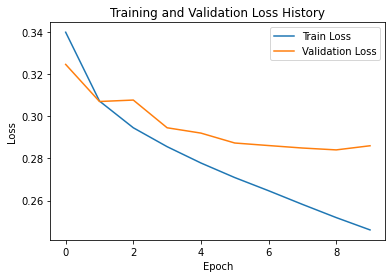

In [27]:
train_tfrecords = os.path.join(TFRECORD_PATH, 'train*')
val_tfrecords = os.path.join(TFRECORD_PATH, 'val*')
epochs = 10
batch_size = 16
num_heatmap = 16
learning_rate = 0.0007

best_model_file = simplebaseline_train(epochs, learning_rate, num_heatmap, batch_size, train_tfrecords, val_tfrecords)

## StackedHourGlass Loss Graph

Sorted Epochs: ['1', '2', '3', '4', '5', '6', '7', '8', '9']
Sorted Losses: ['1.4172', '1.3157', '1.2482', '1.2222', '1.1816', '1.1711', '1.1547', '1.1441', '1.1208']


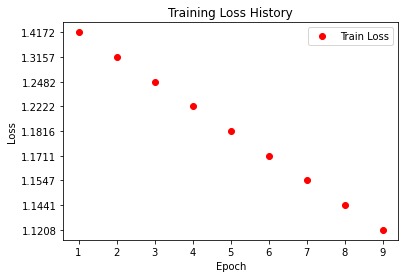

In [29]:
import re
WEIGHTS_PATH = './models/StackedHourGlass'

history = {
    "epoch":[],
    "train_loss":[]
}
pattern = r"model-epoch-(\d+)-loss-(\d+\.\d+).h5"

files = os.listdir(WEIGHTS_PATH)

for file in files:
    match = re.search(pattern, file)
    history["epoch"].append(match.group(1))
    history["train_loss"].append(match.group(2))
    
sorted_epochs = sorted(history["epoch"])
sorted_losses = [loss for _, loss in sorted(zip(history["epoch"], history["train_loss"]))]

print("Sorted Epochs:", sorted_epochs)
print("Sorted Losses:", sorted_losses)

plt.plot(sorted_epochs, sorted_losses, 'ro', label="Train Loss")
plt.title("Training Loss History")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.gca().invert_yaxis()
plt.legend()
plt.show()

## SimpleBaseLine Loss Graph
![img1](./asset/image4.png)

# 3. Inference

In [67]:
WEIGHTS_PATH = os.path.join(PROJECT_PATH, 'models', 'model-v0.0.1-epoch-2-loss-1.3072.h5')

model = StackedHourglassNetwork(IMAGE_SHAPE, 4, 1)
model.load_weights(WEIGHTS_PATH)

In [41]:
def find_max_coordinates(heatmaps):
    flatten_heatmaps = tf.reshape(heatmaps, (-1, 16))
    indices = tf.math.argmax(flatten_heatmaps, axis=0)
    y = tf.cast(indices / 64, dtype=tf.int64)
    x = indices - 64 * y
    return tf.stack([x, y], axis=1).numpy()

def extract_keypoints_from_heatmap(heatmaps):
    max_keypoints = find_max_coordinates(heatmaps)

    padded_heatmap = np.pad(heatmaps, [[1,1],[1,1],[0,0]], mode='constant')
    adjusted_keypoints = []
    for i, keypoint in enumerate(max_keypoints):
        max_y = keypoint[1]+1
        max_x = keypoint[0]+1
        
        patch = padded_heatmap[max_y-1:max_y+2, max_x-1:max_x+2, i]
        patch[1][1] = 0
        
        index = np.argmax(patch)
        
        next_y = index // 3
        next_x = index - next_y * 3
        delta_y = (next_y - 1) / 4
        delta_x = (next_x - 1) / 4
        
        adjusted_keypoint_x = keypoint[0] + delta_x
        adjusted_keypoint_y = keypoint[1] + delta_y
        adjusted_keypoints.append((adjusted_keypoint_x, adjusted_keypoint_y))
        
    adjusted_keypoints = np.clip(adjusted_keypoints, 0, 64)
    normalized_keypoints = adjusted_keypoints / 64
    return normalized_keypoints
def predict(model, image_path):
    encoded = tf.io.read_file(image_path)
    image = tf.io.decode_jpeg(encoded)
    inputs = tf.image.resize(image, (256, 256))
    inputs = tf.cast(inputs, tf.float32) / 127.5 - 1
    inputs = tf.expand_dims(inputs, 0)
    outputs = model(inputs, training=False)
    if type(outputs) != list:
        outputs = [outputs]
    heatmap = tf.squeeze(outputs[-1], axis=0).numpy()
    kp = extract_keypoints_from_heatmap(heatmap)
    return image, kp

In [42]:
def draw_keypoints_on_image(image, keypoints, index=None):
    fig,ax = plt.subplots(1)
    ax.imshow(image)
    joints = []
    for i, joint in enumerate(keypoints):
        joint_x = joint[0] * image.shape[1]
        joint_y = joint[1] * image.shape[0]
        if index is not None and index != i:
            continue
        plt.scatter(joint_x, joint_y, s=10, c='red', marker='o')
    plt.show()

def draw_skeleton_on_image(image, keypoints, index=None):
    fig,ax = plt.subplots(1)
    ax.imshow(image)
    joints = []
    for i, joint in enumerate(keypoints):
        joint_x = joint[0] * image.shape[1]
        joint_y = joint[1] * image.shape[0]
        joints.append((joint_x, joint_y))
    
    for bone in MPII_BONES:
        joint_1 = joints[bone[0]]
        joint_2 = joints[bone[1]]
        plt.plot([joint_1[0], joint_2[0]], [joint_1[1], joint_2[1]], linewidth=5, alpha=0.7)
    plt.show()

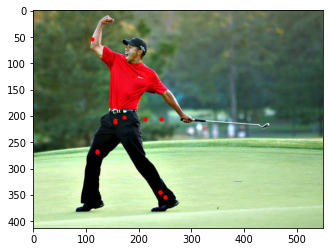

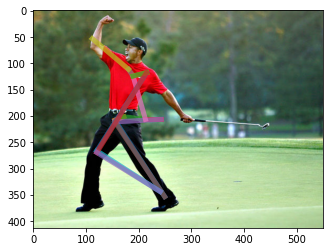

In [72]:
test_image = os.path.join(PROJECT_PATH, 'test_image.jpg')

image, keypoints = predict(model, test_image)
draw_keypoints_on_image(image, keypoints)
draw_skeleton_on_image(image, keypoints)

## 3.1 Stacked HourGlass Inference

======== Epoch: 1 | Loss: 1.4172 ========


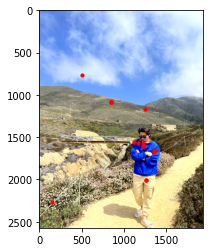

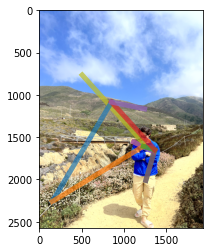

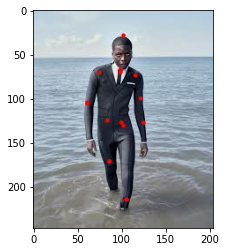

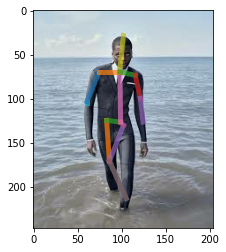

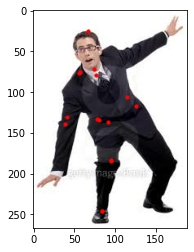

...

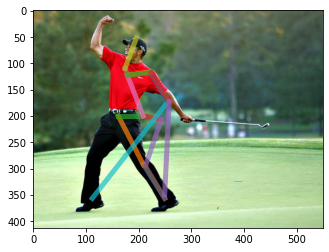

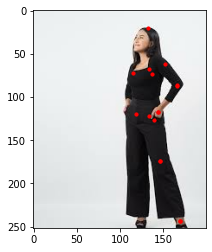

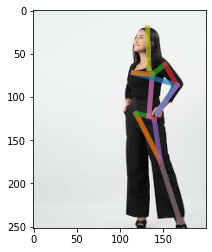

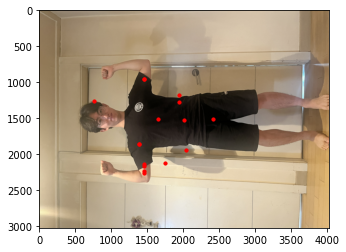

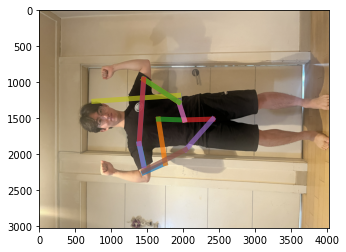

======== Epoch: 2 | Loss: 1.3157 ========


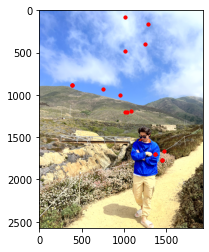

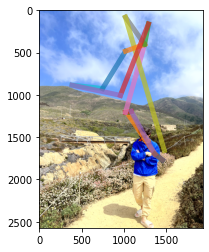

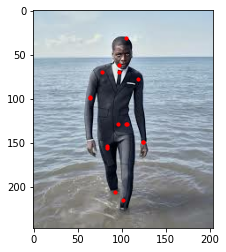

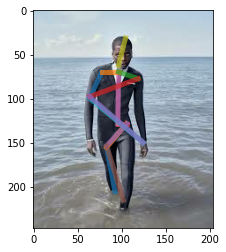

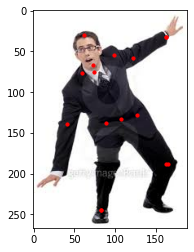

...

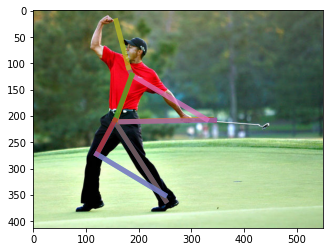

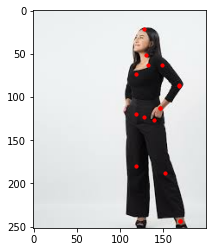

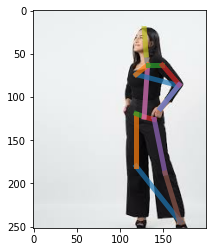

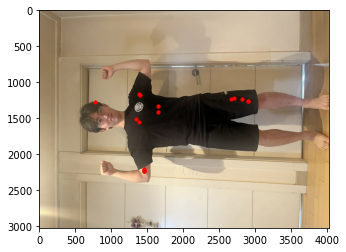

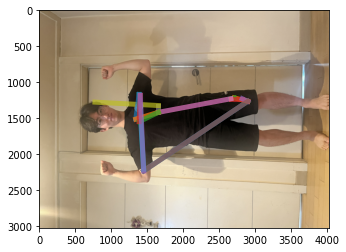

======== Epoch: 3 | Loss: 1.2482 ========


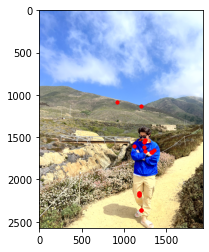

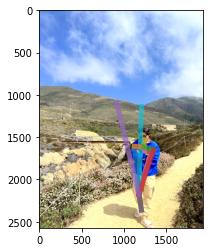

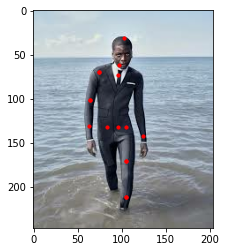

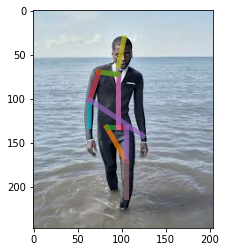

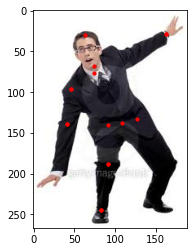

...

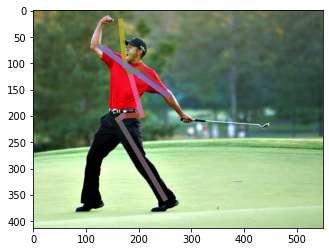

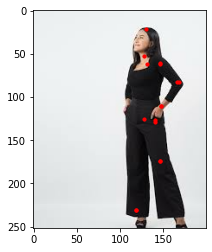

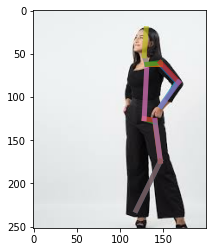

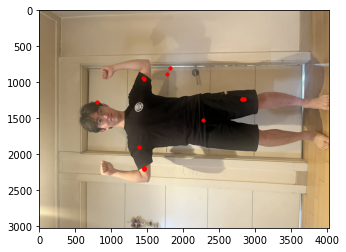

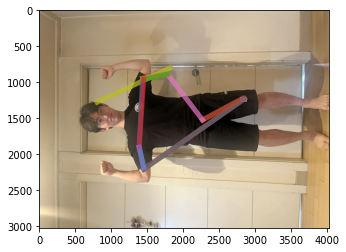

======== Epoch: 4 | Loss: 1.2222 ========


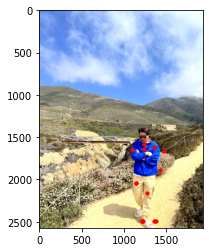

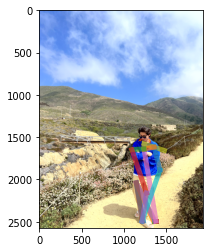

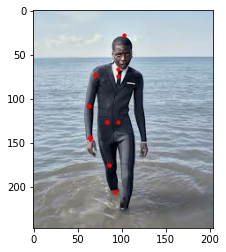

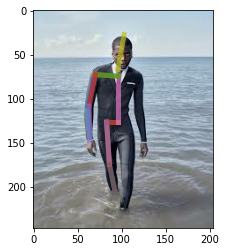

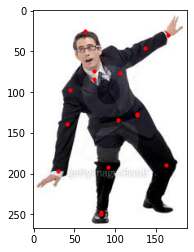

...

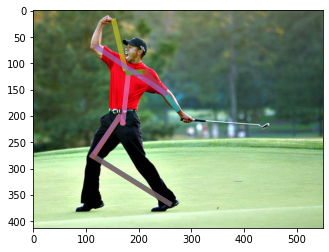

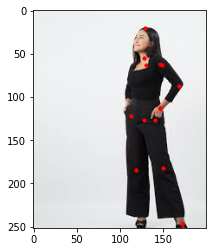

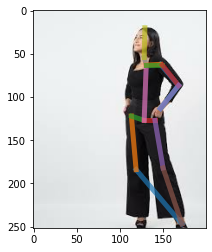

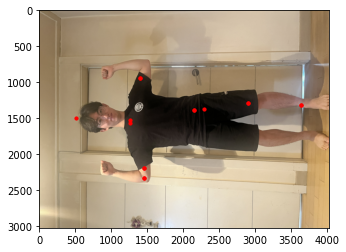

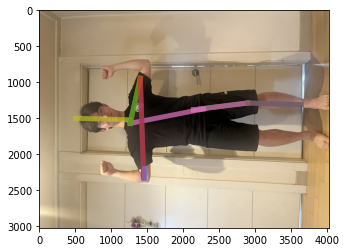

======== Epoch: 5 | Loss: 1.1816 ========


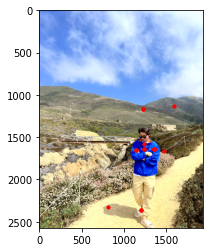

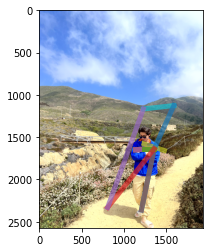

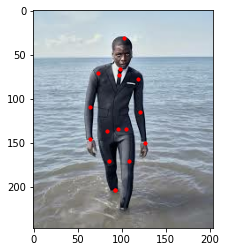

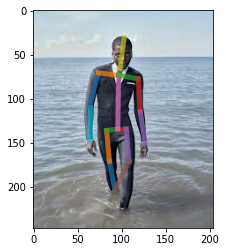

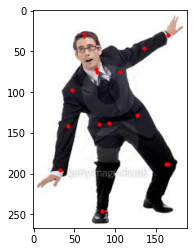

...

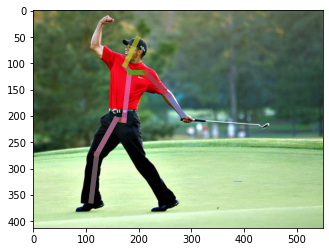

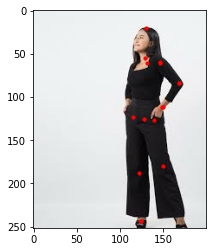

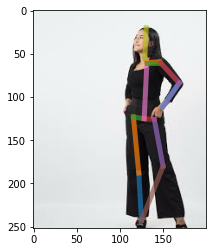

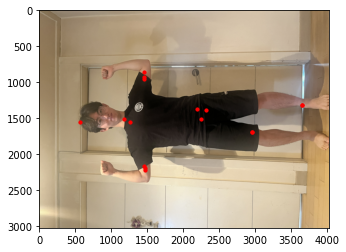

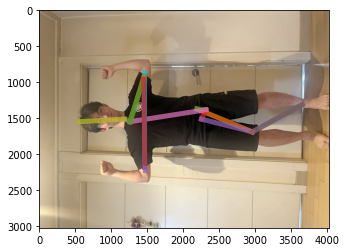

======== Epoch: 6 | Loss: 1.1711 ========


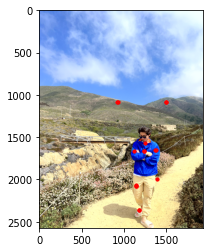

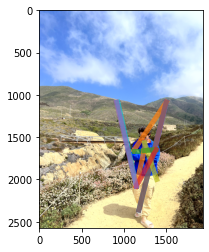

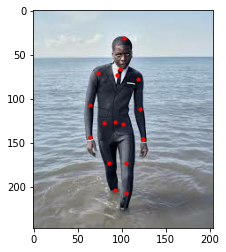

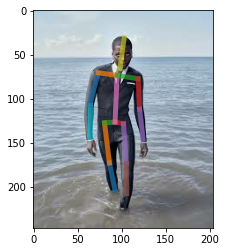

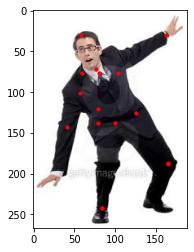

...

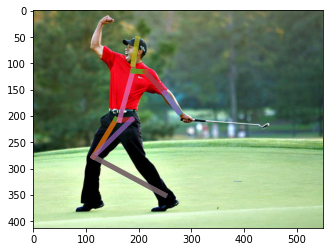

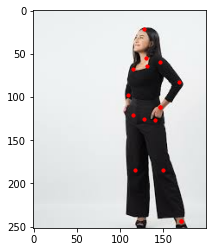

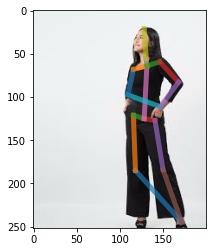

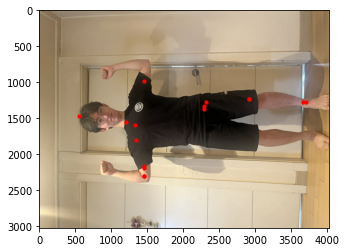

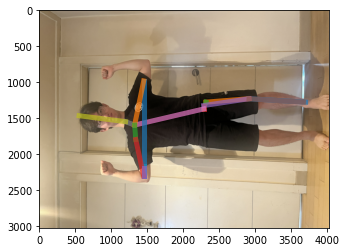

======== Epoch: 7 | Loss: 1.1547 ========


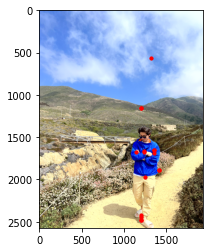

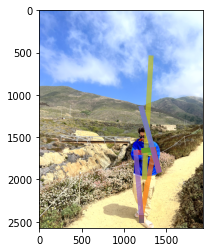

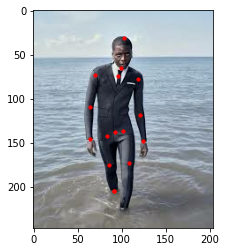

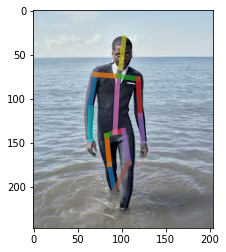

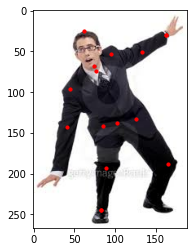

...

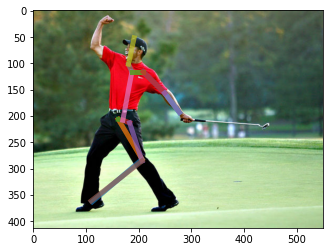

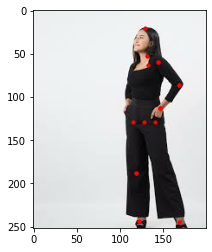

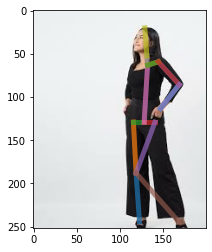

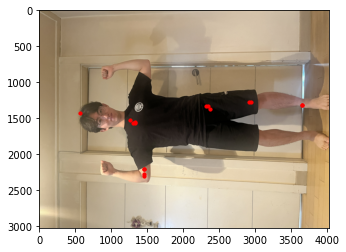

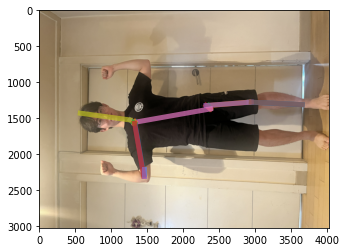

======== Epoch: 8 | Loss: 1.1441 ========


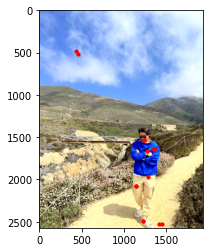

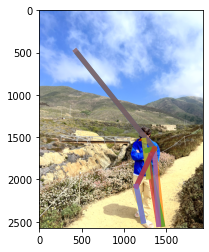

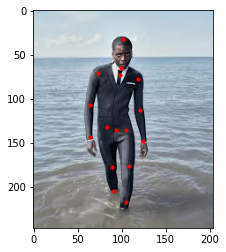

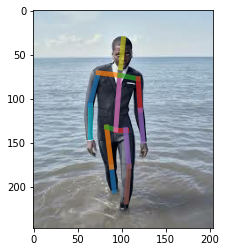

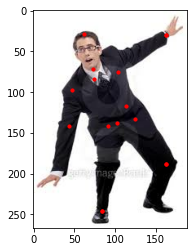

...

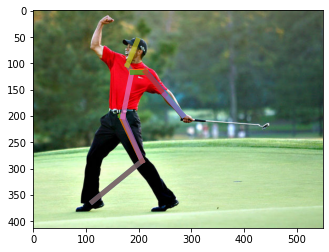

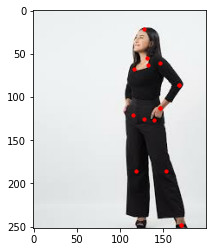

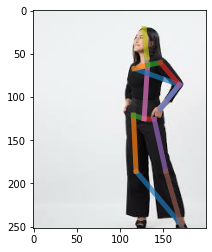

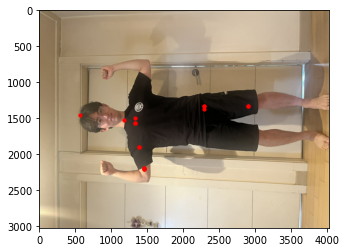

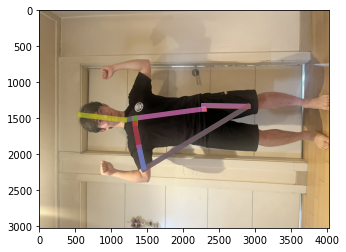

======== Epoch: 9 | Loss: 1.1208 ========


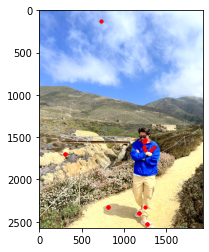

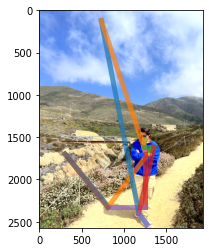

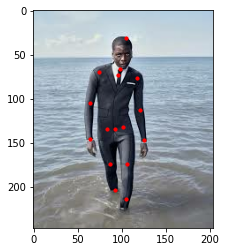

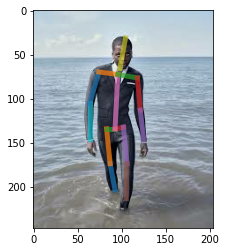

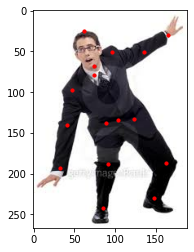

...

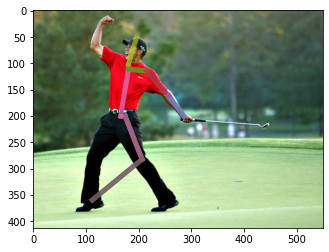

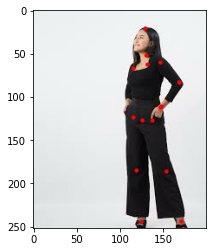

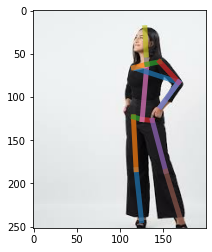

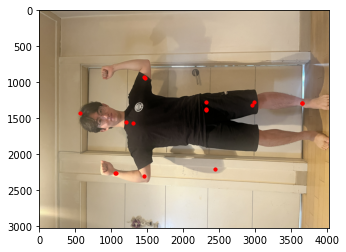

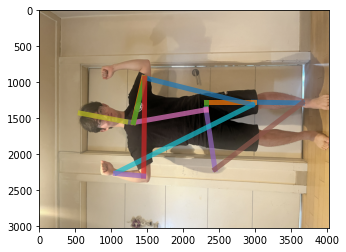

In [44]:
MODELS_PATH = './models/StackedHourGlass'
TEST_IMG_PATH = './asset/sample_image/'

images_list = [os.path.join(TEST_IMG_PATH, f) for f in os.listdir(TEST_IMG_PATH) if f.endswith(('.jpg', '.JPG', '.jpeg'))]

model_lists = os.listdir(MODELS_PATH)
pattern = r"model-epoch-(\d+)-loss-(\d+\.\d+).h5"

for i in range(1, 10):
    epoch = i
    default_path = "model-epoch-" + str(epoch)
    
    WEIGHTS_PATH = [os.path.join(MODELS_PATH, f) for f in model_lists if f.startswith(default_path)]
    if WEIGHTS_PATH == []:
        continue
    match = re.search(pattern, WEIGHTS_PATH[0])
    print(f"======== Epoch: {epoch} | Loss: {match.group(2)} ========")
    SHN_model = StackedHourglassNetwork((256,256,3), 4, 1)
    SHN_model.load_weights(WEIGHTS_PATH[0])
    
    for image in images_list:
        image, keypoints = predict(SHN_model, image)
        draw_keypoints_on_image(image, keypoints)
        draw_skeleton_on_image(image, keypoints)
    

## Simple Baseline Inference

======== Epoch: 1 | Loss: 0.3247 ========


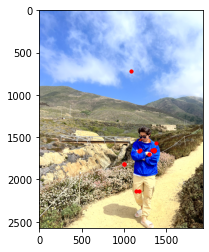

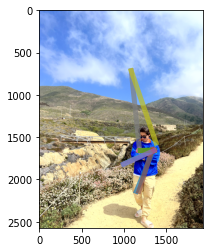

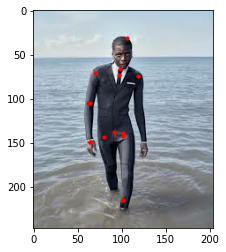

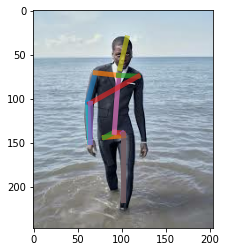

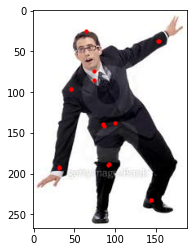

...

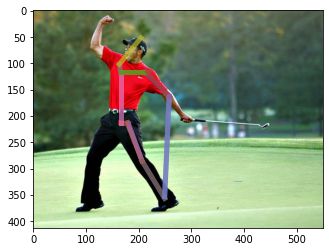

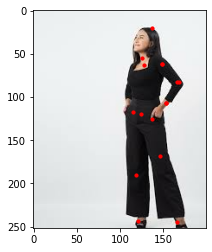

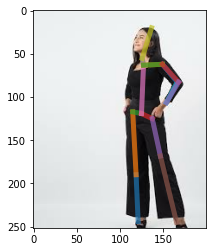

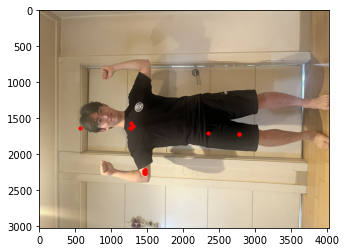

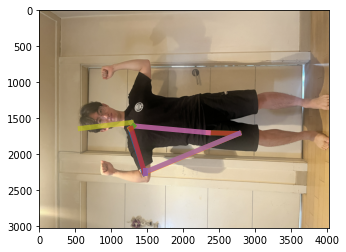

======== Epoch: 2 | Loss: 0.3071 ========


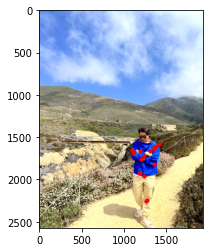

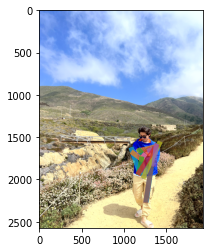

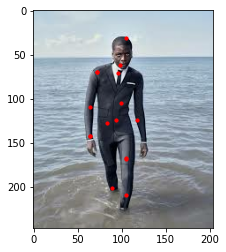

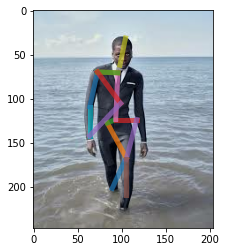

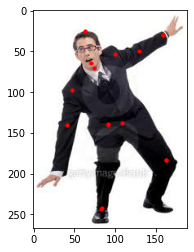

...

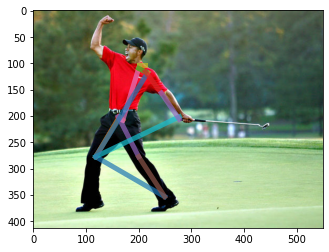

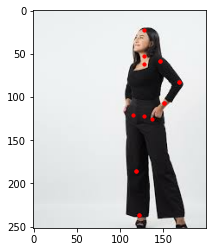

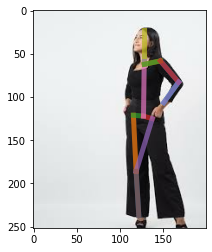

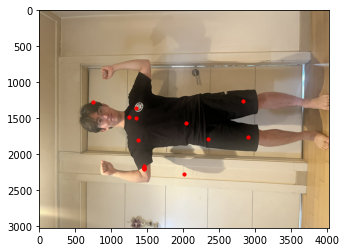

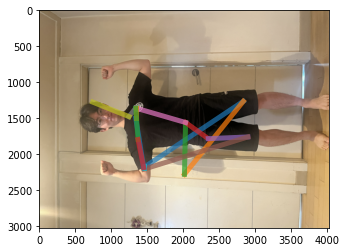

======== Epoch: 4 | Loss: 0.2946 ========


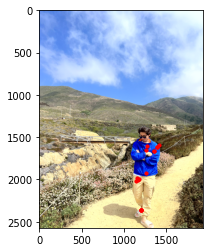

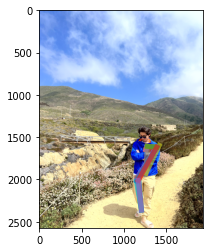

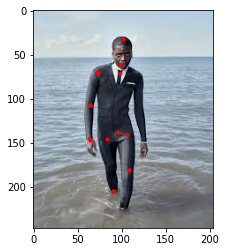

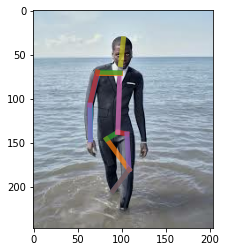

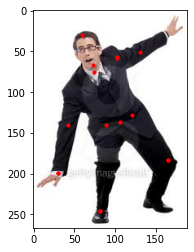

...

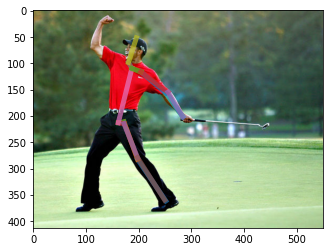

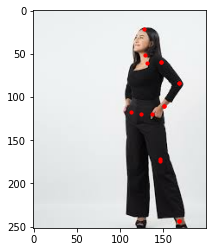

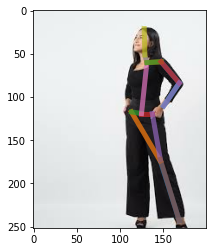

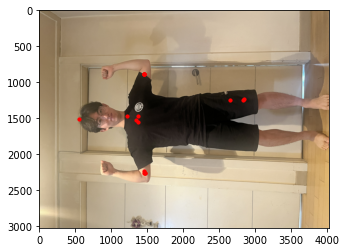

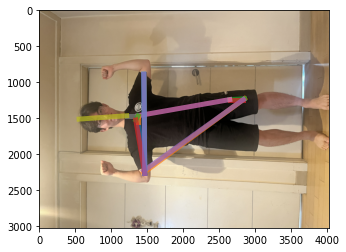

======== Epoch: 5 | Loss: 0.2920 ========


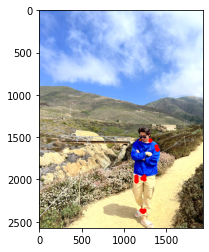

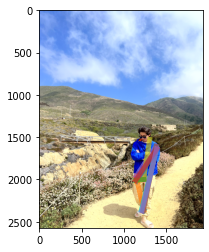

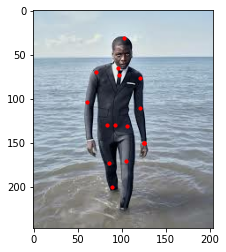

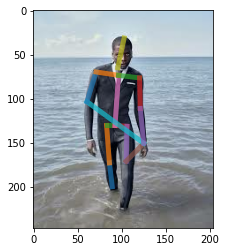

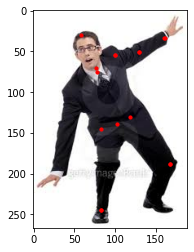

...

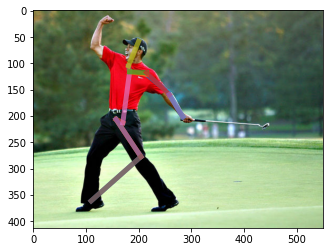

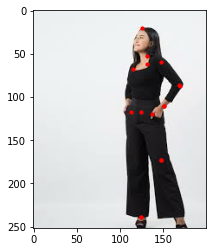

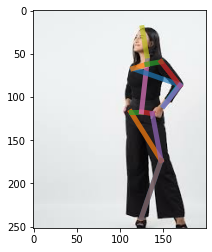

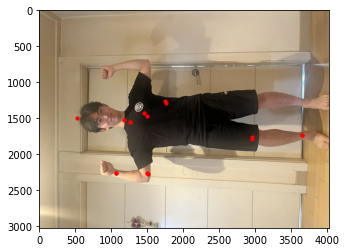

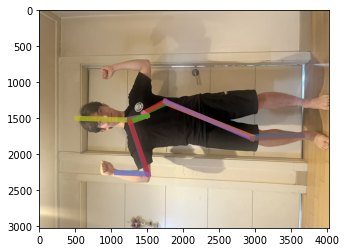

======== Epoch: 6 | Loss: 0.2873 ========


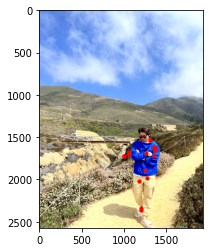

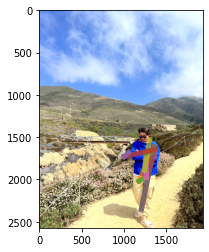

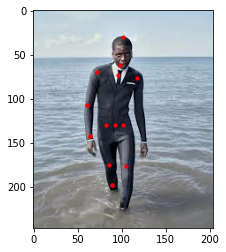

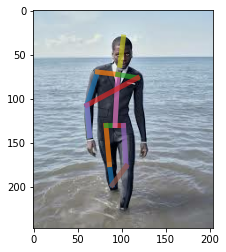

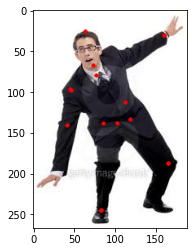

...

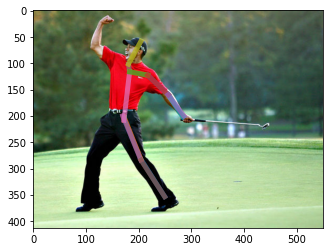

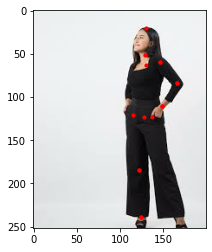

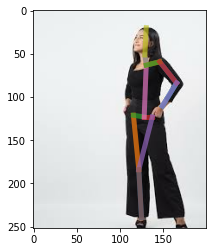

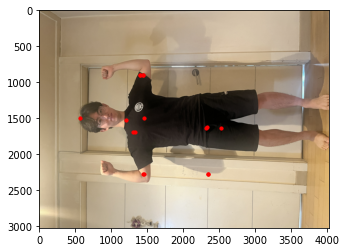

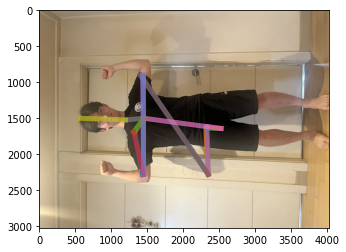

======== Epoch: 7 | Loss: 0.2861 ========


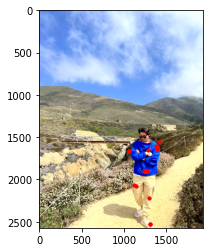

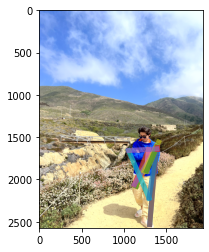

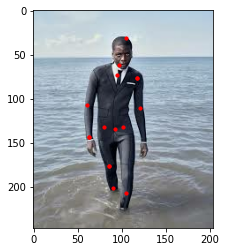

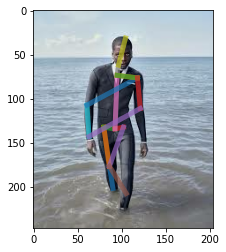

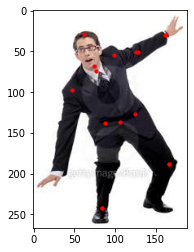

...

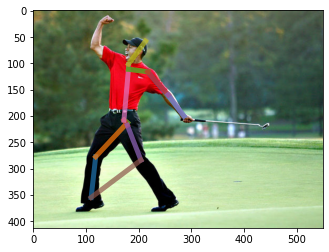

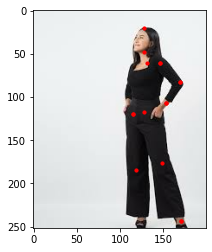

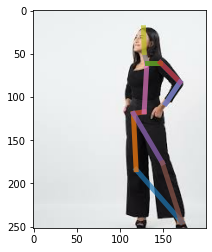

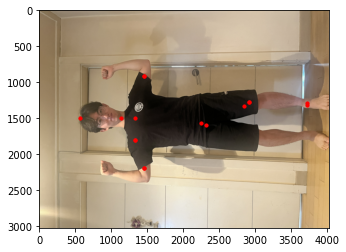

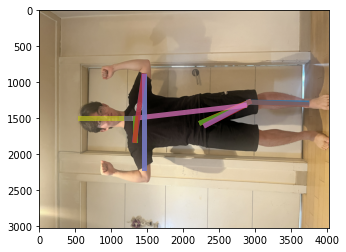

======== Epoch: 8 | Loss: 0.2849 ========


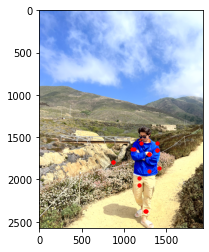

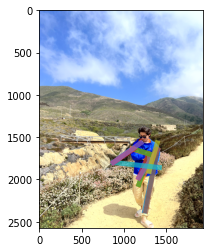

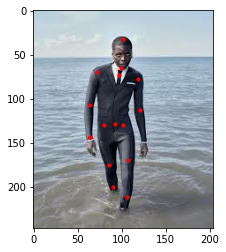

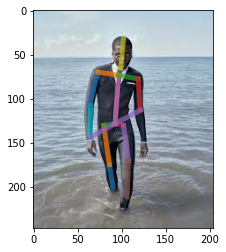

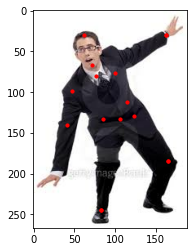

...

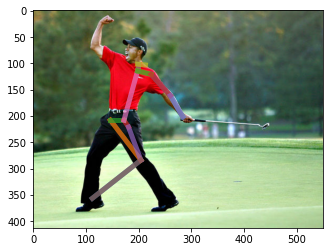

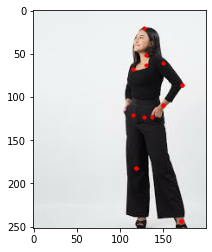

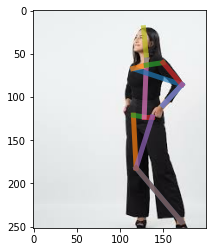

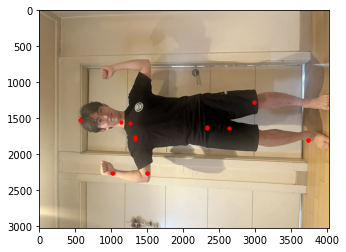

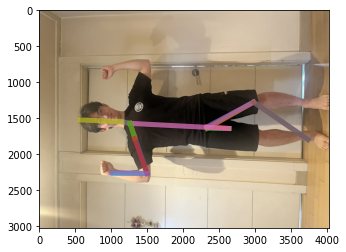

======== Epoch: 9 | Loss: 0.2841 ========


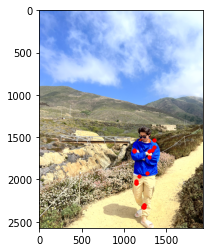

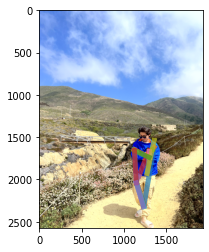

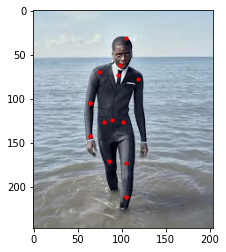

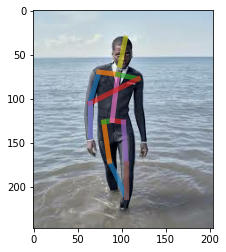

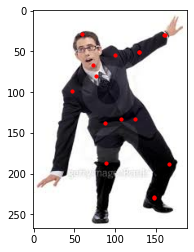

...

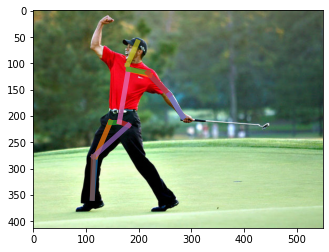

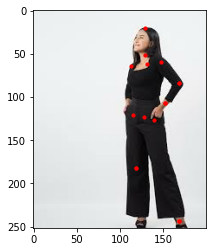

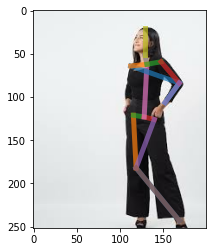

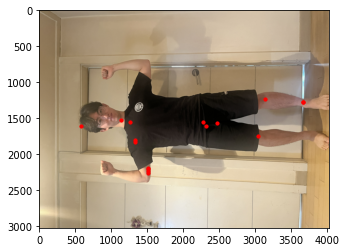

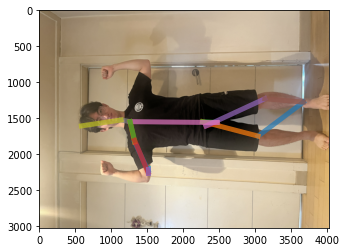

In [50]:
MODELS_PATH = './models/SimpleBaseline'
TEST_IMG_PATH = './asset/sample_image/'

images_list = [os.path.join(TEST_IMG_PATH, f) for f in os.listdir(TEST_IMG_PATH) if f.endswith(('.jpg', '.JPG', '.jpeg'))]

model_lists = os.listdir(MODELS_PATH)
pattern = r"model-epoch-(\d+)-loss-(\d+\.\d+).h5"

for i in range(1, 10):
    epoch = i
    default_path = "model-epoch-" + str(epoch)
    
    WEIGHTS_PATH = [os.path.join(MODELS_PATH, f) for f in model_lists if f.startswith(default_path)]
    if WEIGHTS_PATH == []:
        continue
    match = re.search(pattern, WEIGHTS_PATH[0])
    print(f"======== Epoch: {epoch} | Loss: {match.group(2)} ========")
    SB_model = SimpleBaseline((256,256,3), 16)
    SB_model.load_weights(WEIGHTS_PATH[0])
    
    for image in images_list:
        image, keypoints = predict(SB_model, image)
        draw_keypoints_on_image(image, keypoints)
        draw_skeleton_on_image(image, keypoints)
    

# 4. Wrap Up 
1. Model 간 epoch 시간 비교  
- HourGlass는 한 epoch당 20분이 소요된 반면 SimpleBaseline은 10분이 걸렸다.  
2. Model 간 Loss 비교
- 두 모델은 학습 초기 단계부터 2.5 이하의 Loss값을 기록하였다.  
- SimpleBaseline은 학습 초기 (epoch 1) 시점부터 Loss값이 현저하게 낮다.  
3. 정성평가  
- 추론 단계에서 epoch1 부터 정성평가를 실시한 결과 학습 초기단계부터 정답과 유사한 결과를 도출한다.  
- Epoch 6 시점부터는 어느 하나의 모델이 더 좋다고 판단하기 어렵다.  
- 두 모델 모두 **신발이 없거나, 무릎의 옆쪽이거나, 사람이 멀리 있거나** 와 같은 feature를 잘 탐지하지 못했다.
4. 정리
- 같은 결과를 내는 모델이 있을 시 모델을 경량화 하는 것이 더 좋다.  
- 양질의 데이터를 모델에게 제공해야한다. ( 예를 들어 사람을 옆에서 찍은 이미지, 신발을 안신고 있는 사람 등등)  

## 4.1 Encoder - Decoder
1. StackedHourGlass가 나오기 전 Human Pose는 Encoder-Decoder 관계가 아니였다.  
-> 전체 그림에서 특정 feature를 찾아내는 detector였거나, key point를 회귀하는 방식으로 관절을 찾아내려고 하였다.  
  
2. Data Labeling에서 아이디어를 얻어 Human pose의 상당한 정확도를 이끌어냈다.  
Label에 관절의 가우시안 분포를 적용하여 모델이 전체 그림에서 해당 key point를 회귀하는 방식이 소개되었다.    
  
#### 자 여기서 문제가 있다
#### Convolution을 통한 key point 회귀는 우리가 우리 두 눈으로 인간의 몸을 탐지하는 과정을 대변할 수 있을까?
- ======= 기존의 과정 =========  
    - 모델이 여러 개의 convolution layer로 데이터 분포를 회귀하는 과정을 생각해보자.  
    - 이미지가 input으로 들어가는 Convolution layer ->  우리 몸의 일부를 탐지  (손바닥, 발, 눈)   
    - 우리 몸의 일부를 탐지한 결과에 들어가는 Convolution layer -> 우리 몸의 한 파트를 탐지  (팔, 다리, 얼굴)  
    - 우리 몸의 한 파트를 탐지한 결과에 들어가는 Convolution layer -> 우리 몸의 큰 파트를 탐지 (상체, 하체)  
    - 우리 몸의 큰 파트를 탐지한 결과에 들어가는 Convolution layer -> 우리 몸 전체를 탐지  
    
#### 우리의 눈은 몸 전체를 본다. 부분이 아니라!!
- **한 번의 시선으로 특징점을 찾아내는 것**을 모델로 구현해야한다.   
    => 그것이 바로 HourGlass 이자 Encoder Decoder 구조  

- Encoder:
학습을 통해 Encoder는 image상에 **여러 관절의 feature을 추출**해 내야한다.  
- Decoder:
학습을 통해 Decoder는 실제 이미지에서 **관절에 대응하는 위치들에 추출된 정보들을 위치 시켜**야한다.  


## 4.2 Difference with Hourglass and SimpleBaseline
- HourGlass model
    - 수 많은 Encoder Decoder 구조를 사용해 여러 feature들을 추출하고 복원한다. 
    - 왜 여러 개의 hourglass가 필요할까?
    - 

# 5. Retrospective
#### =============================회고============================================
#### 유능한 딥러닝 엔지니어의 필수 덕목은 한정된 리소스 (GPU, 시간)을 잘 활용하는 것
1. Package issue
 - 모델이 무거울 경우 package를 무작정 올리면 안된다. (import time). 

2. Preprocessing & Idea 
- 유능한 딥러닝 엔지니어의 필수 덕목은 **데이터 전처리**이다.  
    -> 사람의 관절 파트를 가우시안 분포 형태로 데이터화 한다는 아이디어 자체가 human pose의 **key stone** 이다.  
    
3. Data pipline & Train Strategy & Team work
- **협업 시 어떻게 대용량 데이터를 관리할 것인가?**는 매우매우매우매우 중요한 문제이다.  


#### TO Do List
[X] HourGlass 이해하기  
[X] HRNet 구성하기 (based on simplebaseline)  
[X] HRNet inference    
[X] Train class 이해하기